# Create full dataset

In [24]:
from dataset_generation import gen_dataset_original
dataset = gen_dataset_original()
np.save("data/pepe.npy", dataset)

# Training.

In [25]:
import numpy as np
dataset = np.load("data/pepe.npy")
print(dataset.shape[0])

3408


In [10]:
import numpy as np
# Constant: output with a * a * 3 images.
a = 5
channel = 3
latent_dim = 16 # 2 keccak result

In [2]:
# example of training the discriminator model on real and random cifar10 images
from numpy import expand_dims
from numpy import ones
from numpy import zeros
from numpy.random import rand
from numpy.random import randint
from tensorflow.keras.datasets.cifar10 import load_data
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import ReLU
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)


def define_discriminator(in_shape=(a, a, channel)):
    model = Sequential()
    model.add(Conv2D(128, (2, 2), input_shape=in_shape, activation="relu"))
    model.add(Conv2D(64, (2,2), padding='same', activation="relu"))
    model.add(Flatten())
    model.add(Dropout(0.4))
    model.add(Dense(1, activation='sigmoid'))
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model
    
def generate_real_samples(dataset, n_samples):
    ix = randint(0, dataset.shape[0], n_samples)
    X = dataset[ix]
    y = ones((n_samples, 1))
    return X, y

def generate_fake_samples(n_samples):
    X = rand(a * a * 3 * n_samples)
    X = -1 + X * 2
    X = X.reshape((n_samples, a, a, 3))
    y = zeros((n_samples, 1))
    return X, y

def train_discriminator(model, dataset, n_iter=20, n_batch=128):
    half_batch = int(n_batch / 2)
    for i in range(n_iter):
        X_real, y_real = generate_real_samples(dataset, half_batch)
        _, real_acc = model.train_on_batch(X_real, y_real)
        X_fake, y_fake = generate_fake_samples(half_batch)
        _, fake_acc = model.train_on_batch(X_fake, y_fake)
        print('>%d real=%.0f%% fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

2023-02-24 21:23:38.894866: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-24 21:23:39.448954: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :/home/pgi/anaconda3/lib/:/home/pgi/anaconda3/envs/GAN/lib/
2023-02-24 21:23:39.449027: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :/home/pgi/anaconda3/lib/:/home/pgi/anaconda3/envs/GAN/lib/
2023-02-24

In [3]:
# example of defining and using the generator model
from numpy import zeros
from numpy.random import randn
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Reshape, Conv2D, Conv2DTranspose, BatchNormalization
import matplotlib.pyplot as plt
def define_generator(latent_dim):
    model = Sequential()
    model.add(Dense(2*2*24, use_bias=False, input_shape=(latent_dim,), activation='relu'))
    model.add(BatchNormalization())
    model.add(Reshape((2,2,24)))
    model.add(Conv2DTranspose(12, (2, 2), strides=(2, 2), padding="same", use_bias=False, activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2DTranspose(channel, (2, 2), use_bias=False, activation='sigmoid'))
    return model

def generate_latent_points(latent_dim, n_samples):
    np.random.seed(0)
    x_input = randn(latent_dim * n_samples)
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input
def generate_fake_samples(g_model, latent_dim, n_samples):
    x_input = generate_latent_points(latent_dim, n_samples)
    X = g_model.predict(x_input, verbose=0)
    y = zeros((n_samples, 1))
    return X, y

In [4]:
define_generator(latent_dim).summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 96)                1536      
                                                                 
 batch_normalization (BatchN  (None, 96)               384       
 ormalization)                                                   
                                                                 
 reshape (Reshape)           (None, 2, 2, 24)          0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 4, 4, 12)         1152      
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 4, 4, 12)         48        
 hNormalization)                                                 
                                                        

2023-02-24 21:23:40.806133: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-24 21:23:40.806361: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-24 21:23:40.806507: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-24 21:23:40.806810: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-24 21:23:40.807060: I tensorflow/compiler/xla/stream_executo

In [5]:
from numpy import asarray
from matplotlib import pyplot

def define_gan(g_model, d_model):
    d_model.trainable = False
    model = Sequential()
    model.add(g_model)
    model.add(d_model)
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model
def save_plot(examples, epoch, n=7):
    for i in range(n * n):
        plt.subplot(n, n, 1 + i)
        plt.axis('off')
        plt.imshow(examples[i].astype("float64"))
    plt.title("%03d" % (epoch + 1))
    filename = 'output/generated_plot_e%06d.png' % (epoch+1)
    plt.savefig(filename)
    plt.close()
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=150):
    X_real, y_real = generate_real_samples(dataset, n_samples)
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    print('%03d>Accuracy real: %.0f%%, fake: %.0f%%' % (epoch, acc_real*100, acc_fake*100))
    save_plot(x_fake, epoch)
    filename = 'output/generator_model_%04d.h5' % (epoch+1)
    g_model.save(filename)
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=200, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)
    for i in range(n_epochs):
        for j in range(bat_per_epo):
            X_real, y_real = generate_real_samples(dataset, half_batch)
            d_loss1, _ = d_model.train_on_batch(X_real, y_real)
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            X_gan = generate_latent_points(latent_dim, n_batch)
            y_gan = ones((n_batch, 1))
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            if j == 0:
                pass
                #print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' % (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
            if (i+1) % 100 == 0 and j == 0:
                summarize_performance(i, g_model, d_model, dataset, latent_dim)
                plt.figure()
                vector = asarray([[0.75 for _ in range(latent_dim)]])
                X = g_model.predict(vector)[0]
                plt.axis('off')
                plt.imshow(X.astype("float64"), cmap="gray")
                plt.show()

In [6]:
d_model = define_discriminator()
g_model = define_generator(latent_dim)
gan_model = define_gan(g_model, d_model) 

In [7]:
%load_ext autoreload
%autoreload 2

In [13]:
from dataset_generation import gen_dataset, plot_image
dataset = gen_dataset()

4005


099>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 14ms/step


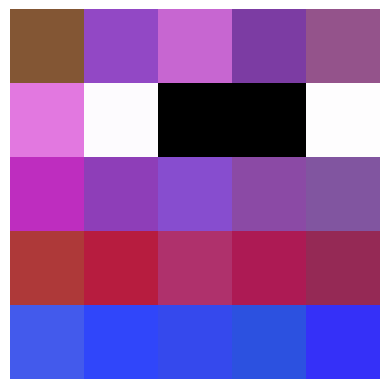

199>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 17ms/step


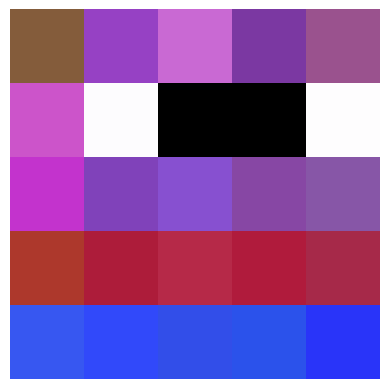

299>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 13ms/step


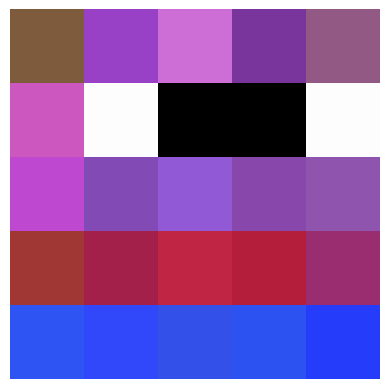

399>Accuracy real: 96%, fake: 100%
1/1 [==============================] - 0s 16ms/step


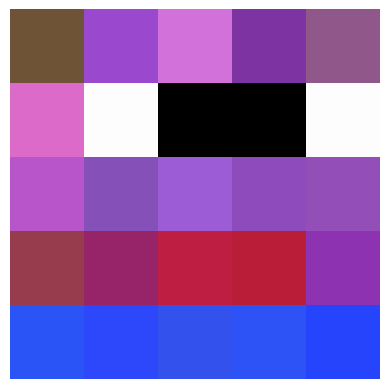

499>Accuracy real: 96%, fake: 100%
1/1 [==============================] - 0s 18ms/step


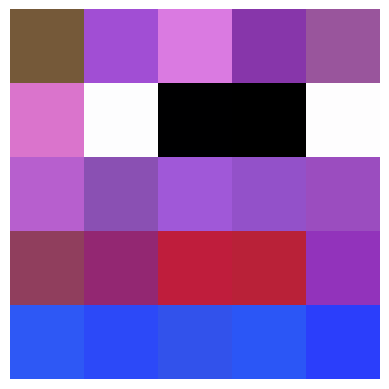

599>Accuracy real: 96%, fake: 100%
1/1 [==============================] - 0s 17ms/step


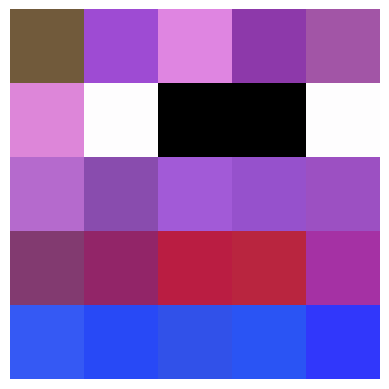

699>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 15ms/step


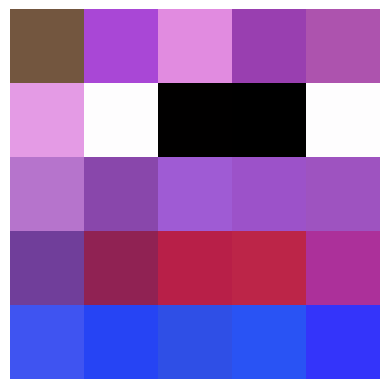

799>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 16ms/step


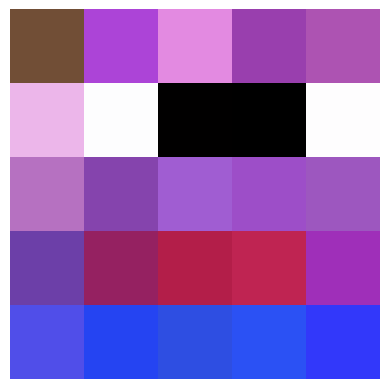

899>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 16ms/step


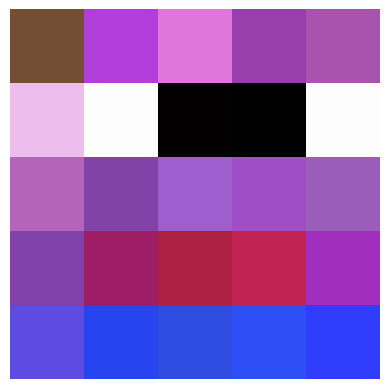

999>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 16ms/step


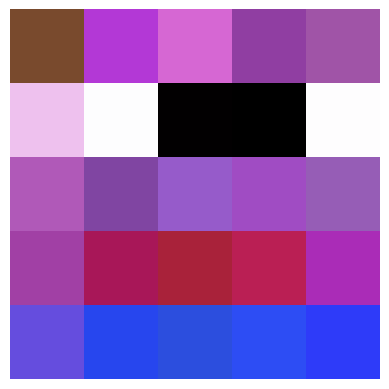

1099>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 16ms/step


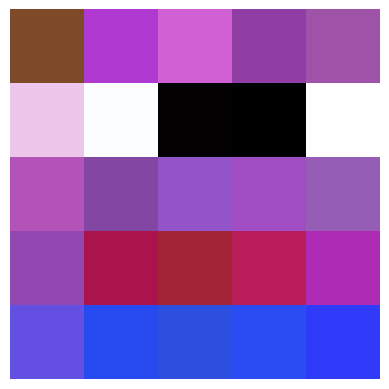

1199>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 13ms/step


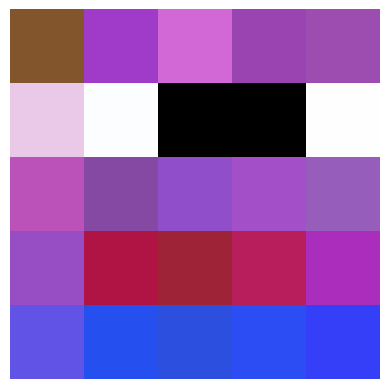

1299>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 15ms/step


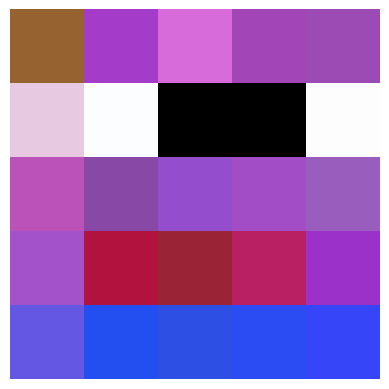

1399>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 14ms/step


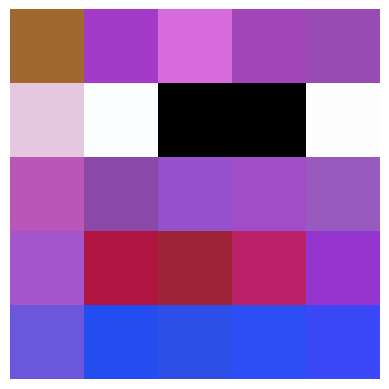

1499>Accuracy real: 95%, fake: 100%
1/1 [==============================] - 0s 15ms/step


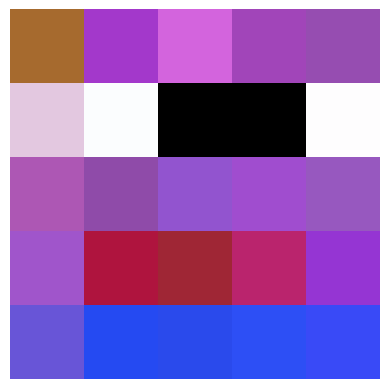

1599>Accuracy real: 96%, fake: 100%
1/1 [==============================] - 0s 16ms/step


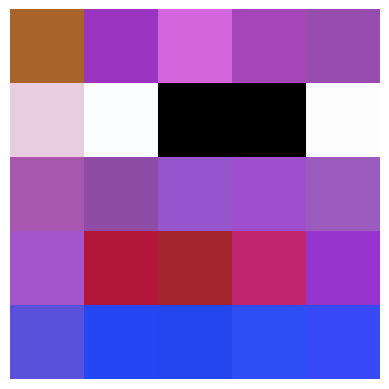

1699>Accuracy real: 96%, fake: 100%
1/1 [==============================] - 0s 16ms/step


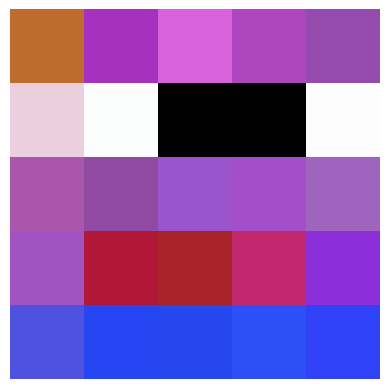

1799>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


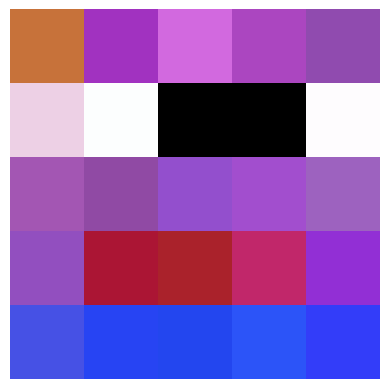

1899>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


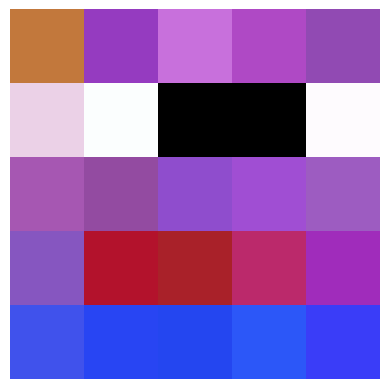

1999>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


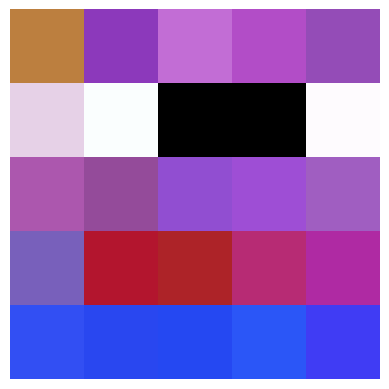

2099>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 17ms/step


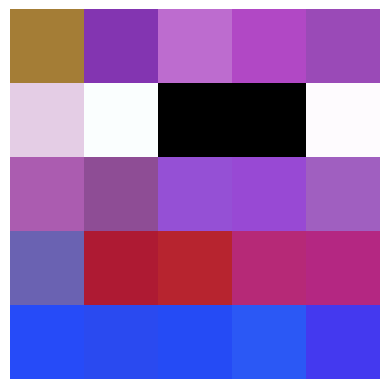

2199>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


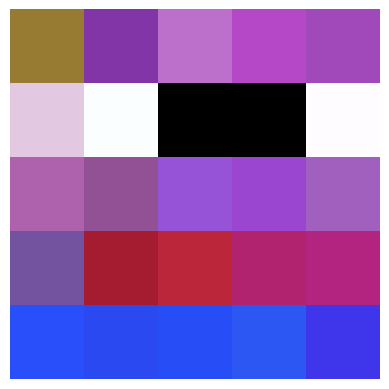

2299>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 15ms/step


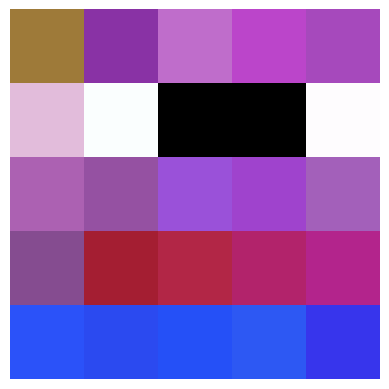

2399>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


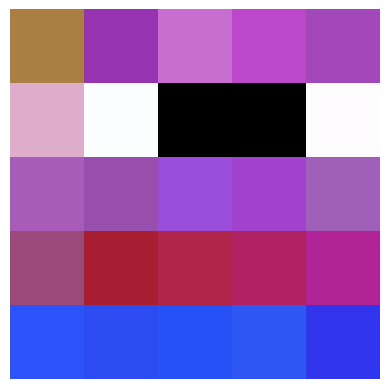

2499>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


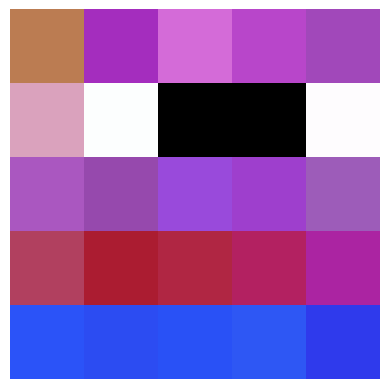

2599>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 17ms/step


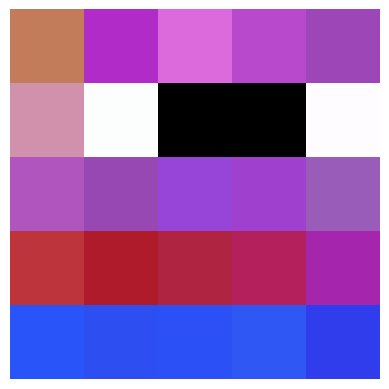

2699>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


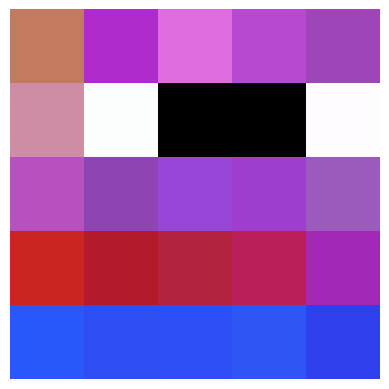

2799>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


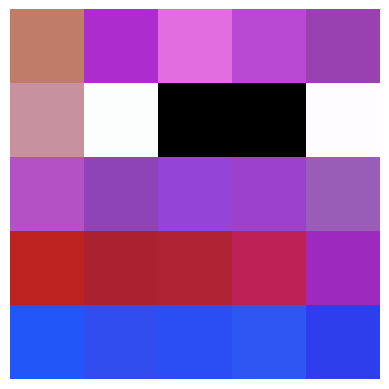

2899>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


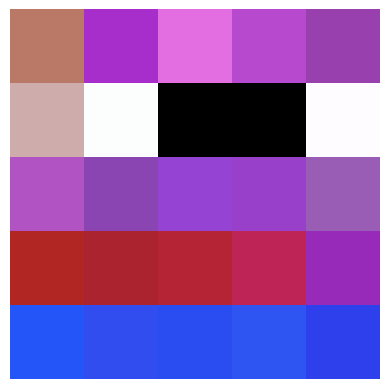

2999>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


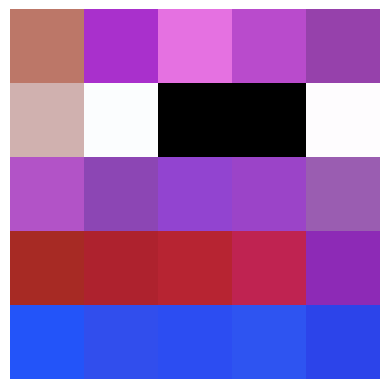

3099>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 15ms/step


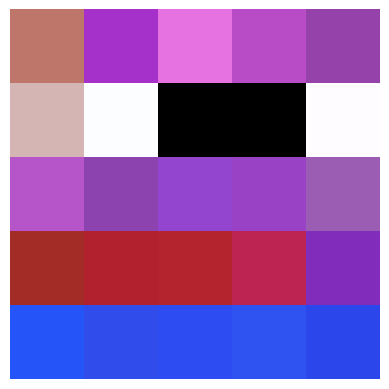

3199>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


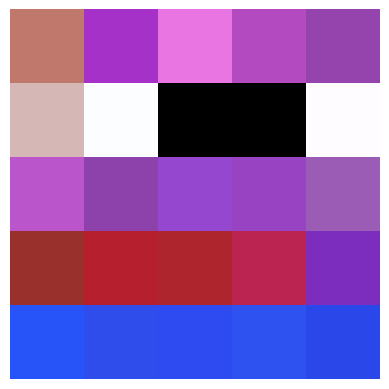

3299>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 14ms/step


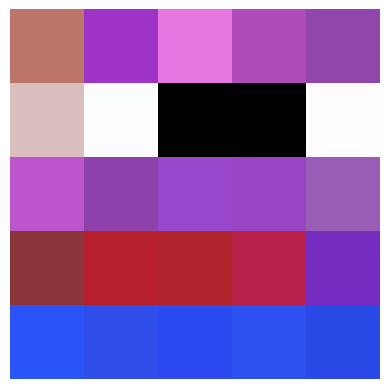

3399>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


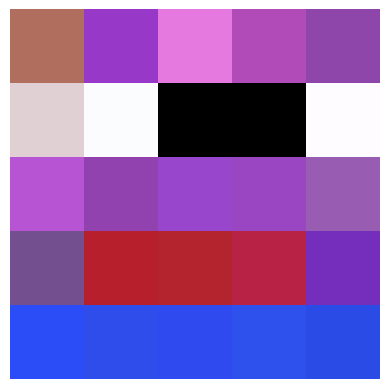

3499>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


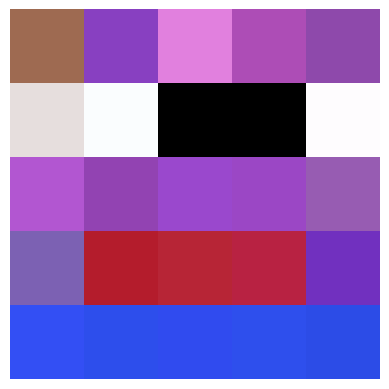

3599>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


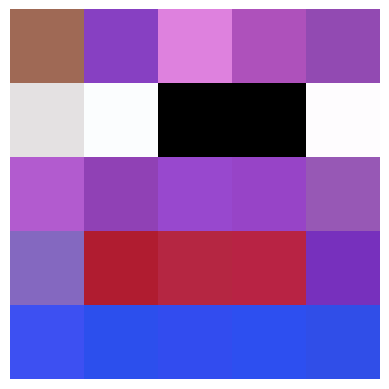

3699>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


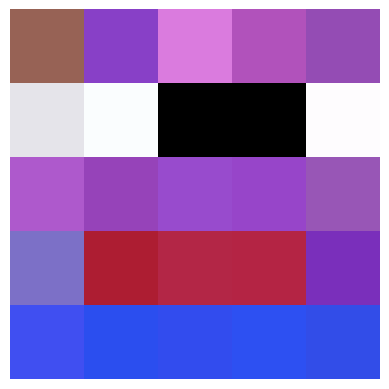

3799>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


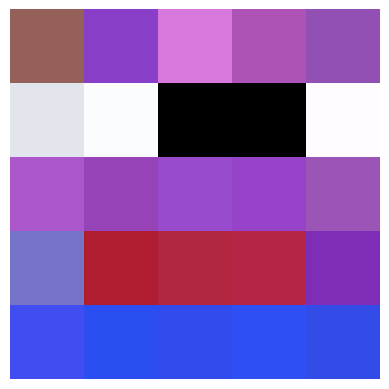

3899>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 15ms/step


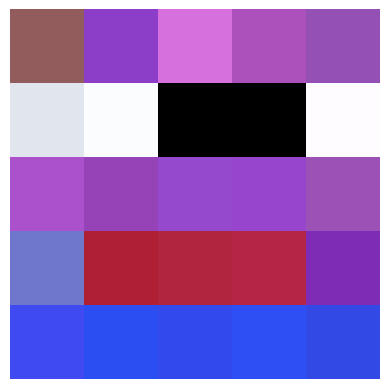

3999>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


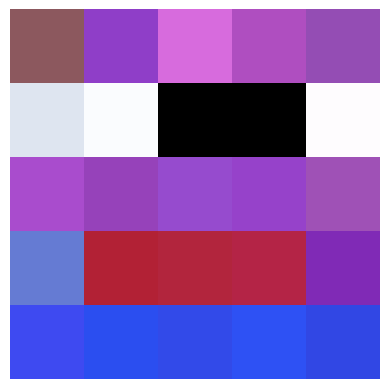

4099>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


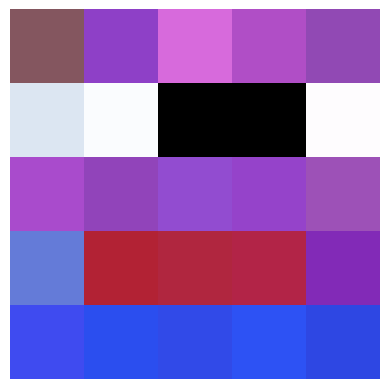

4199>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


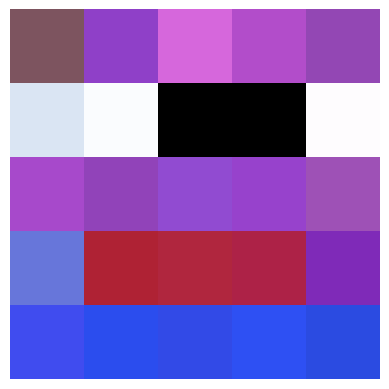

4299>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


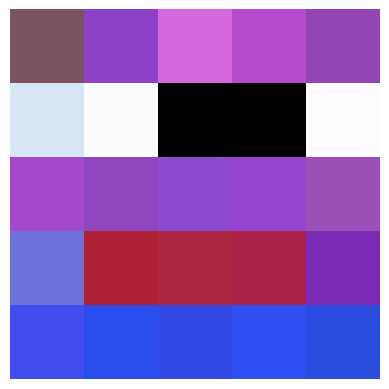

4399>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 17ms/step


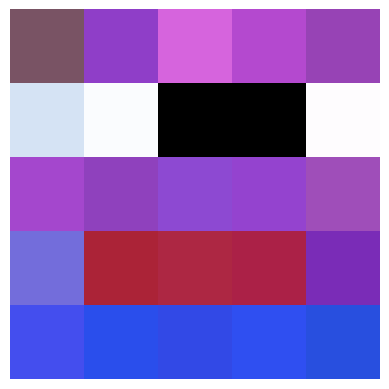

4499>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 16ms/step


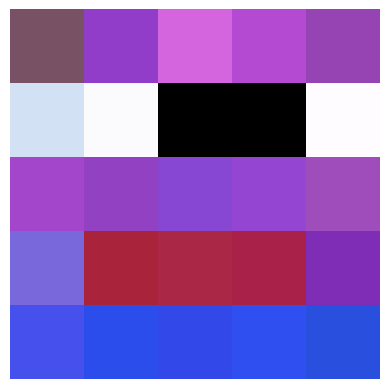

4599>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 15ms/step


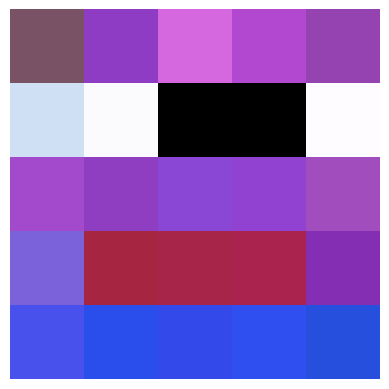

4699>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 17ms/step


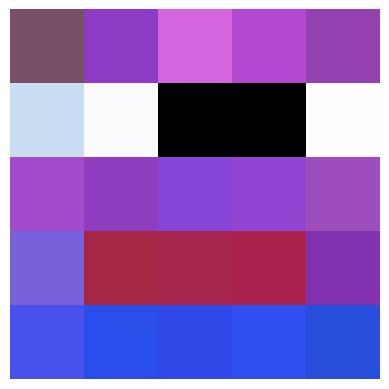

4799>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 17ms/step


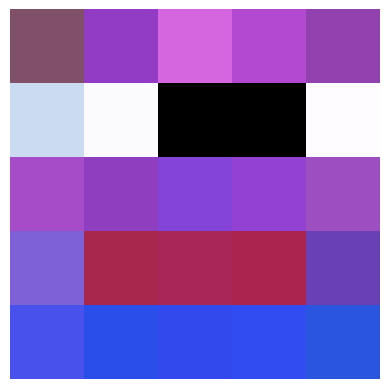

4899>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


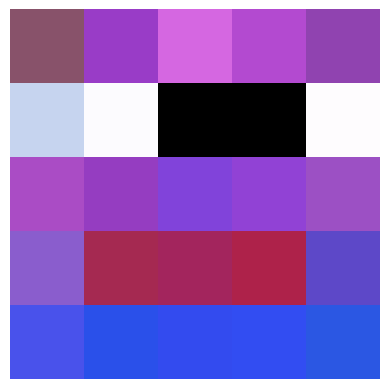

4999>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


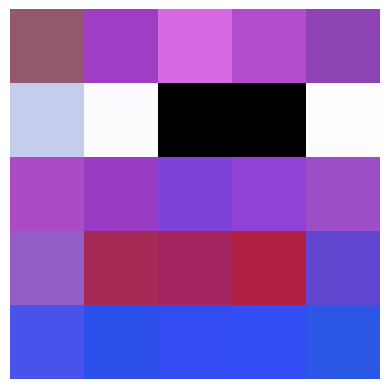

5099>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


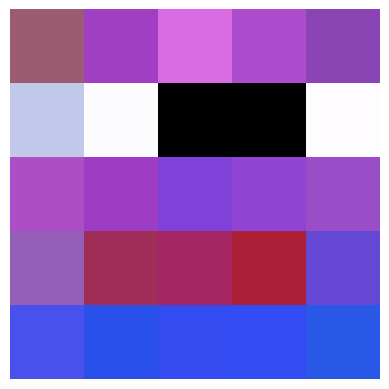

5199>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


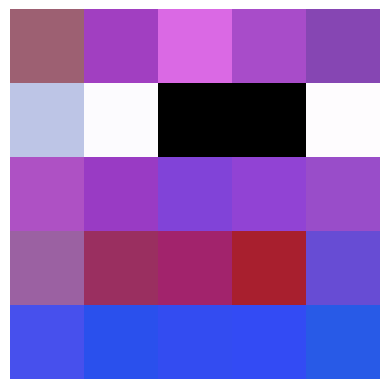

5299>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


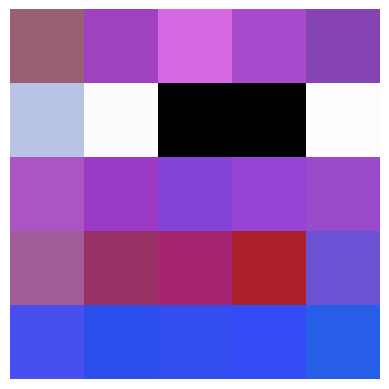

5399>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 13ms/step


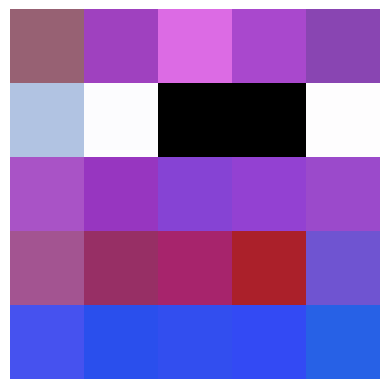

5499>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 16ms/step


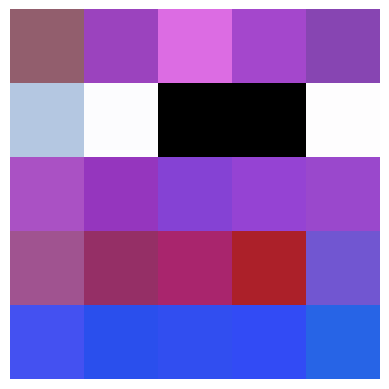

5599>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 15ms/step


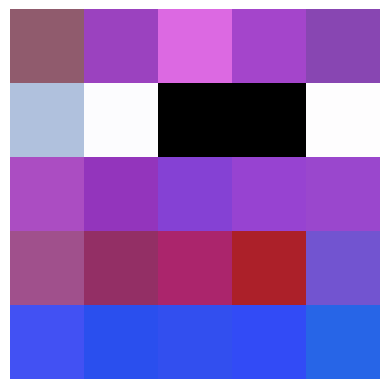

5699>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 15ms/step


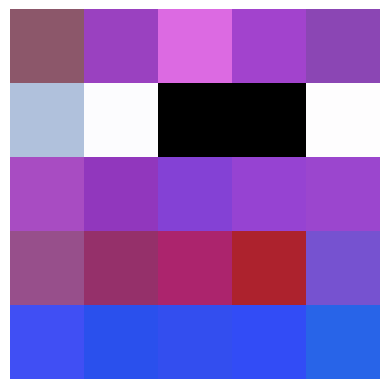

5799>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 16ms/step


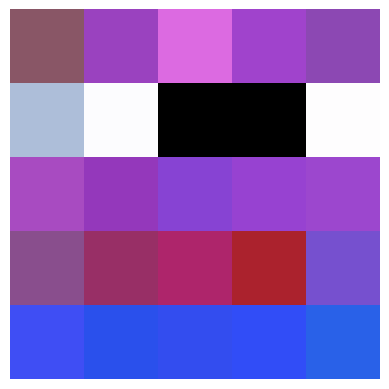

5899>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 16ms/step


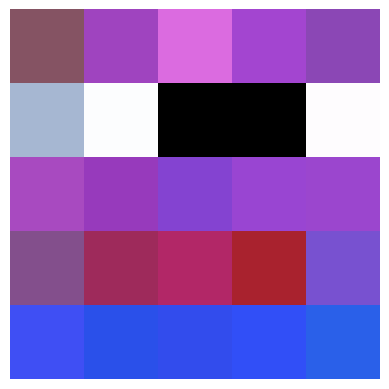

5999>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 16ms/step


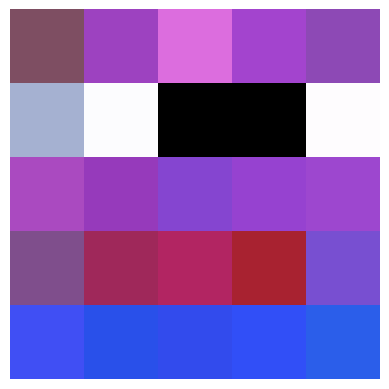

6099>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 17ms/step


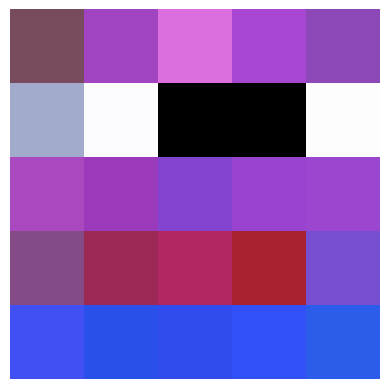

6199>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 17ms/step


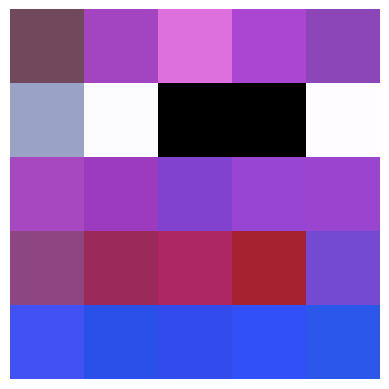

6299>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 14ms/step


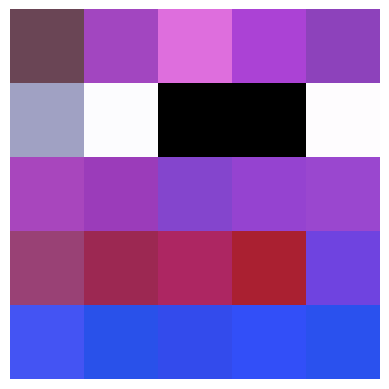

6399>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 14ms/step


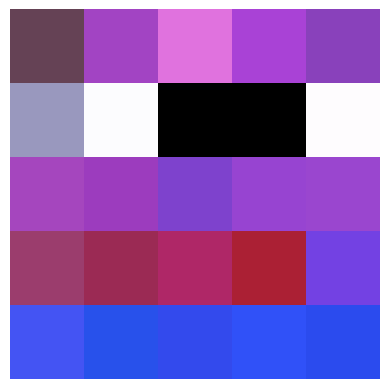

6499>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 14ms/step


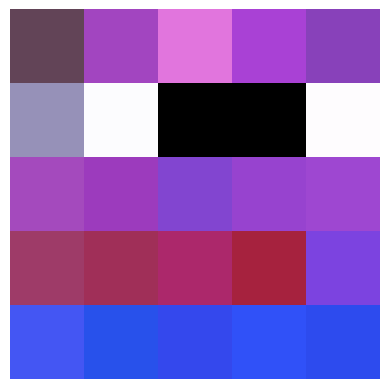

6599>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 14ms/step


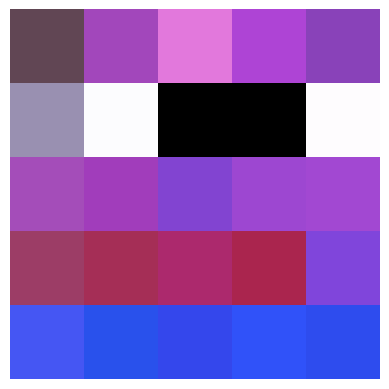

6699>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 14ms/step


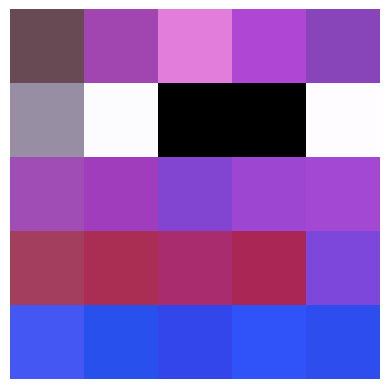

6799>Accuracy real: 98%, fake: 100%
1/1 [==============================] - 0s 14ms/step


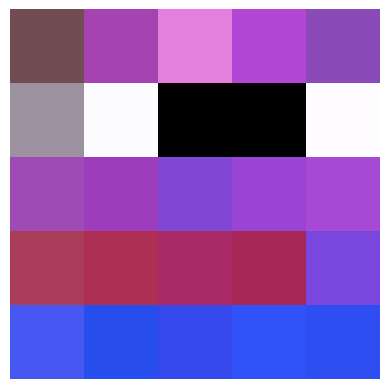

6899>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 14ms/step


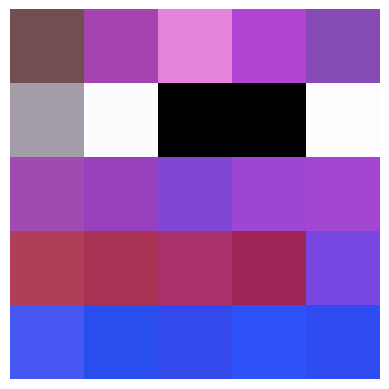

6999>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


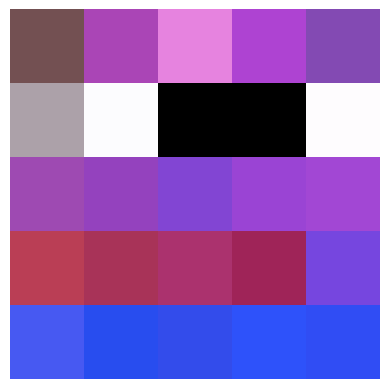

7099>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 17ms/step


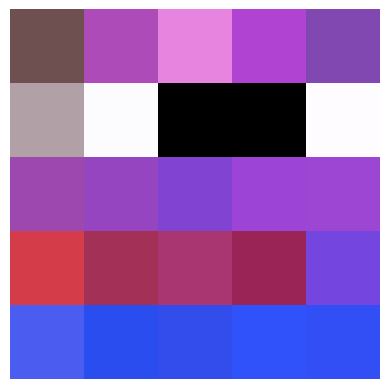

7199>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 17ms/step


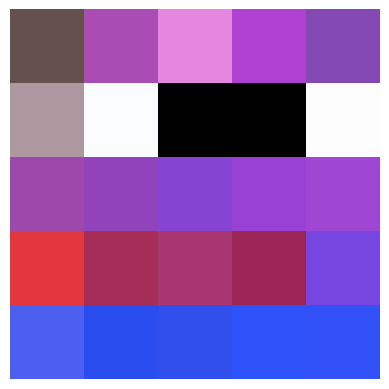

7299>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 21ms/step


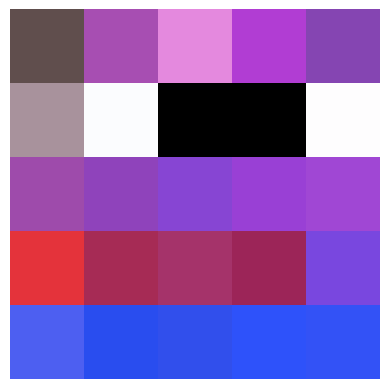

7399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


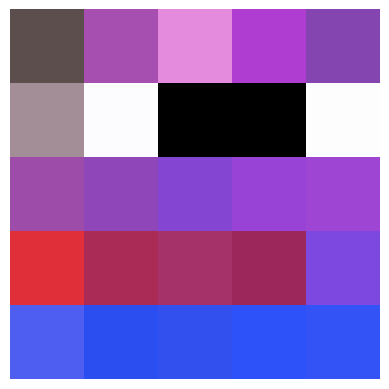

7499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


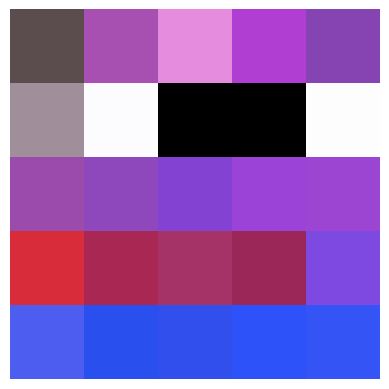

7599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


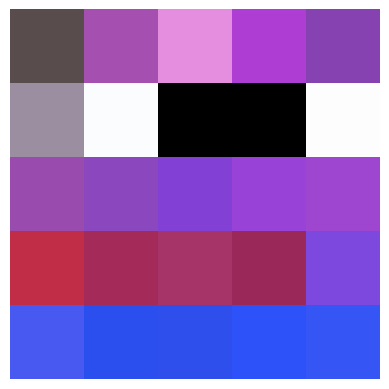

7699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


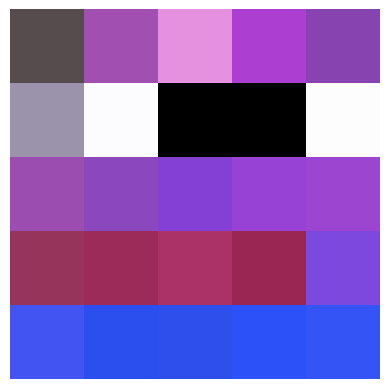

7799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


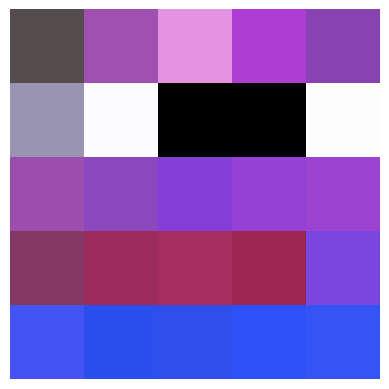

7899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


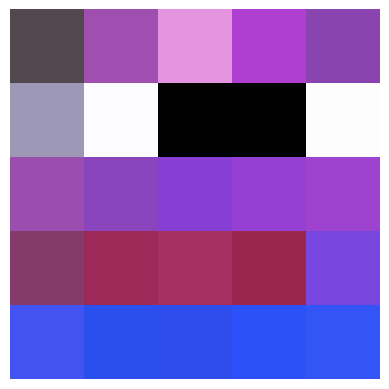

7999>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


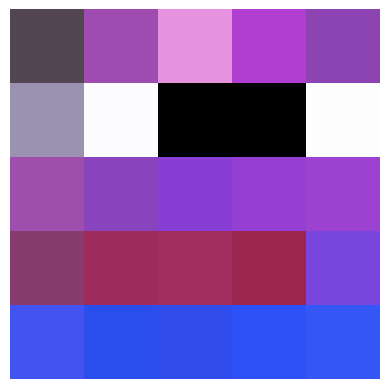

8099>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


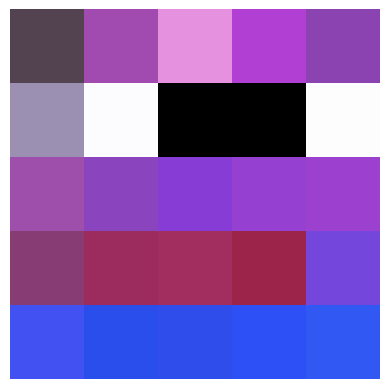

8199>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


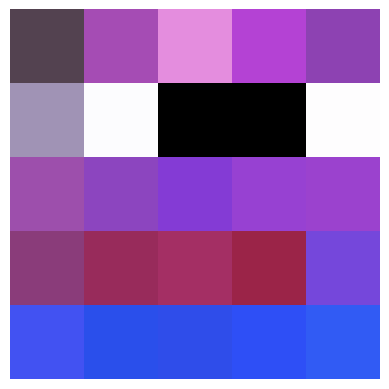

8299>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


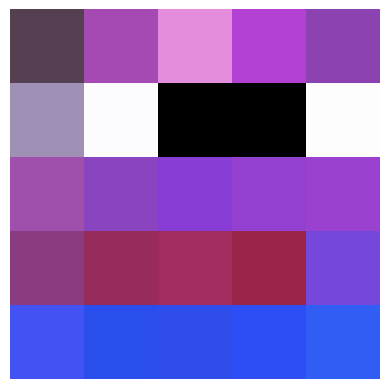

8399>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 14ms/step


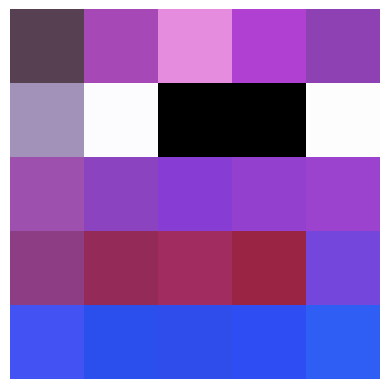

8499>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


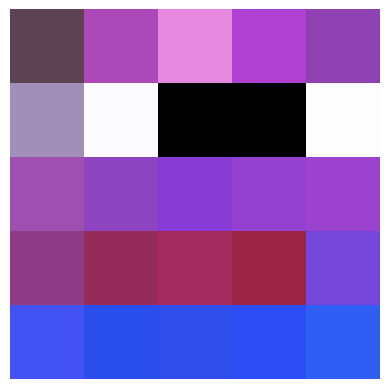

8599>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


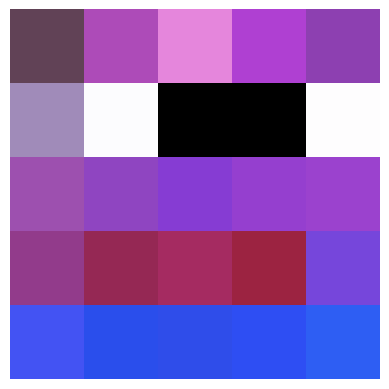

8699>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


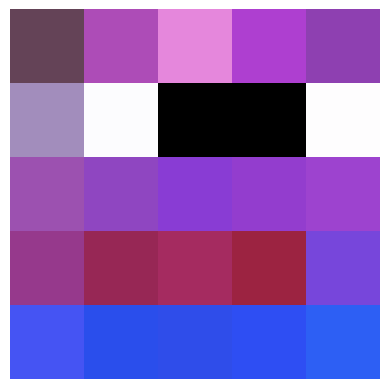

8799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


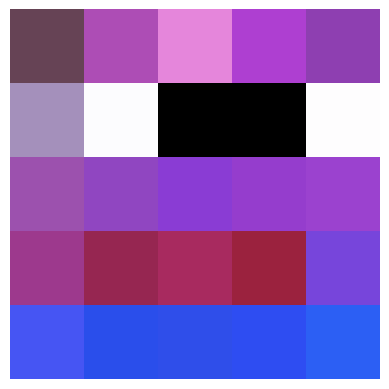

8899>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 16ms/step


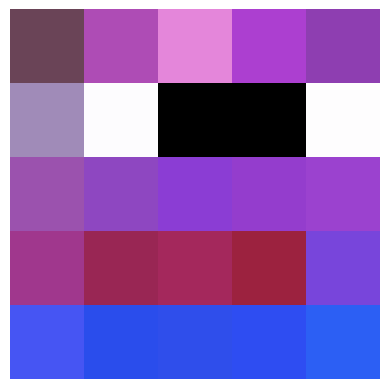

8999>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 16ms/step


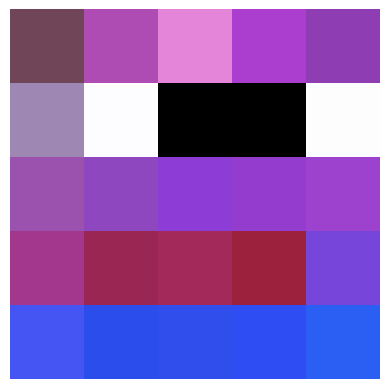

9099>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 16ms/step


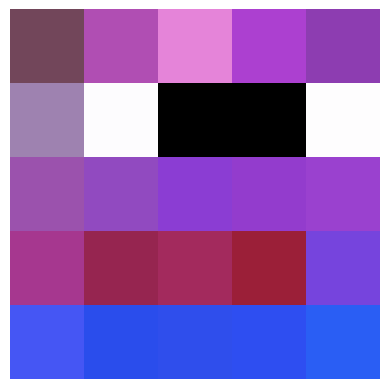

9199>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 16ms/step


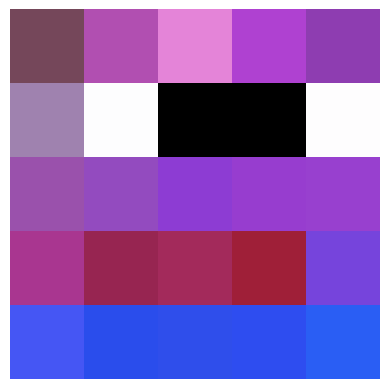

9299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


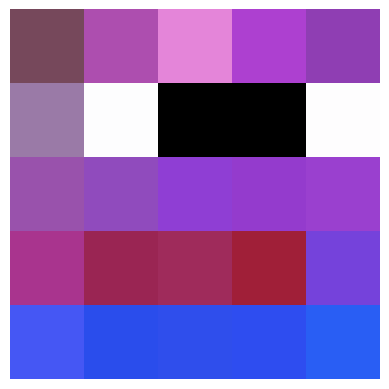

9399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


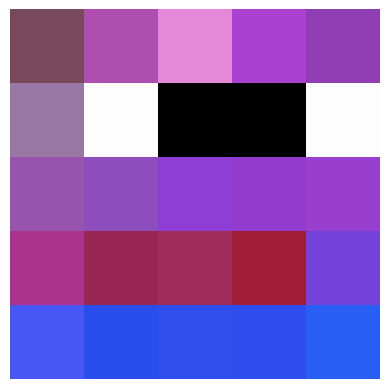

9499>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 17ms/step


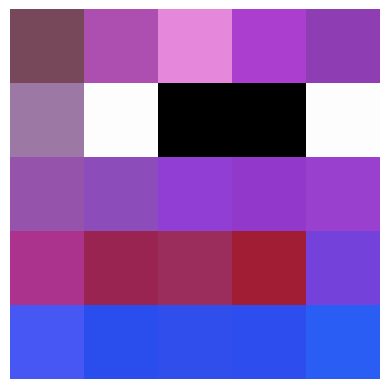

9599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


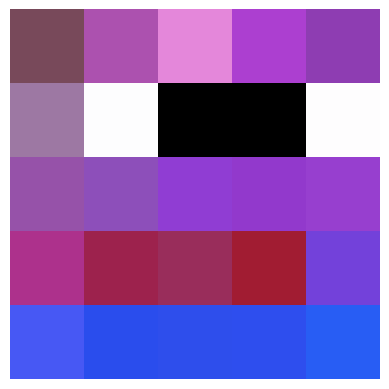

9699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


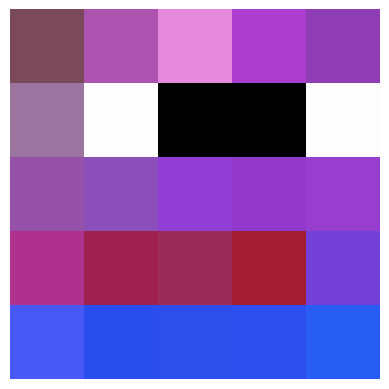

9799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


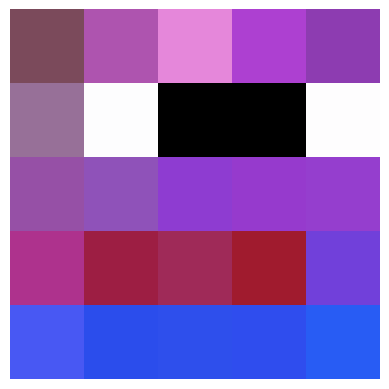

9899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


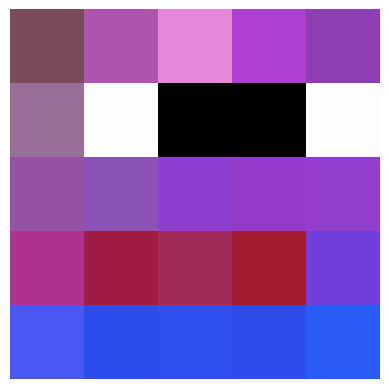

9999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


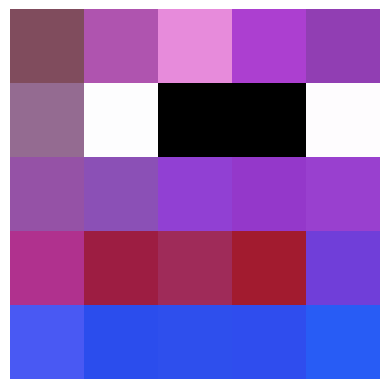

10099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


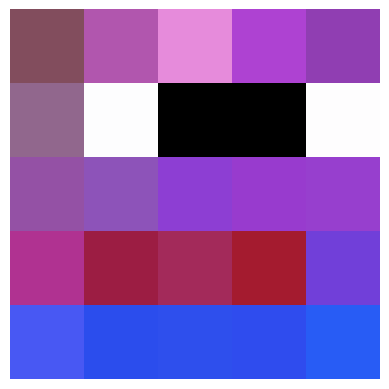

10199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


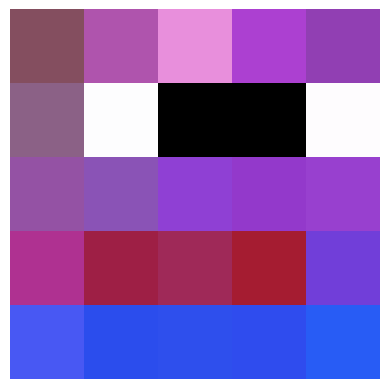

10299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


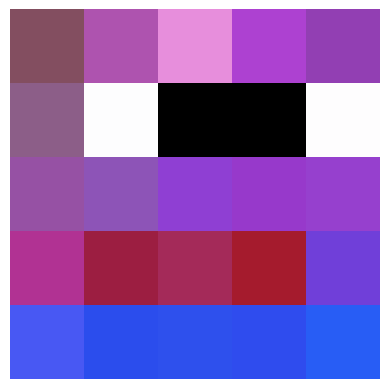

10399>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 17ms/step


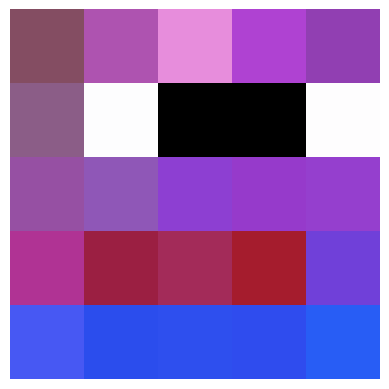

10499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


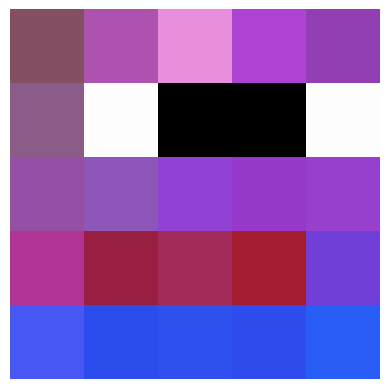

10599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


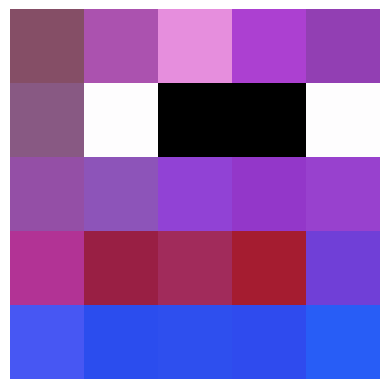

10699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


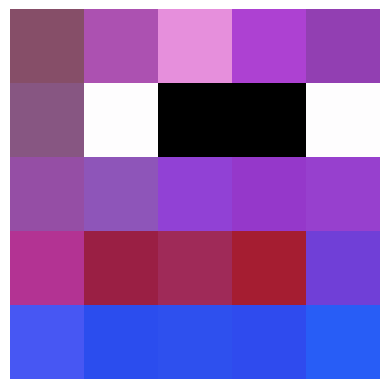

10799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


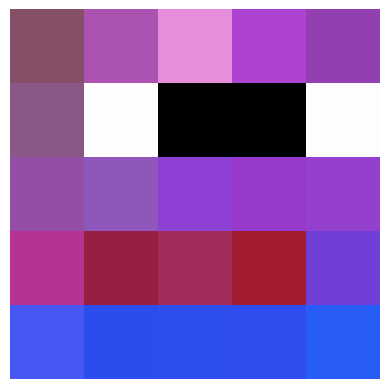

10899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


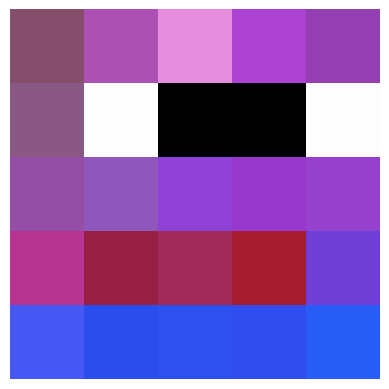

10999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


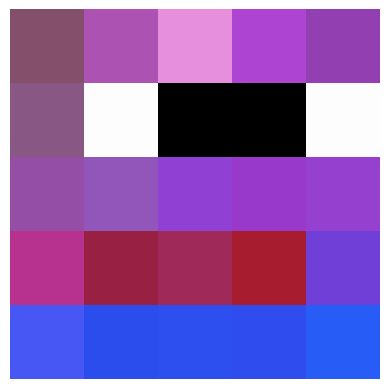

11099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


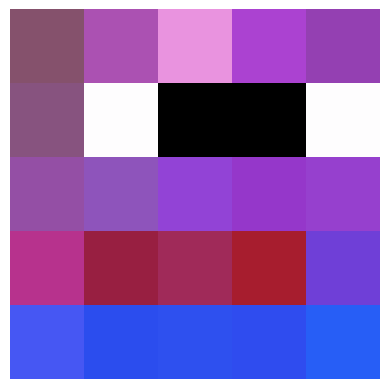

11199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


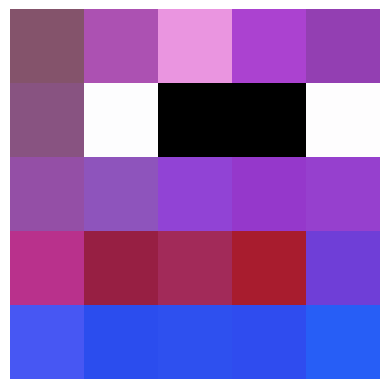

11299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


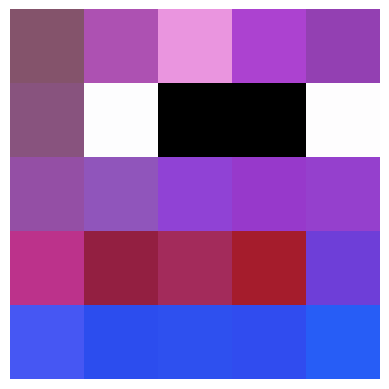

11399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


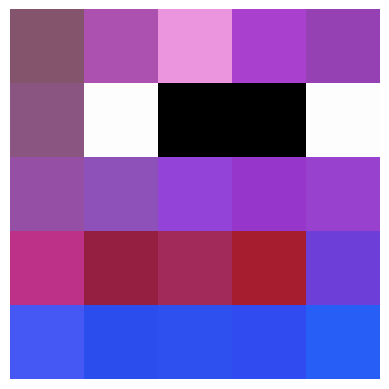

11499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


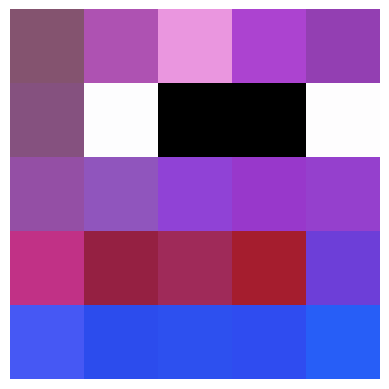

11599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


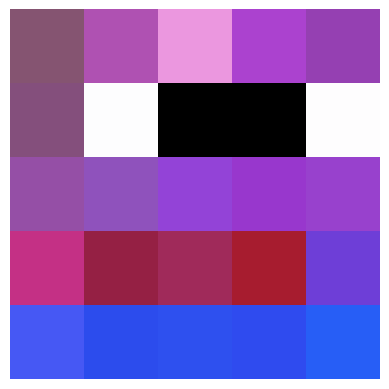

11699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


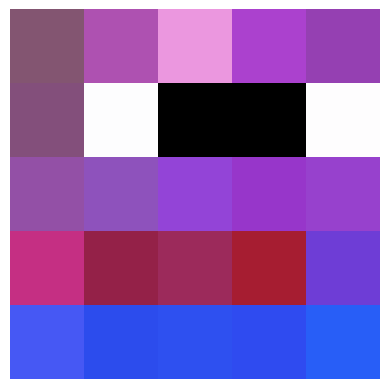

11799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


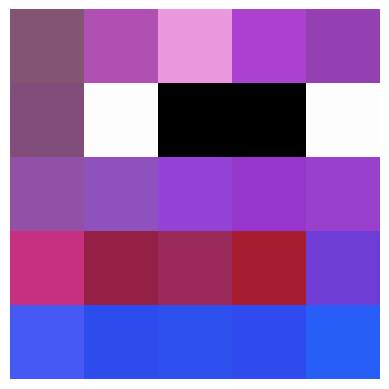

11899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


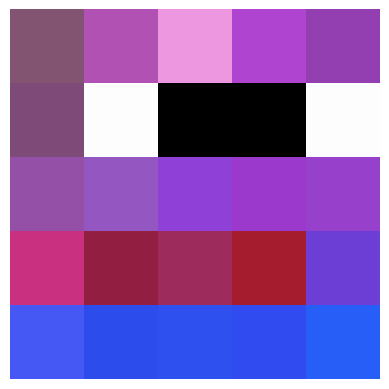

11999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


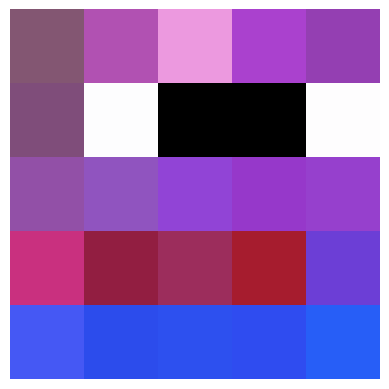

12099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


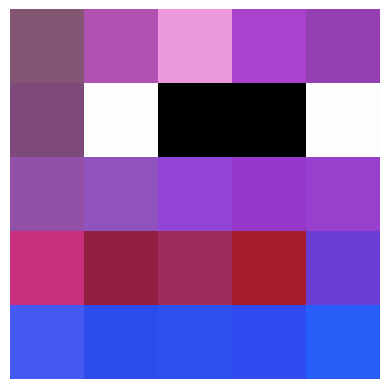

12199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


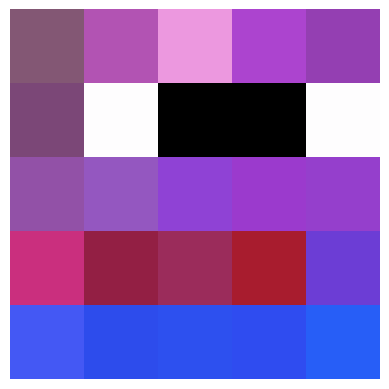

12299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


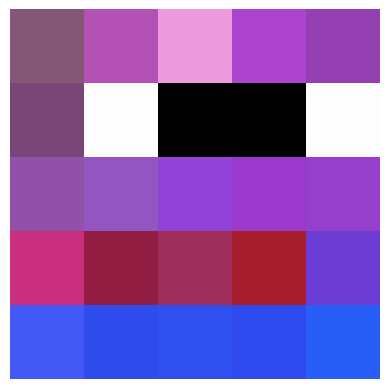

12399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


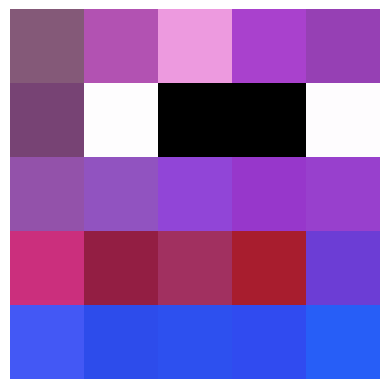

12499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


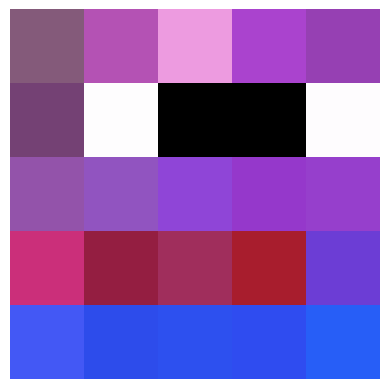

12599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


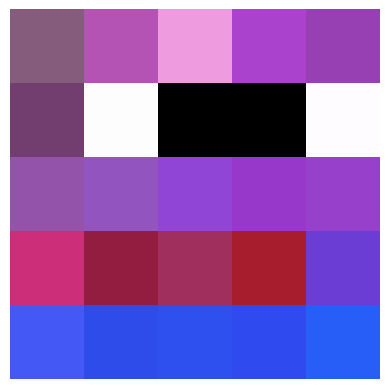

12699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


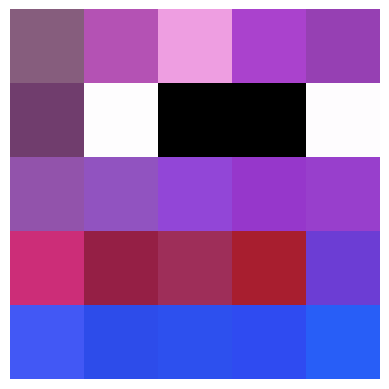

12799>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


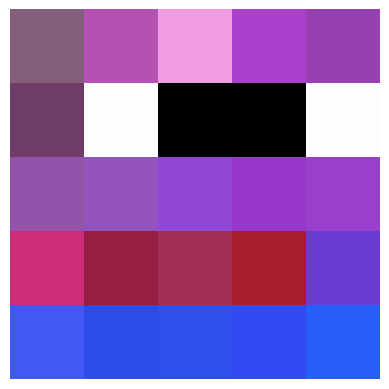

12899>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


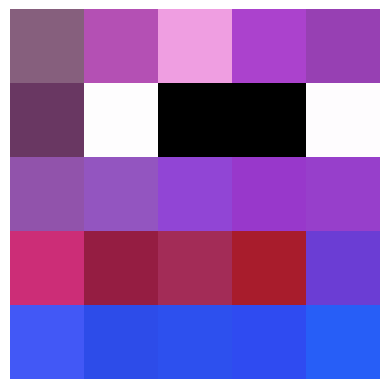

12999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


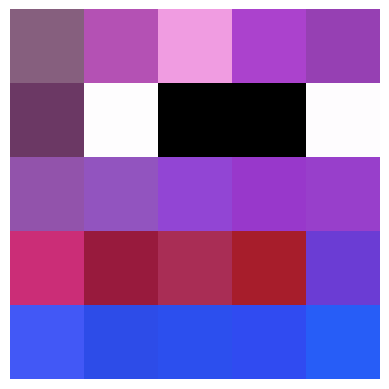

13099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


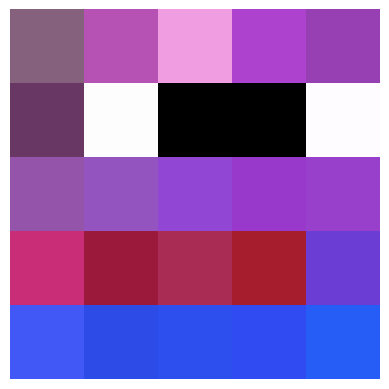

13199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


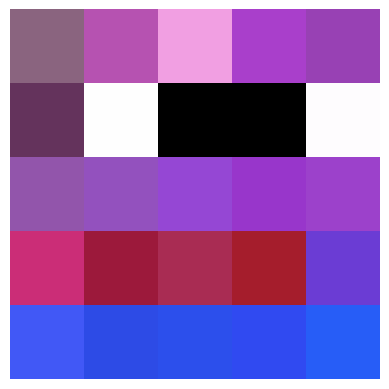

13299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


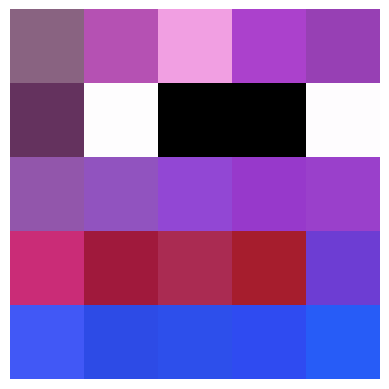

13399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


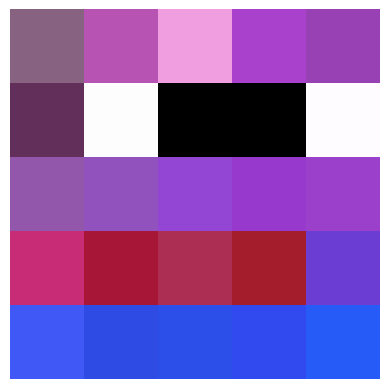

13499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


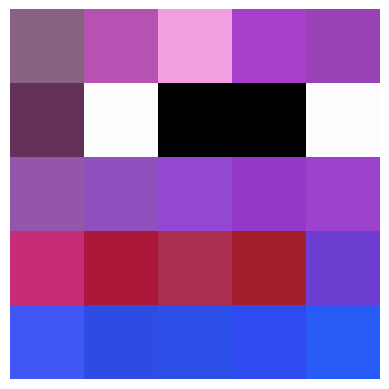

13599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


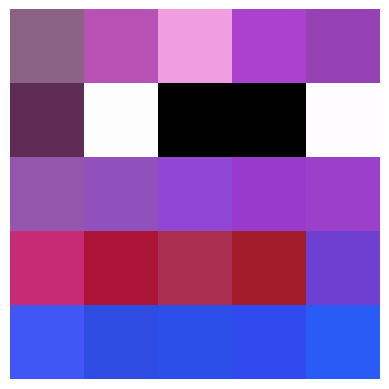

13699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


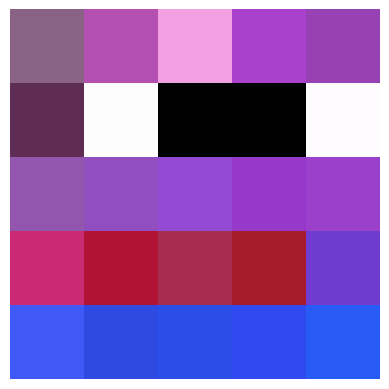

13799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


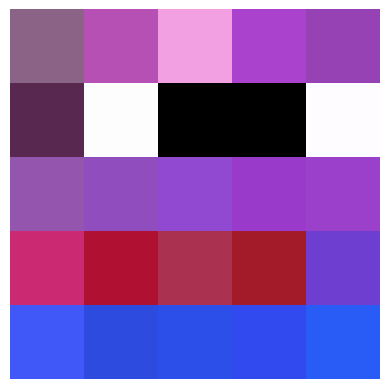

13899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


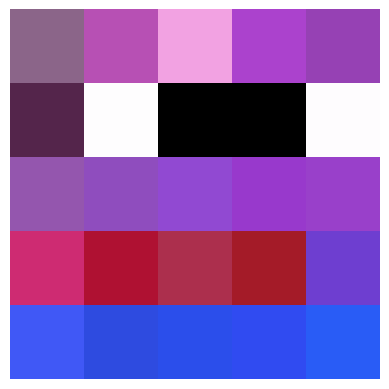

13999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


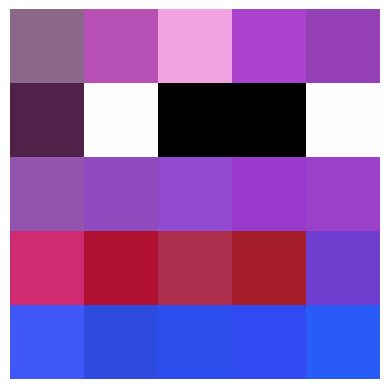

14099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


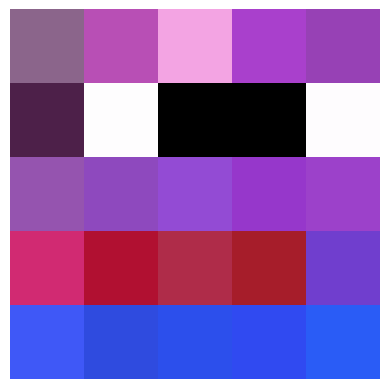

14199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


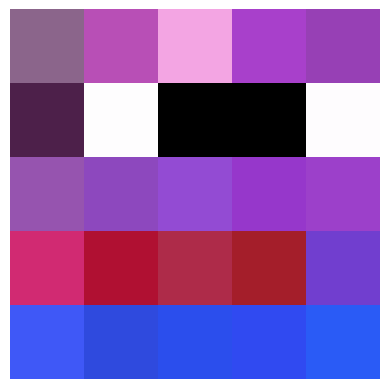

14299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


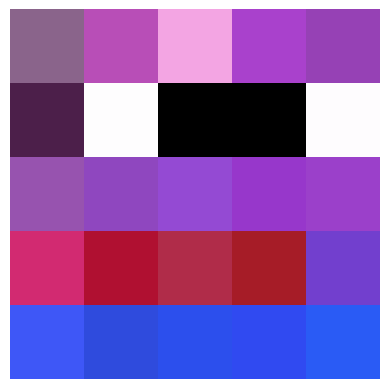

14399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


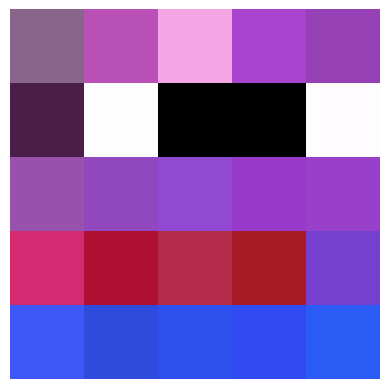

14499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


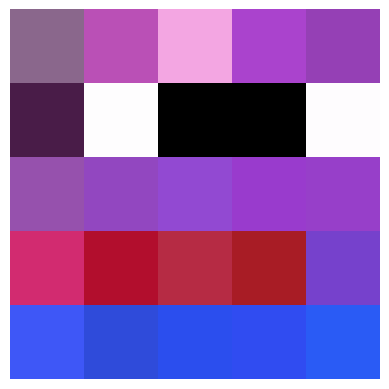

14599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


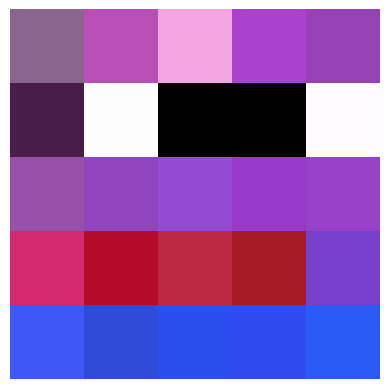

14699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


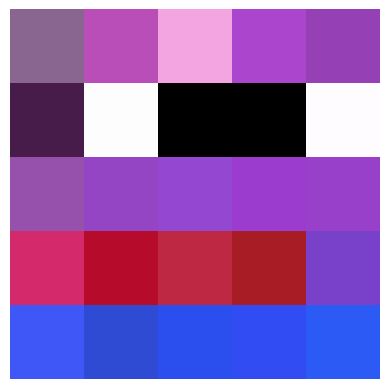

14799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


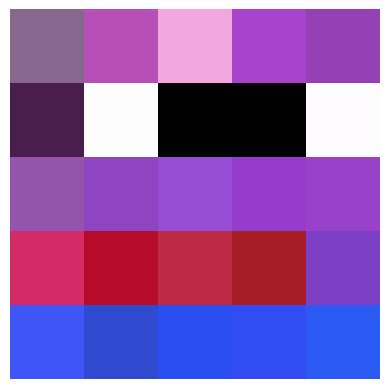

14899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


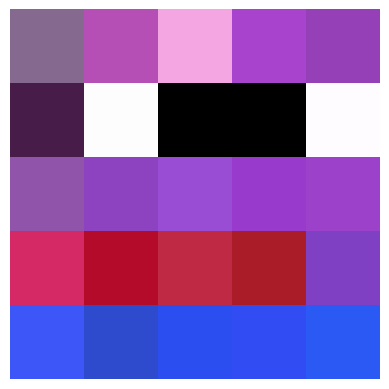

14999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 21ms/step


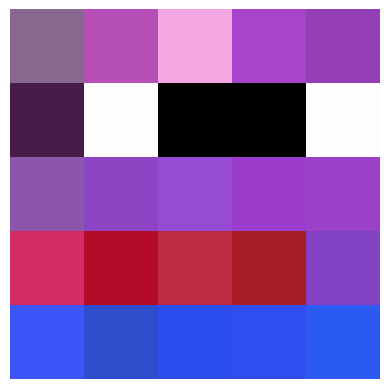

15099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


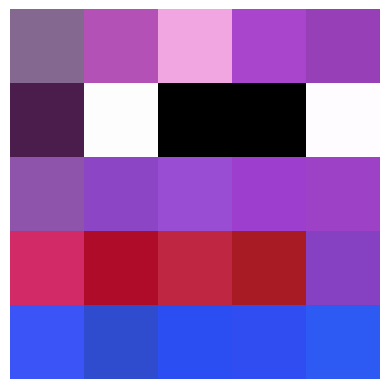

15199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


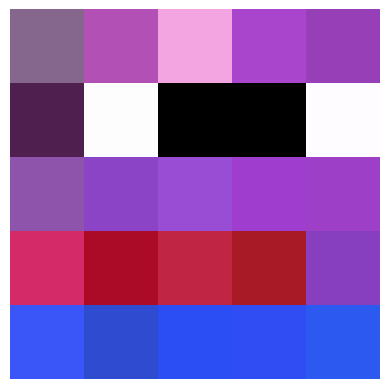

15299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


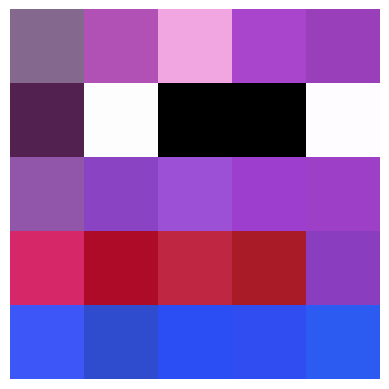

15399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


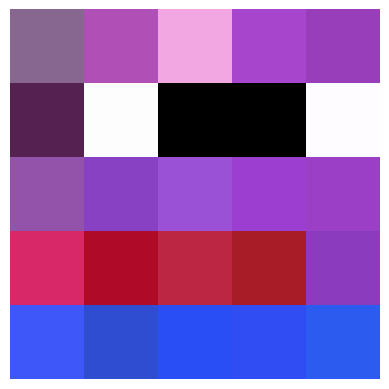

15499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


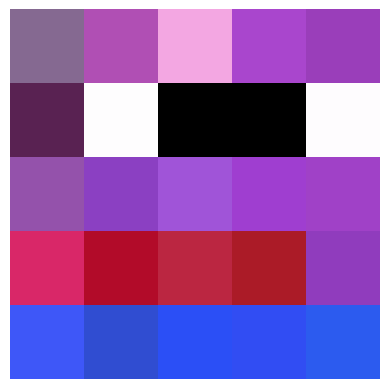

15599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


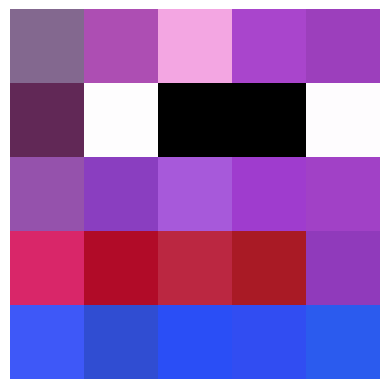

15699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


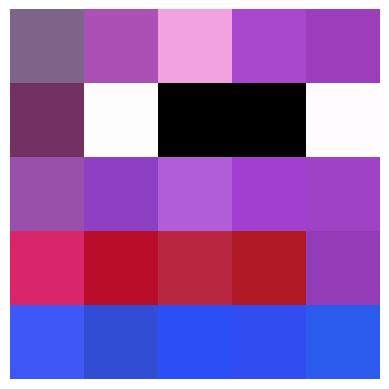

15799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


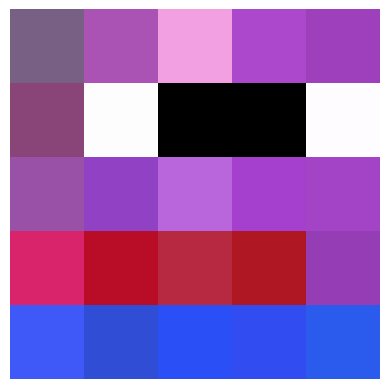

15899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


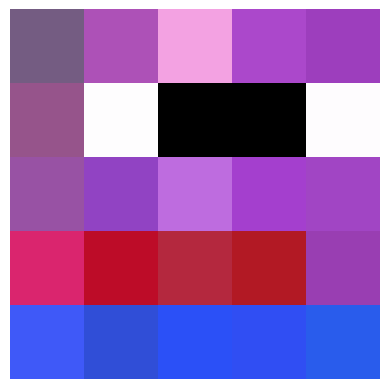

15999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


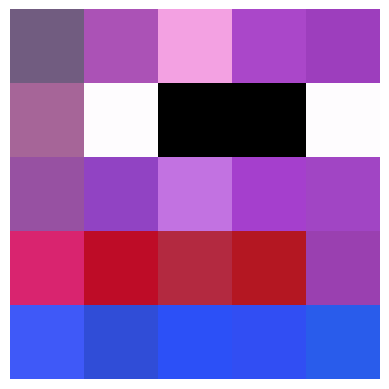

16099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


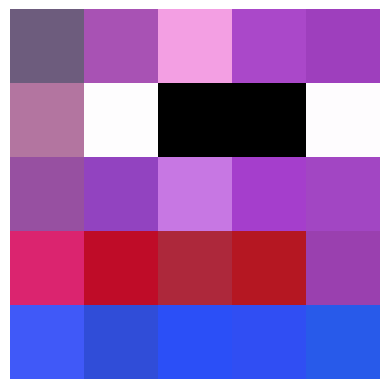

16199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


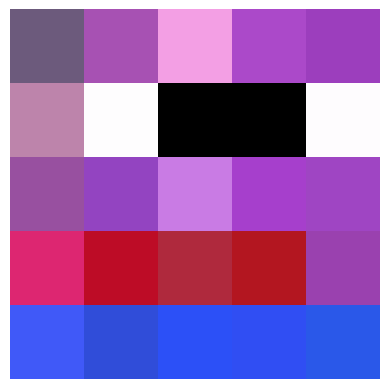

16299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


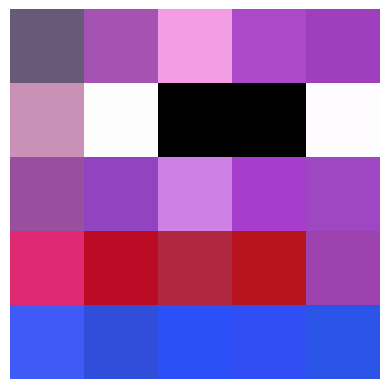

16399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


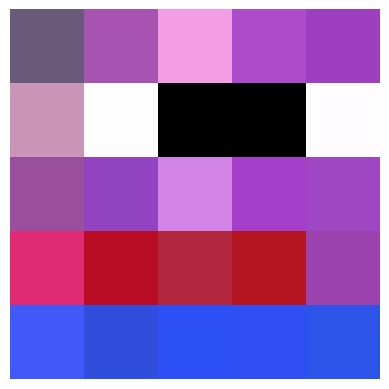

16499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


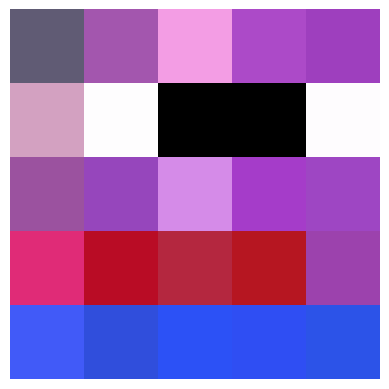

16599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


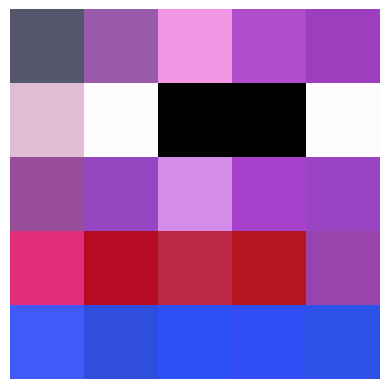

16699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


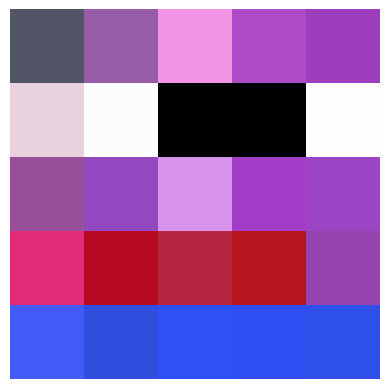

16799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


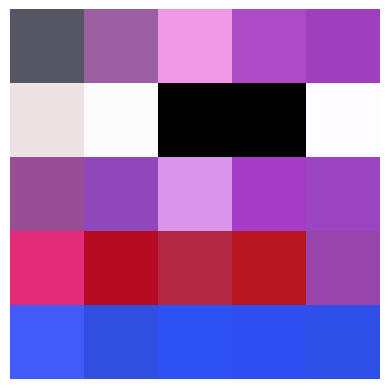

16899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


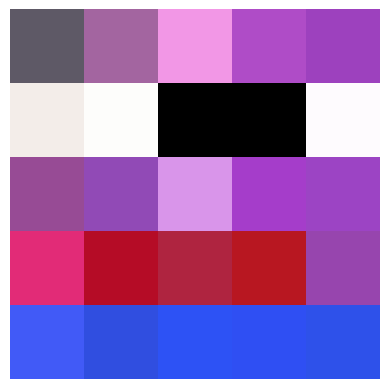

16999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


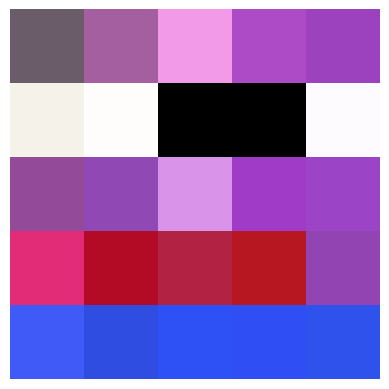

17099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


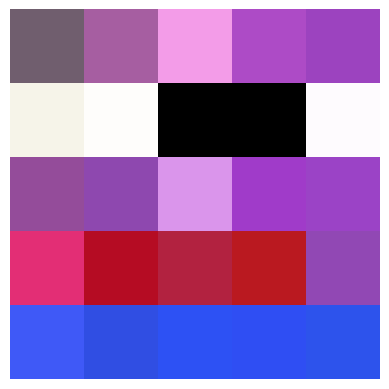

17199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


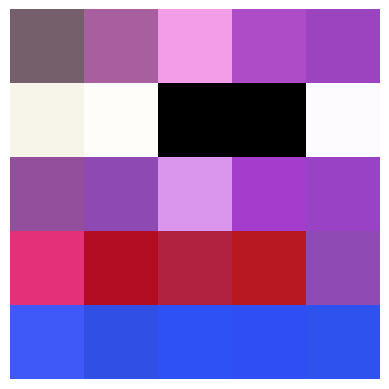

17299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


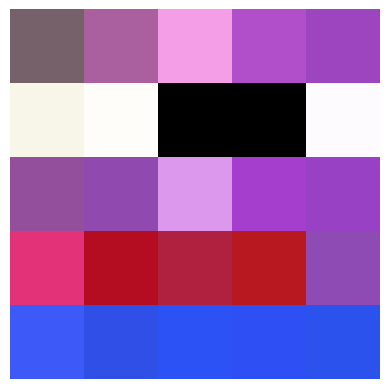

17399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


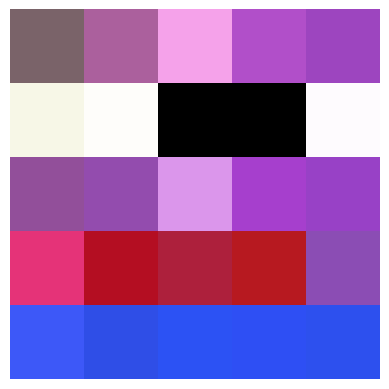

17499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


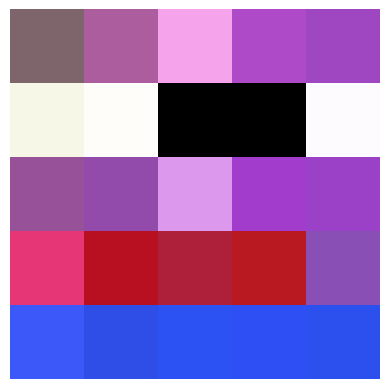

17599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


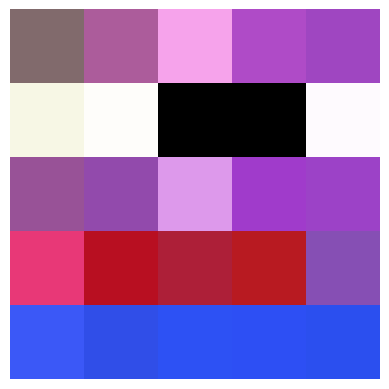

17699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


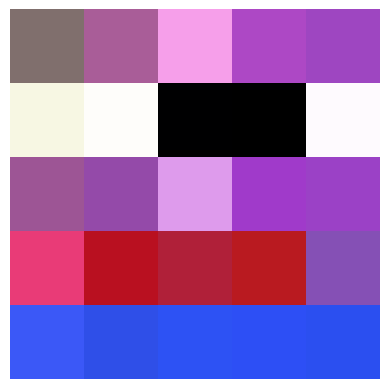

17799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


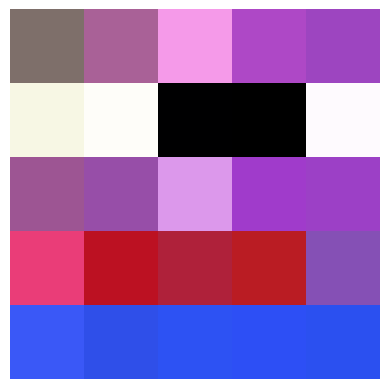

17899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


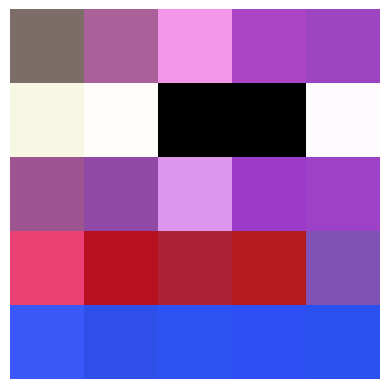

17999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


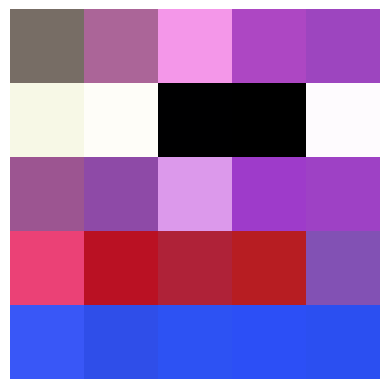

18099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


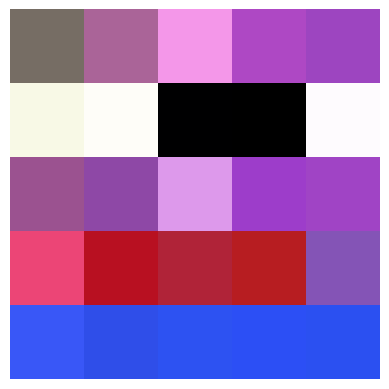

18199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


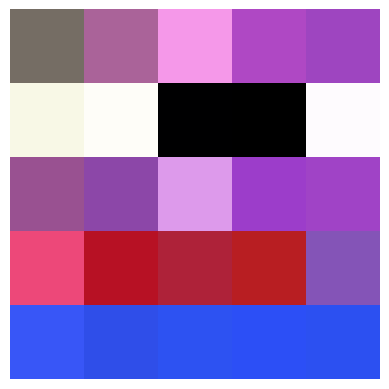

18299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


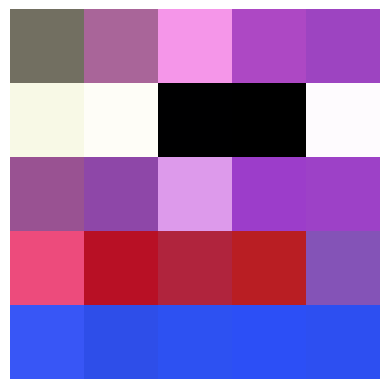

18399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


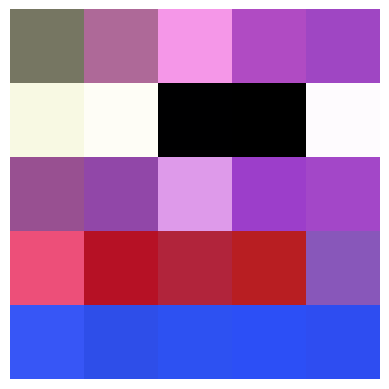

18499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


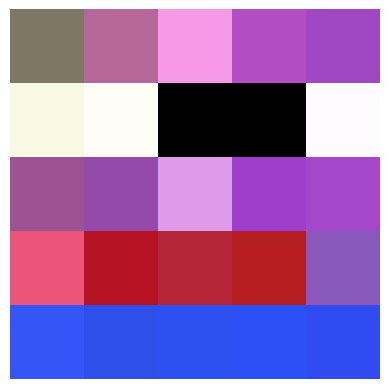

18599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


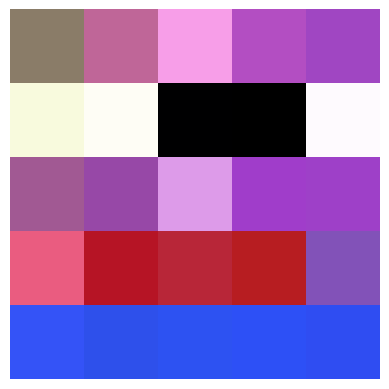

18699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


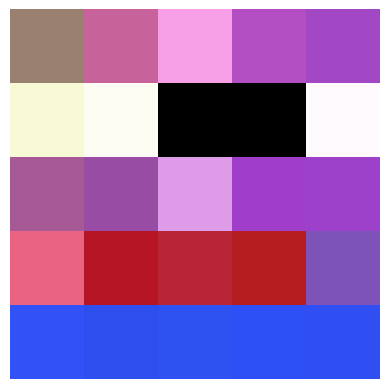

18799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


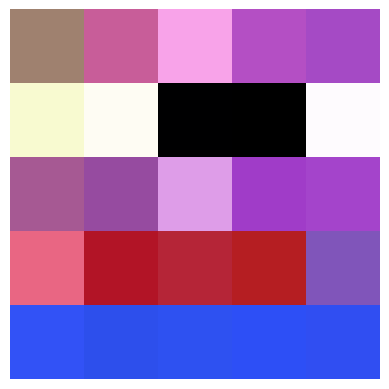

18899>Accuracy real: 97%, fake: 100%
1/1 [==============================] - 0s 13ms/step


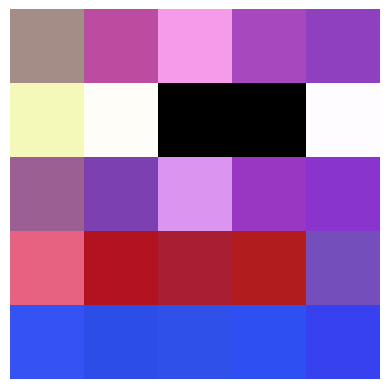

18999>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


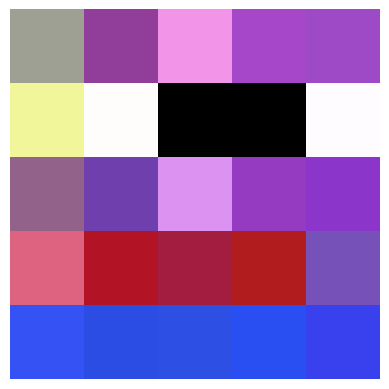

19099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


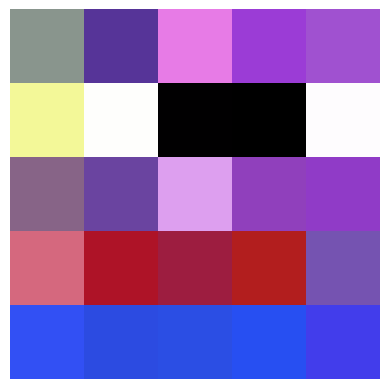

19199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


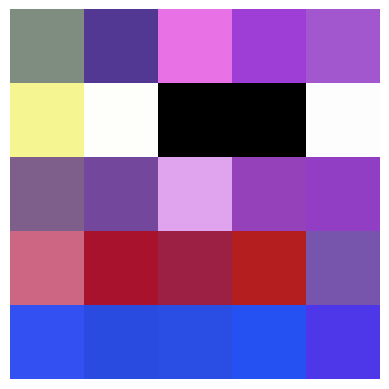

19299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


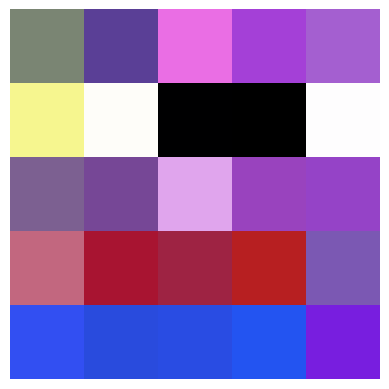

19399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


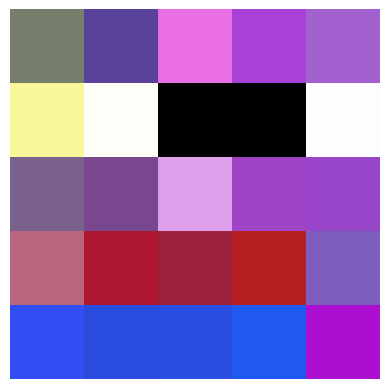

19499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


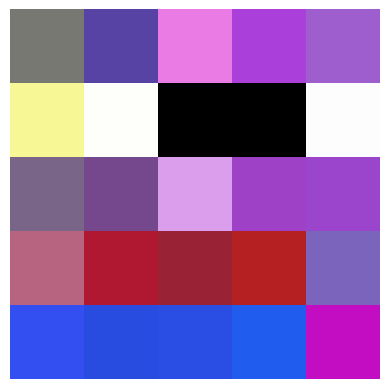

19599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


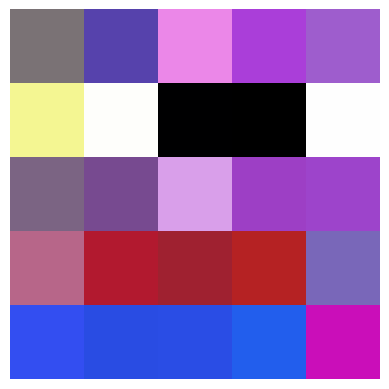

19699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


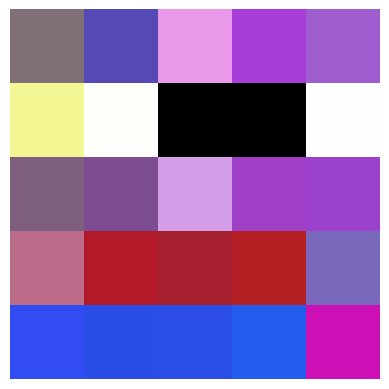

19799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


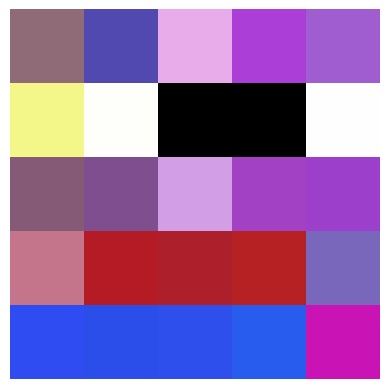

19899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


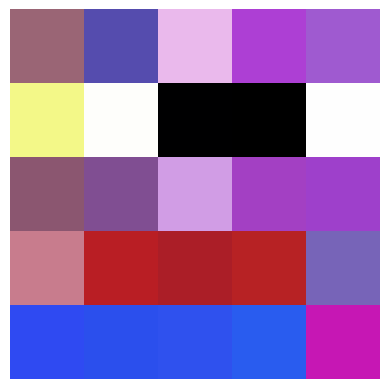

19999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


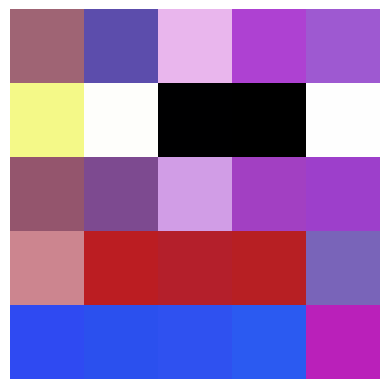

20099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


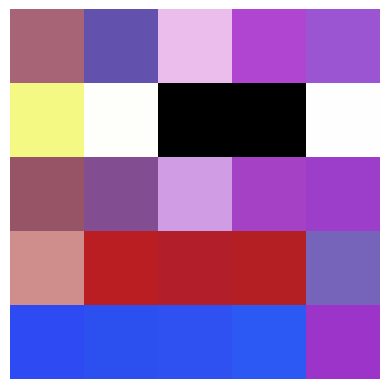

20199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


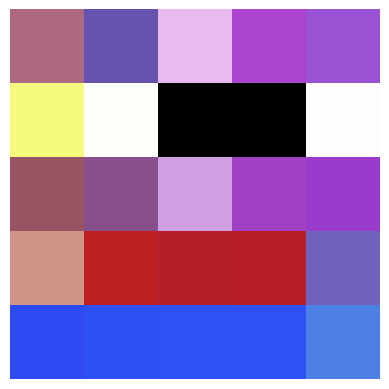

20299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


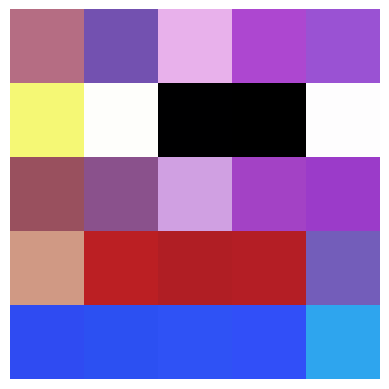

20399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


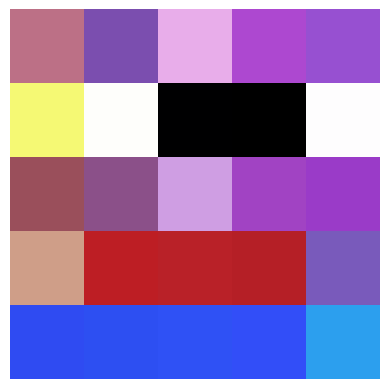

20499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


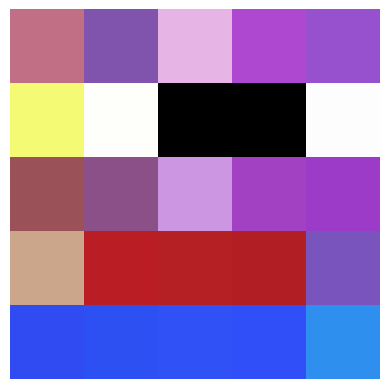

20599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


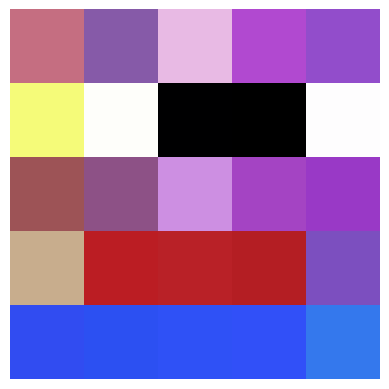

20699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


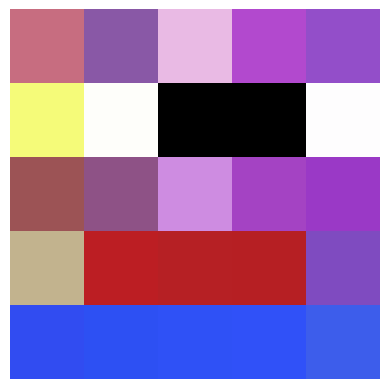

20799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


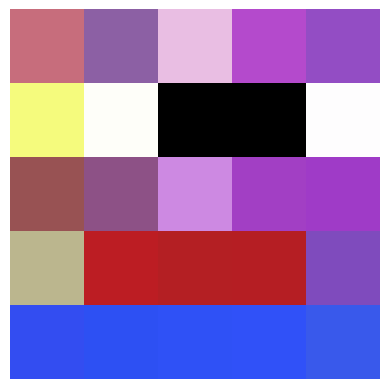

20899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


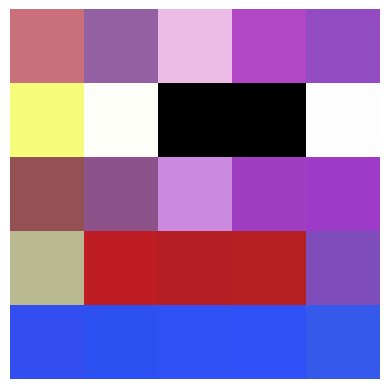

20999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


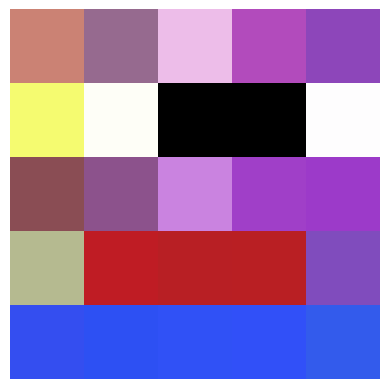

21099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


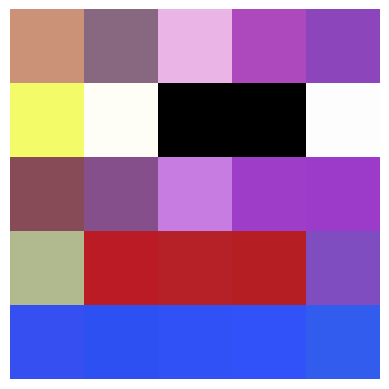

21199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


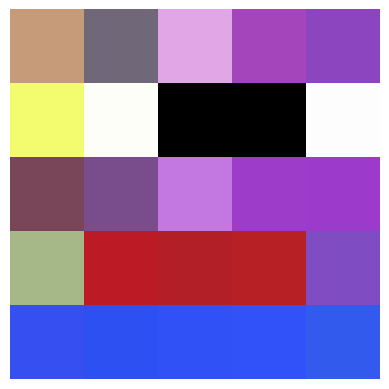

21299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 22ms/step


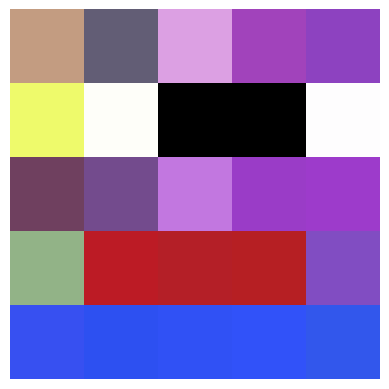

21399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


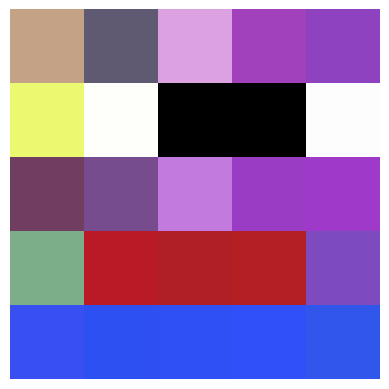

21499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


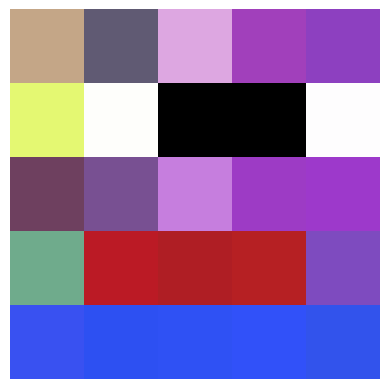

21599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


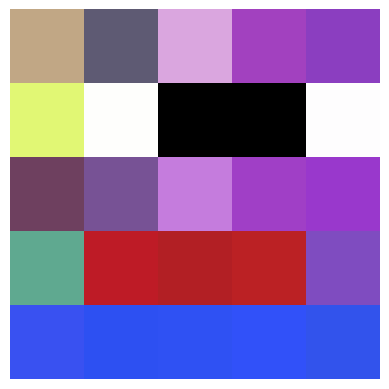

21699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


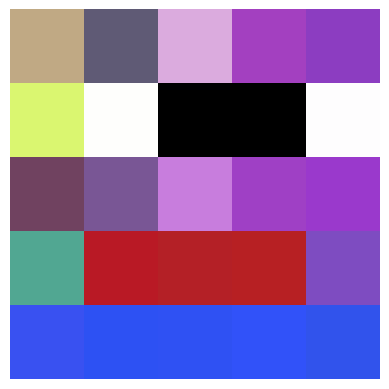

21799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


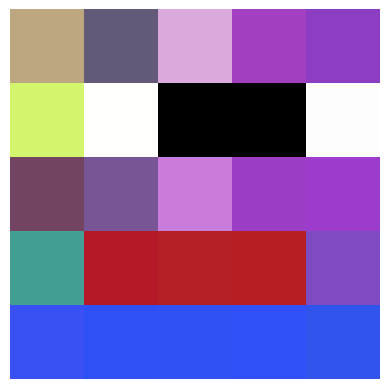

21899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


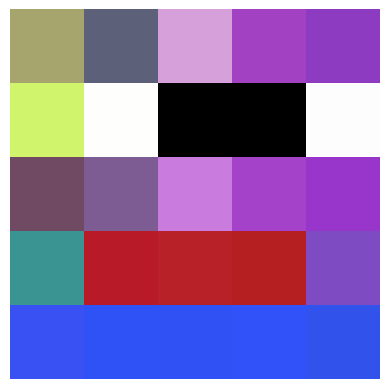

21999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


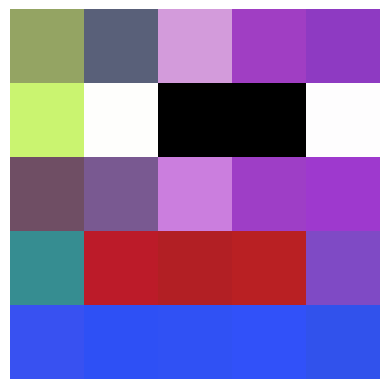

22099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


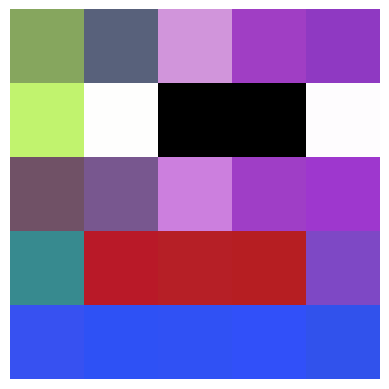

22199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


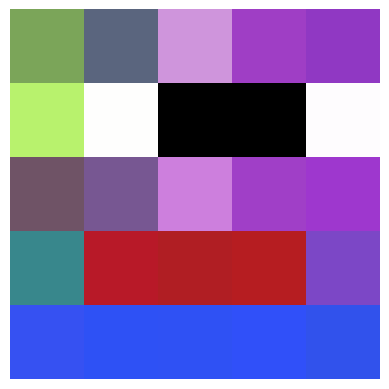

22299>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 13ms/step


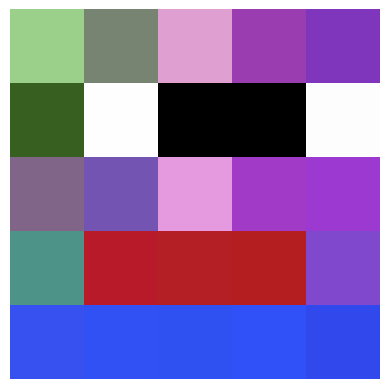

22399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


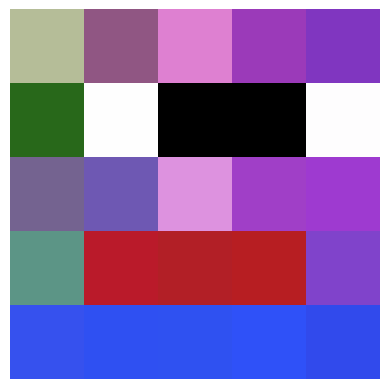

22499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


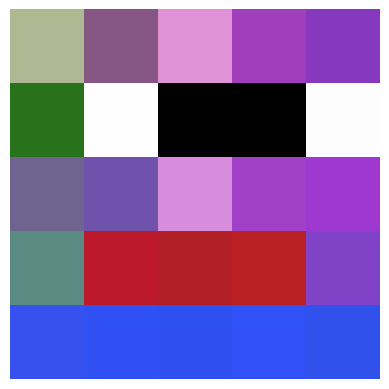

22599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


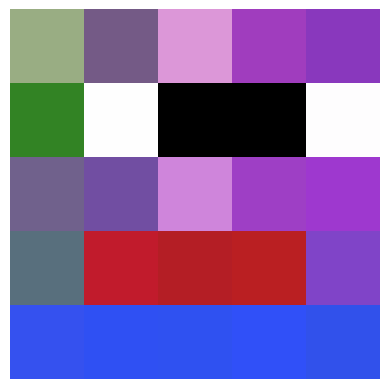

22699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


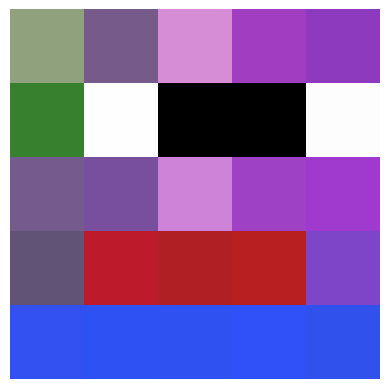

22799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


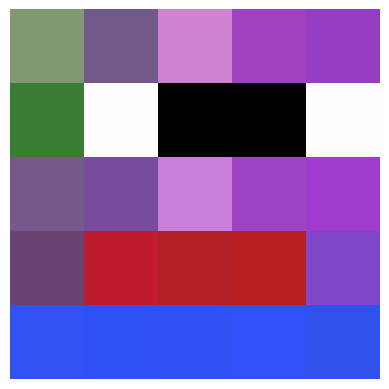

22899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


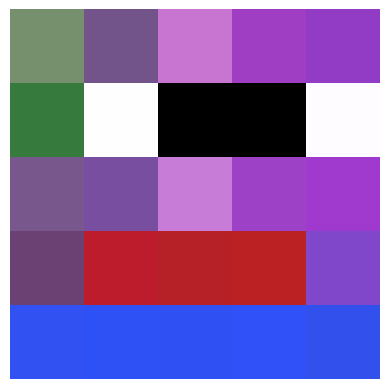

22999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


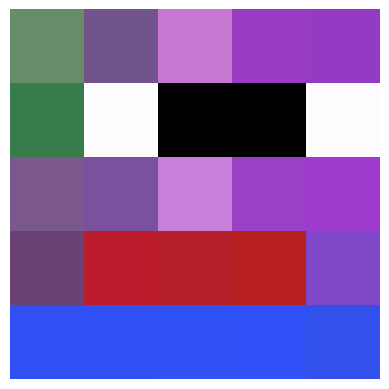

23099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


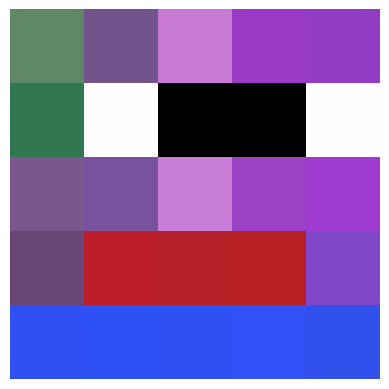

23199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


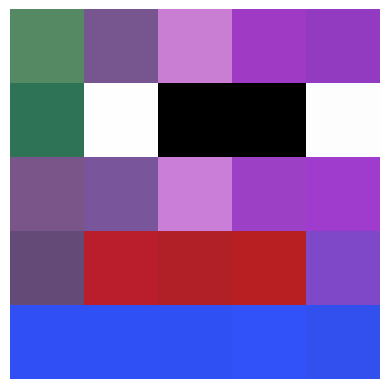

23299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


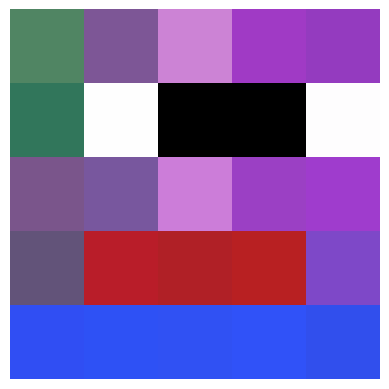

23399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


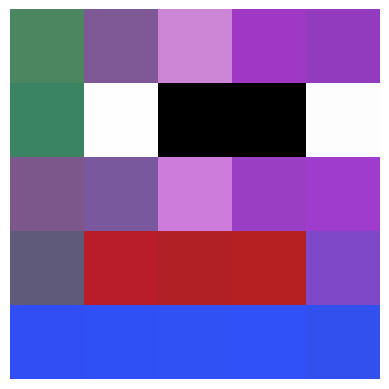

23499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


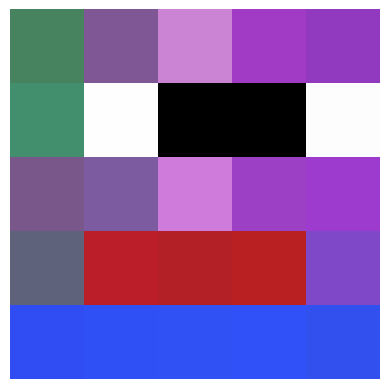

23599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


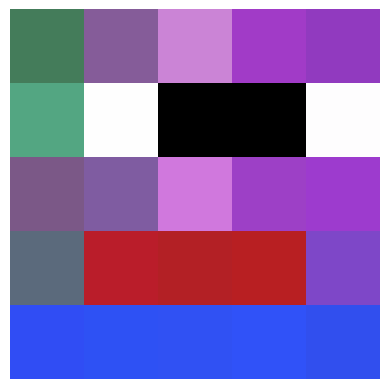

23699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


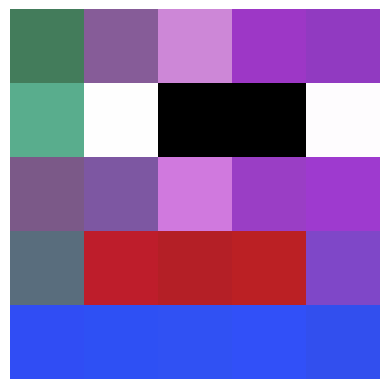

23799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


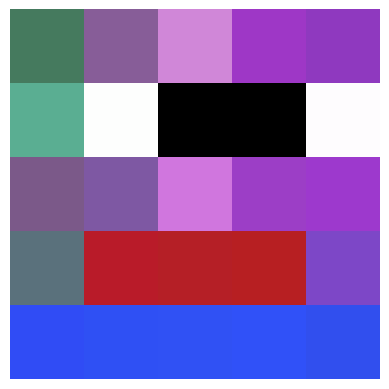

23899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


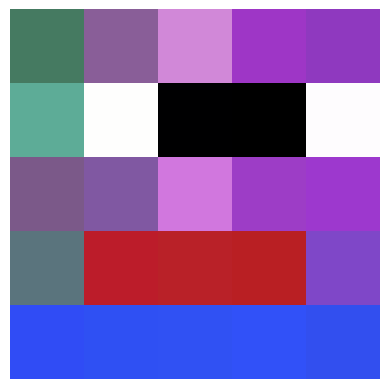

23999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


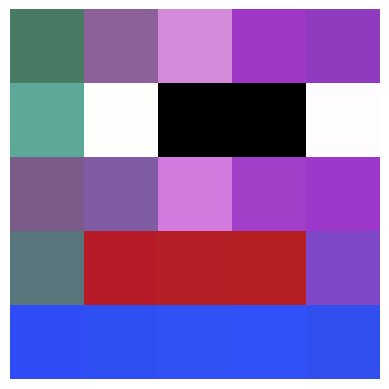

24099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


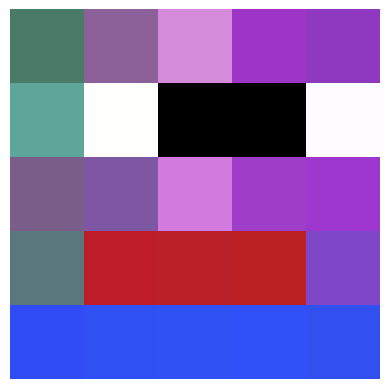

24199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


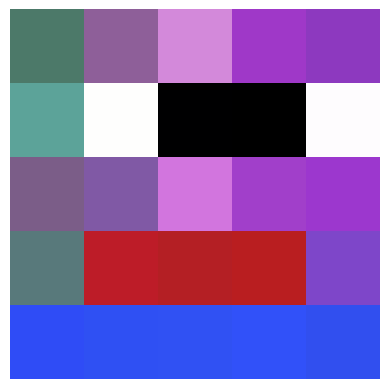

24299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


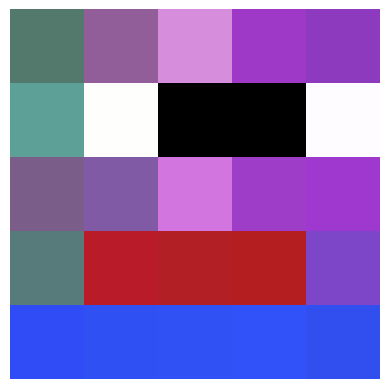

24399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


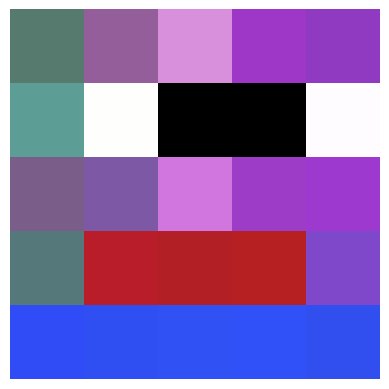

24499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 20ms/step


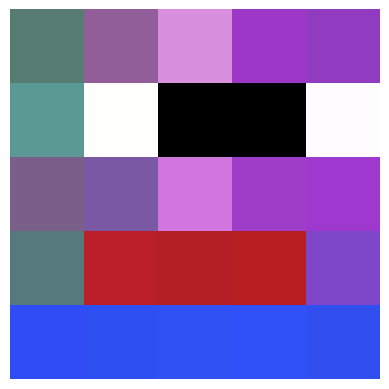

24599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


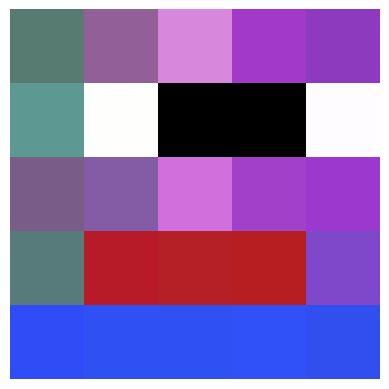

24699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


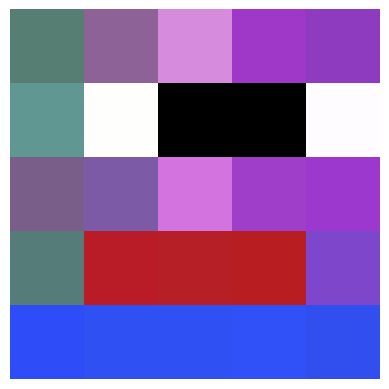

24799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


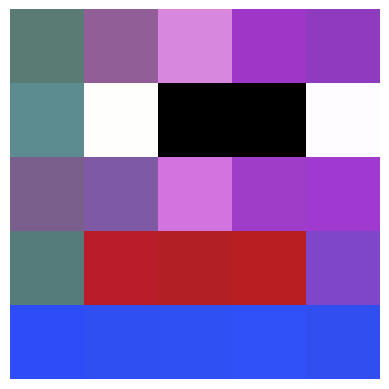

24899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


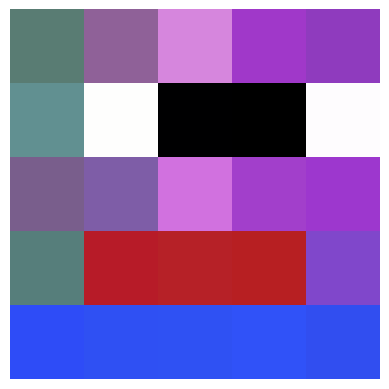

24999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


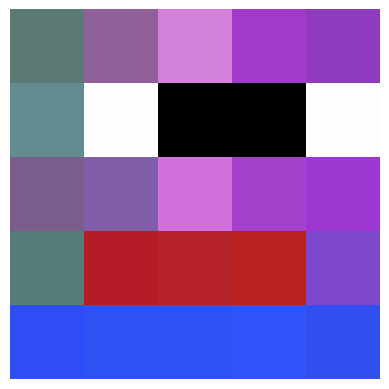

25099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


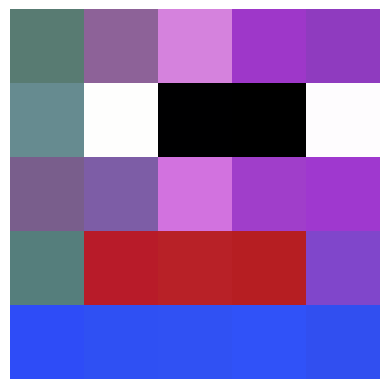

25199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


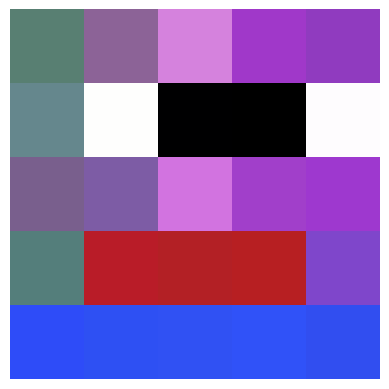

25299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


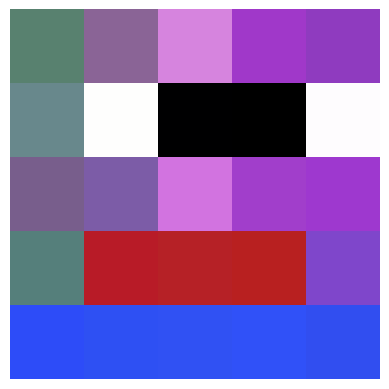

25399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


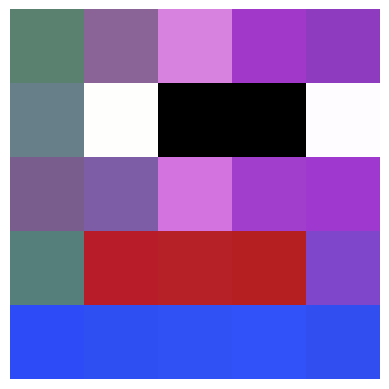

25499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


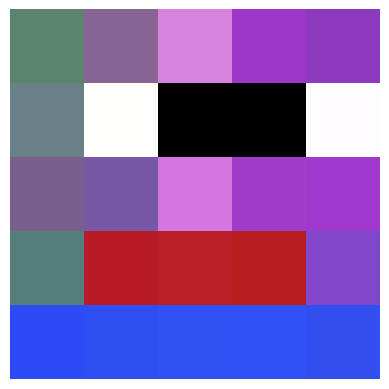

25599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


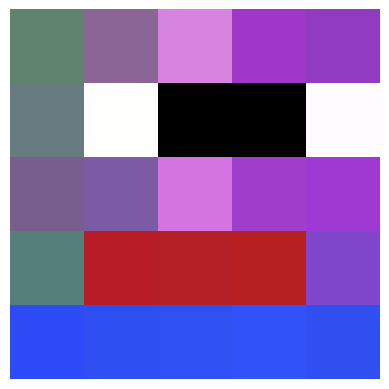

25699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


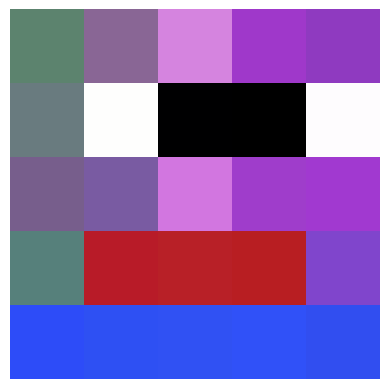

25799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


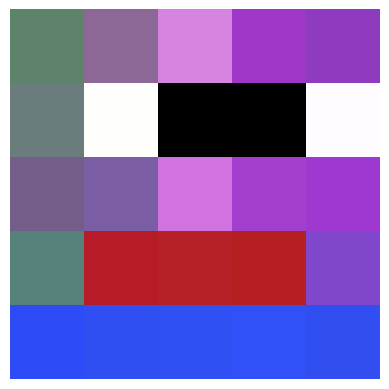

25899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


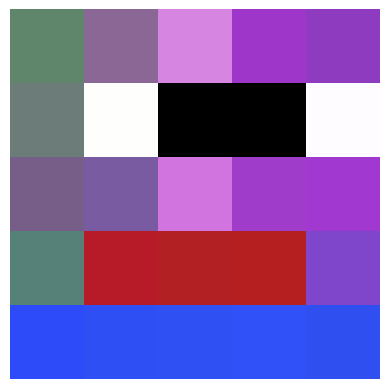

25999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


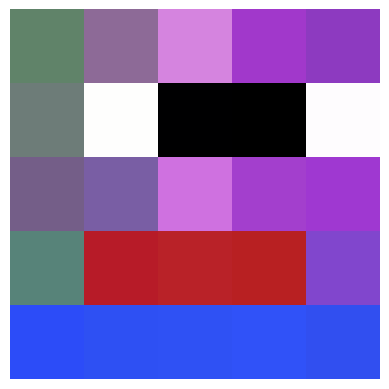

26099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


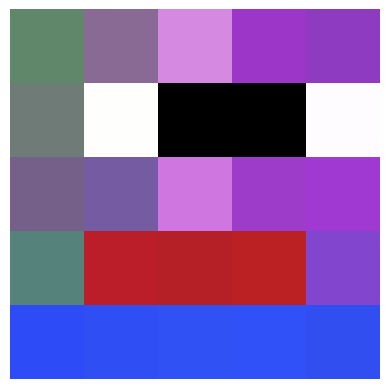

26199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


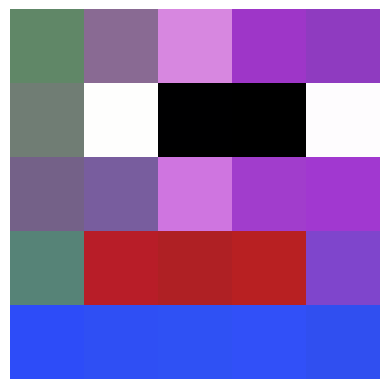

26299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


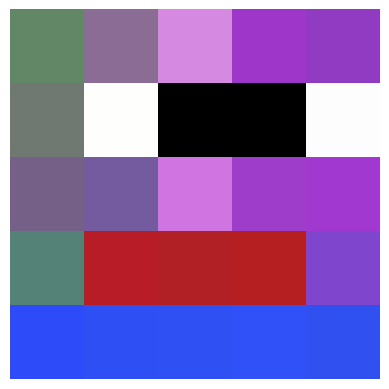

26399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


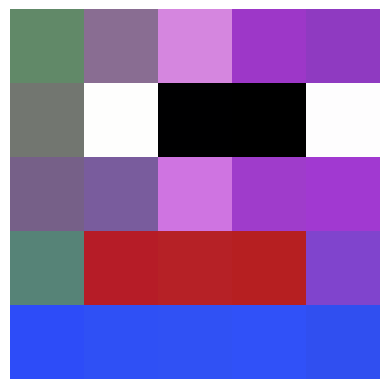

26499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


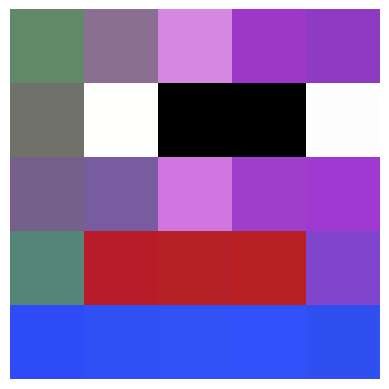

26599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


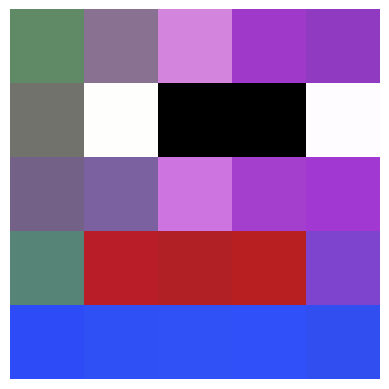

26699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


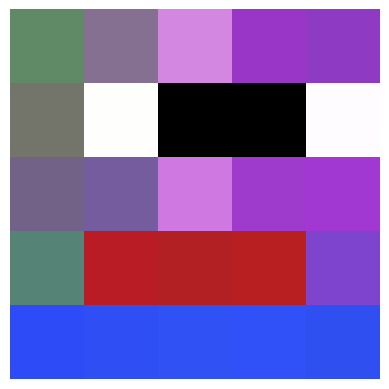

26799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


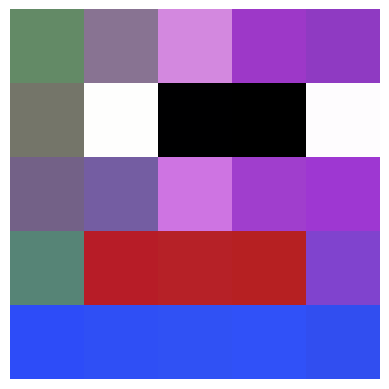

26899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


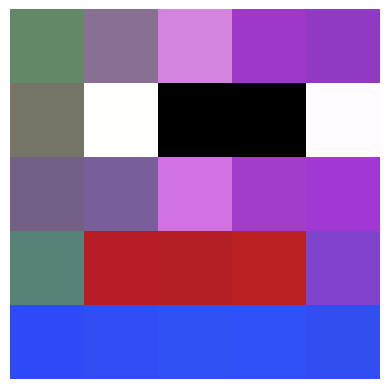

26999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


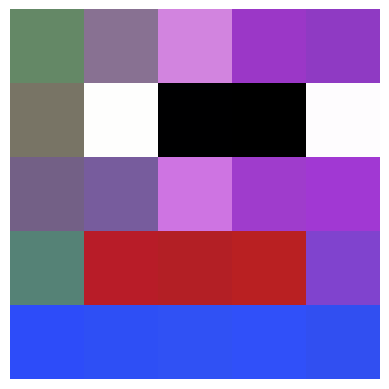

27099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


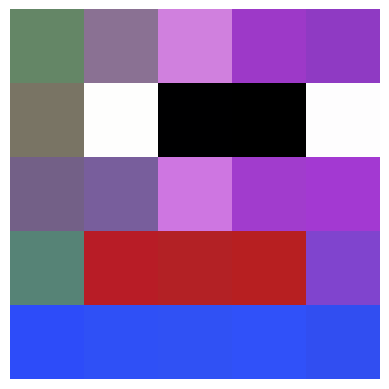

27199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


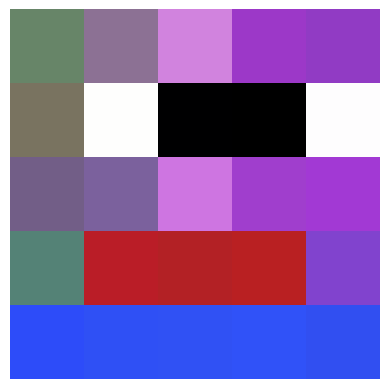

27299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


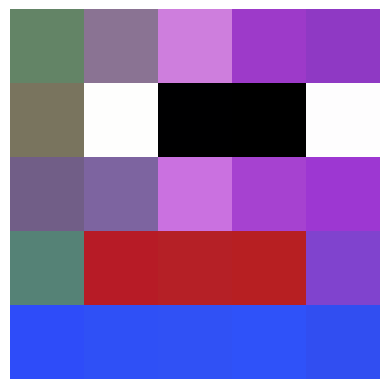

27399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


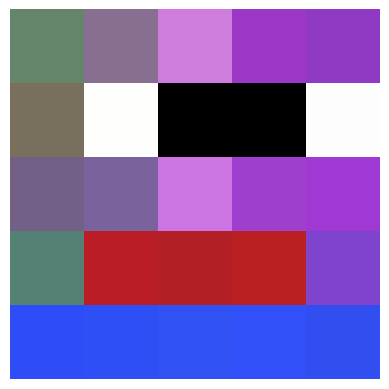

27499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


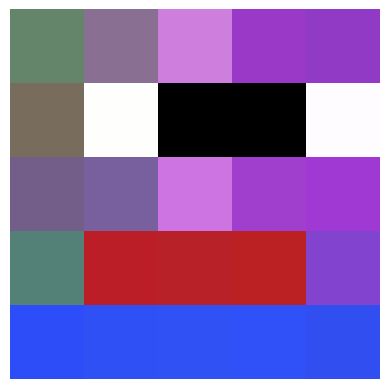

27599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


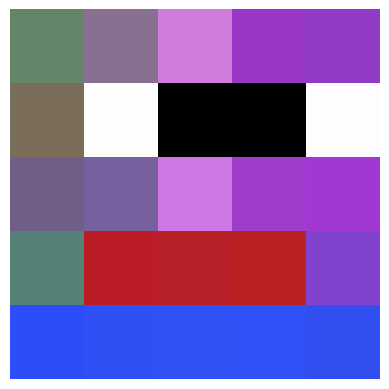

27699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


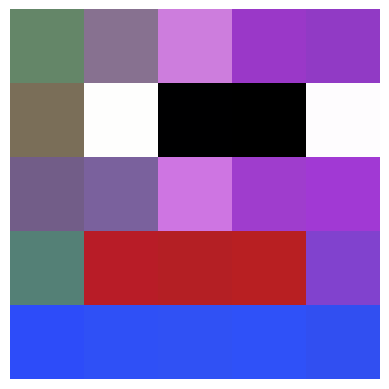

27799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


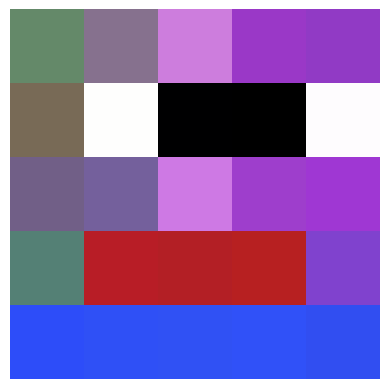

27899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


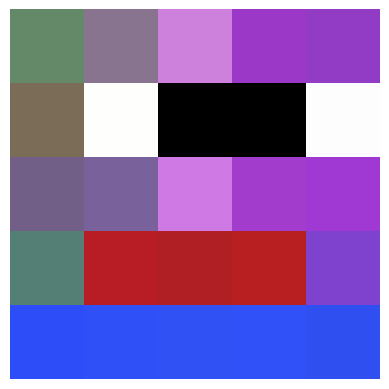

27999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


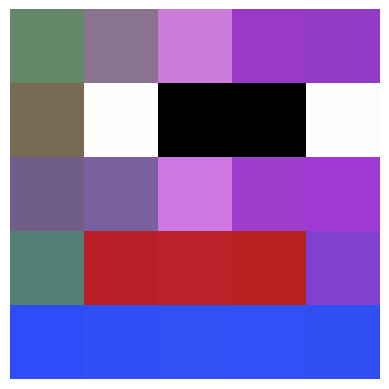

28099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


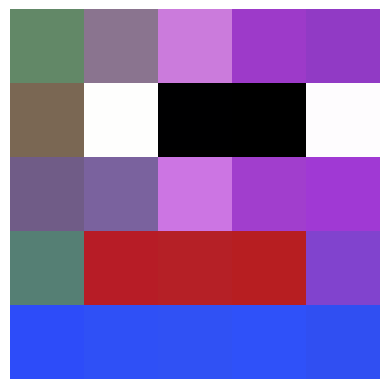

28199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


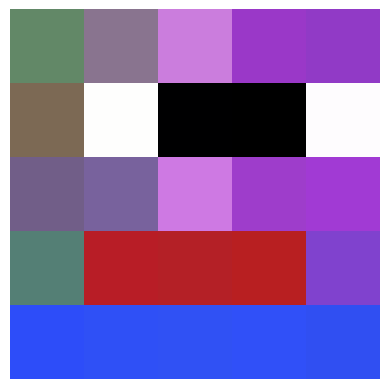

28299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


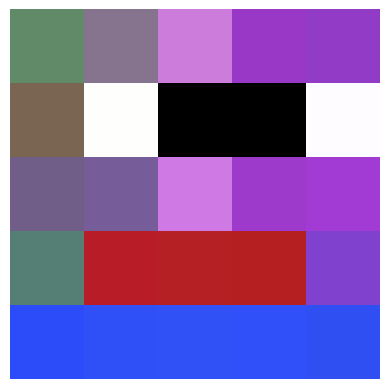

28399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


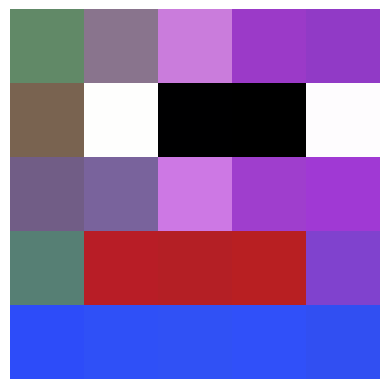

28499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


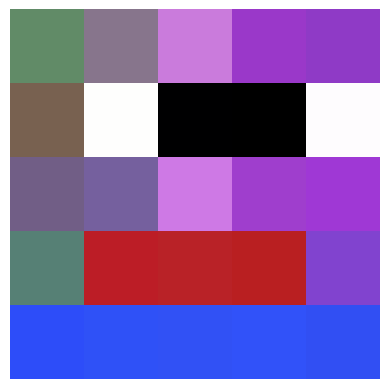

28599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


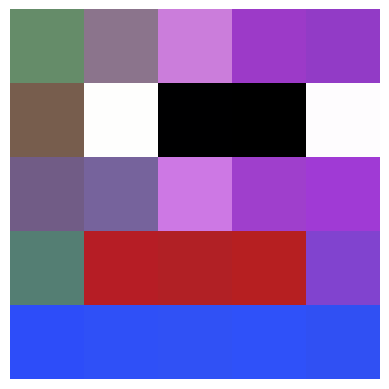

28699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


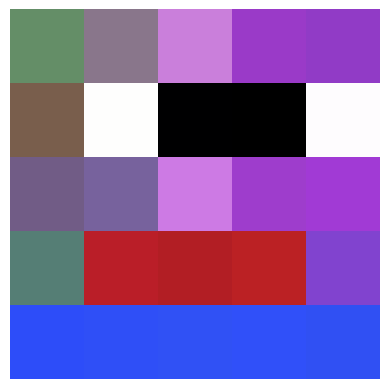

28799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


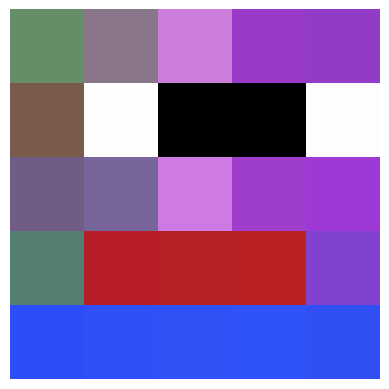

28899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


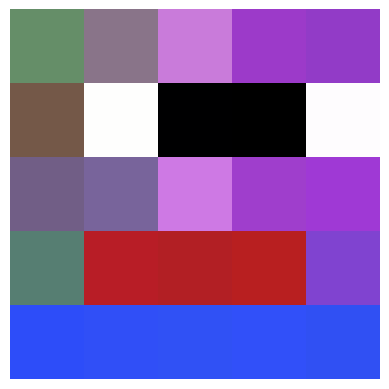

28999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


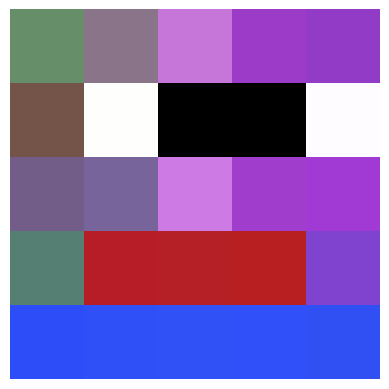

29099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


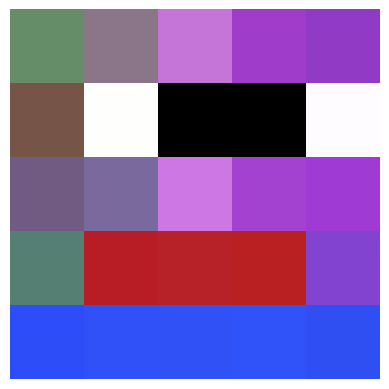

29199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


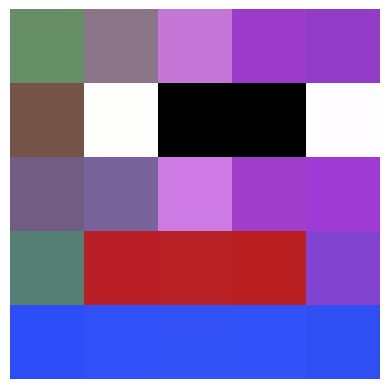

29299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


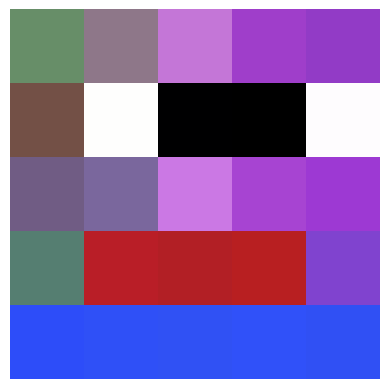

29399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


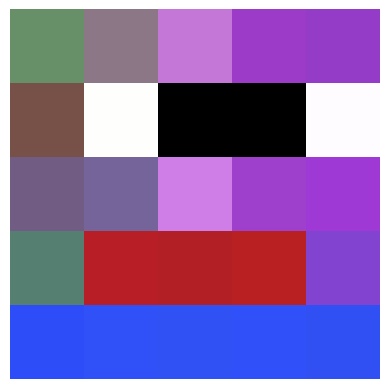

29499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 20ms/step


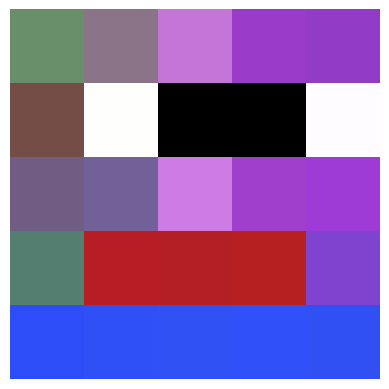

29599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


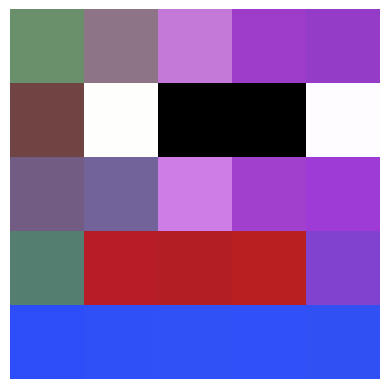

29699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


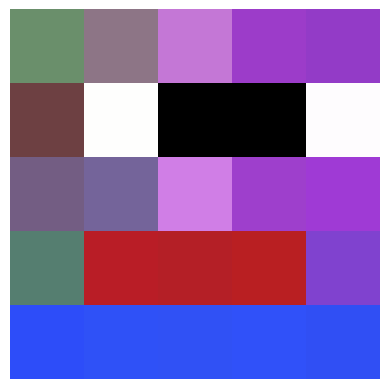

29799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


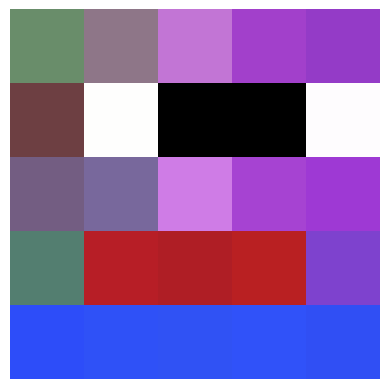

29899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


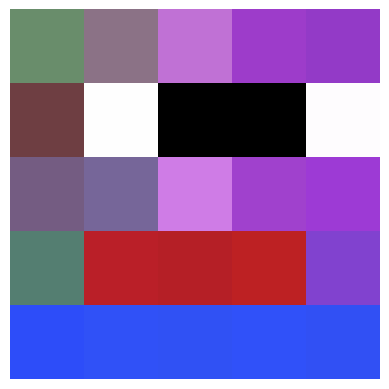

29999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


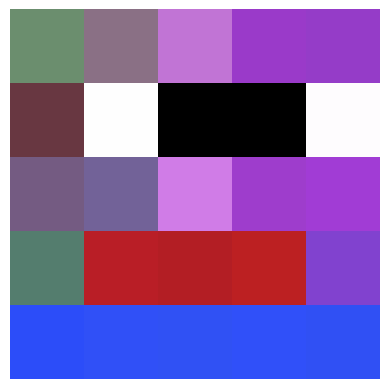

30099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


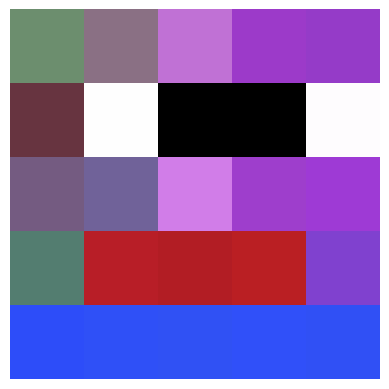

30199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


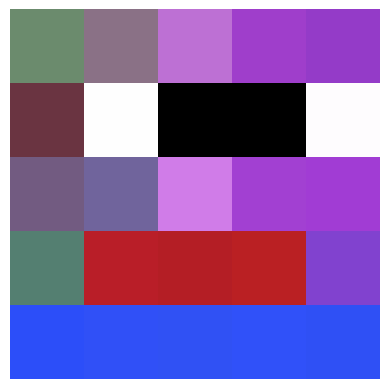

30299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


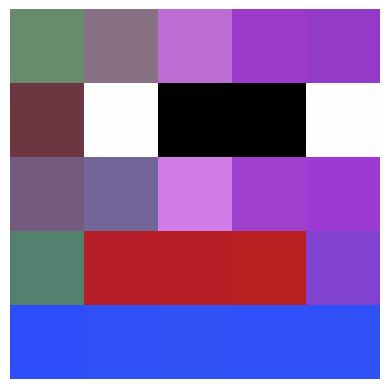

30399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


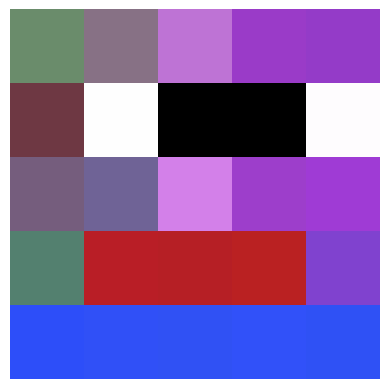

30499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


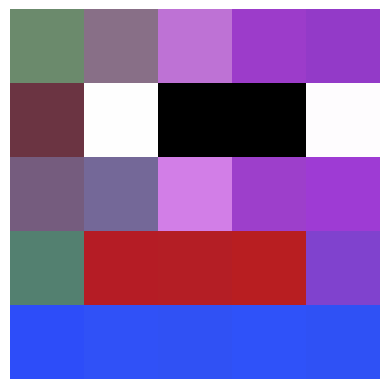

30599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


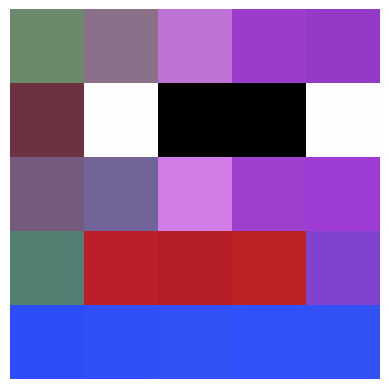

30699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


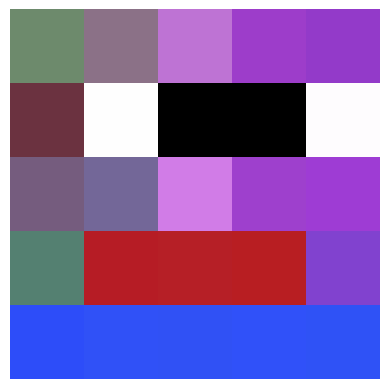

30799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


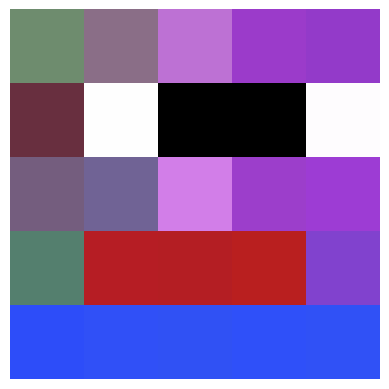

30899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


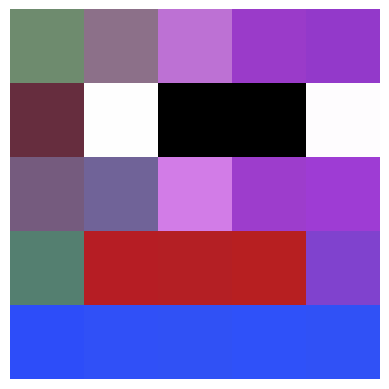

30999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


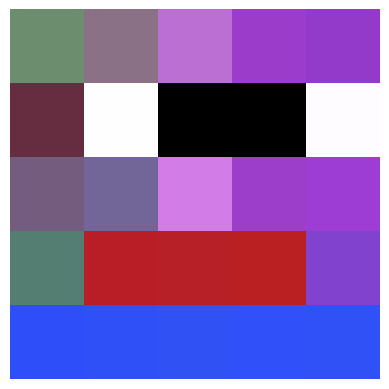

31099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


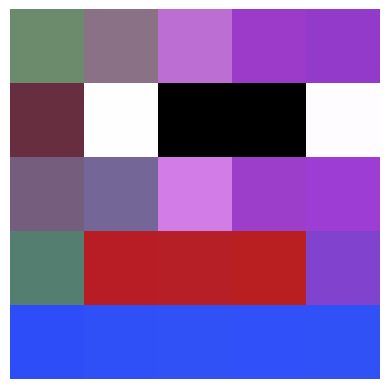

31199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


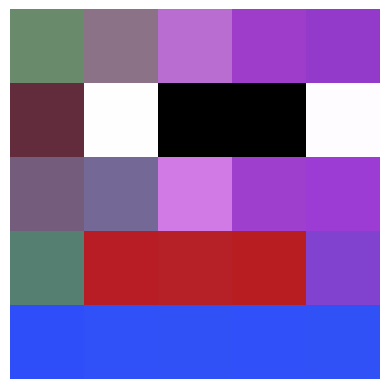

31299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


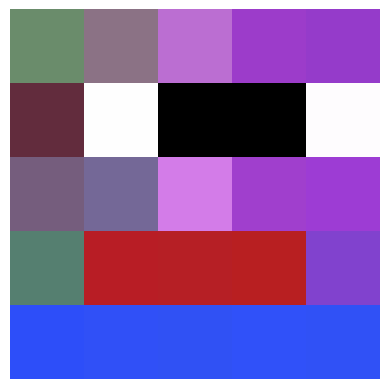

31399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


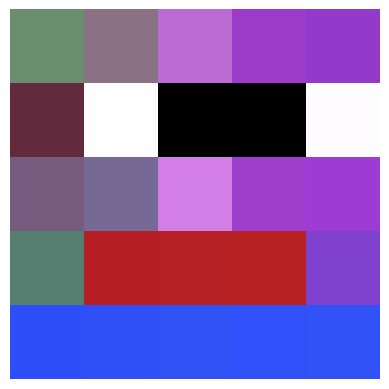

31499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


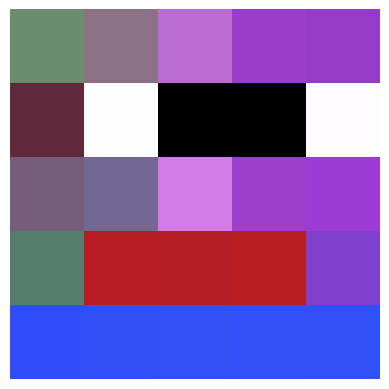

31599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


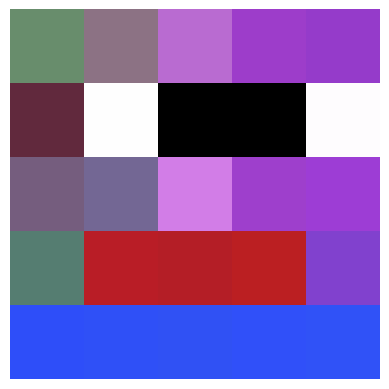

31699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


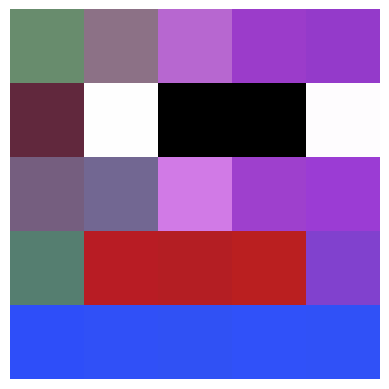

31799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


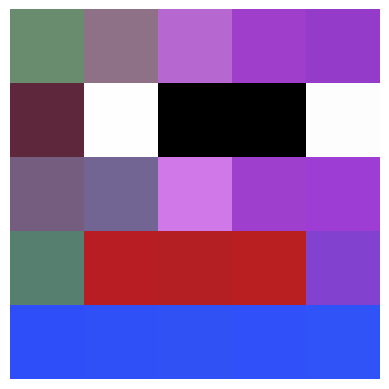

31899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


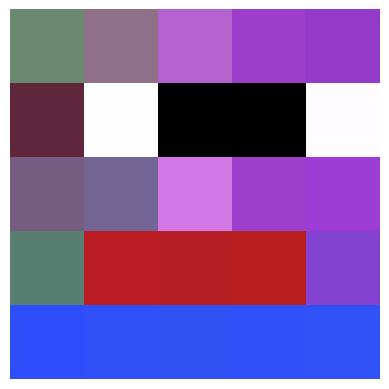

31999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


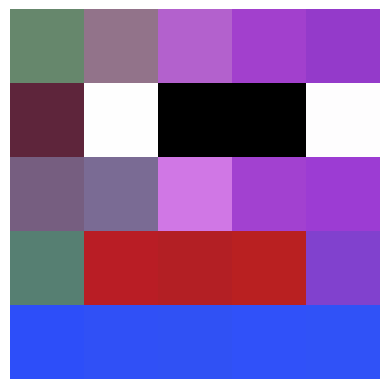

32099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


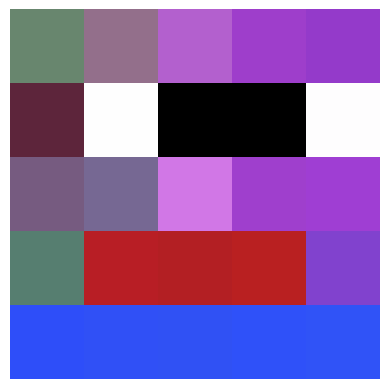

32199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


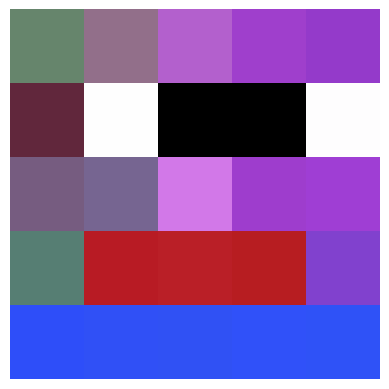

32299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


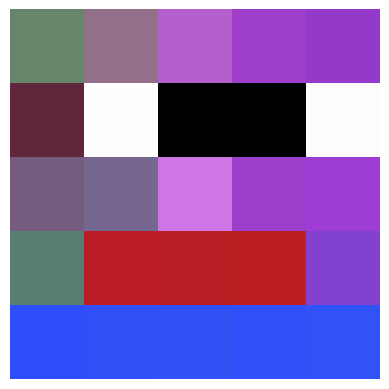

32399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


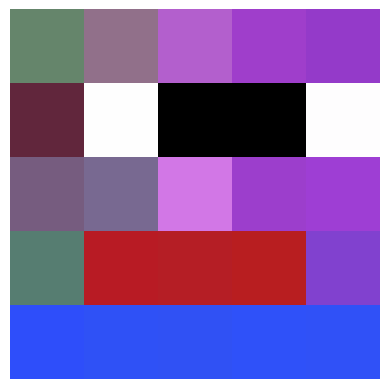

32499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


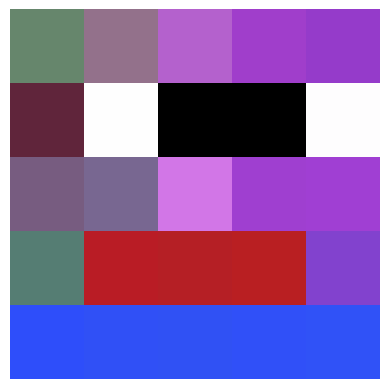

32599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


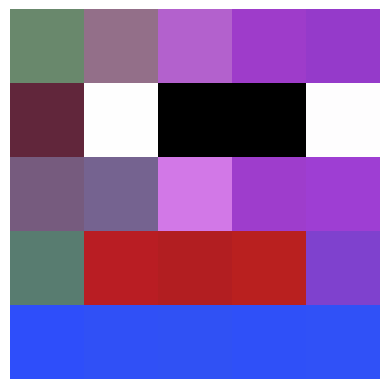

32699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


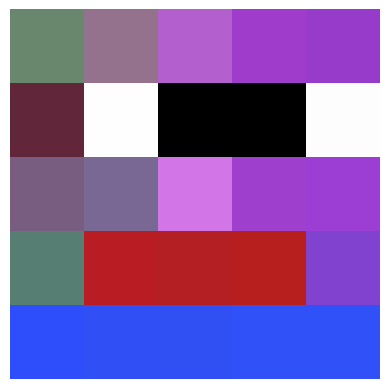

32799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


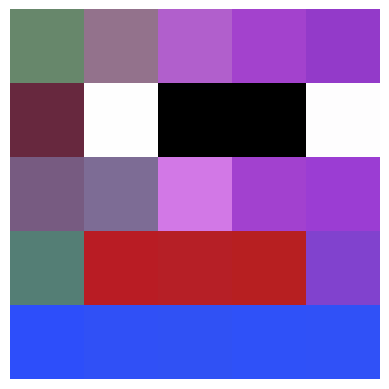

32899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


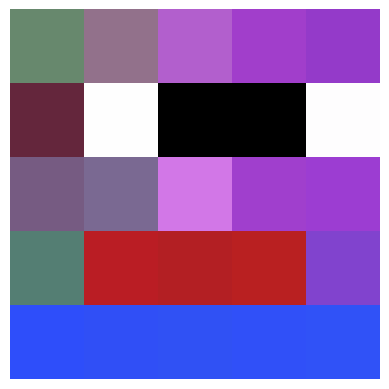

32999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


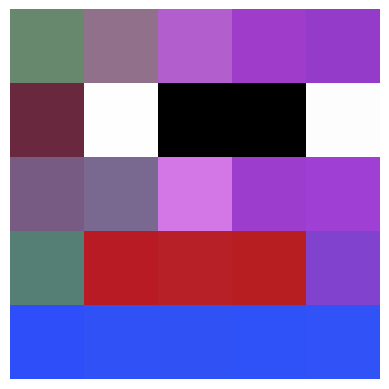

33099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


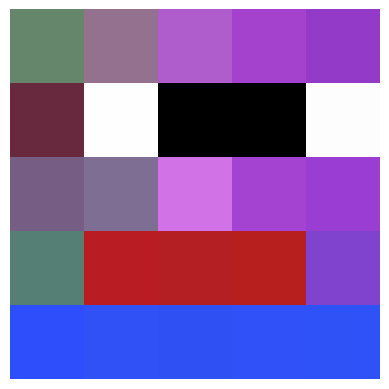

33199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


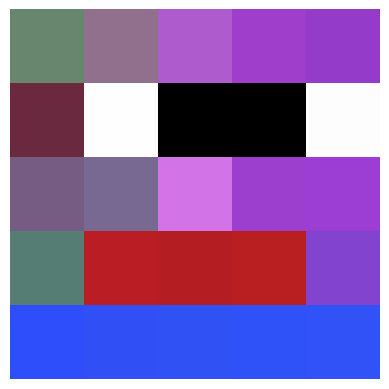

33299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


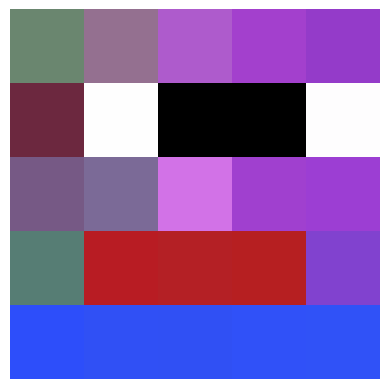

33399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


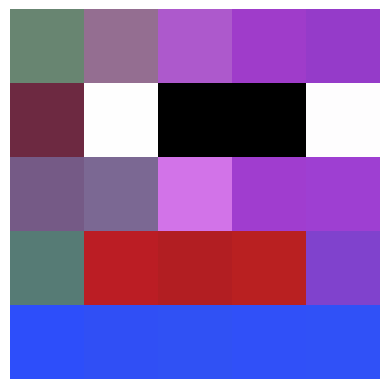

33499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


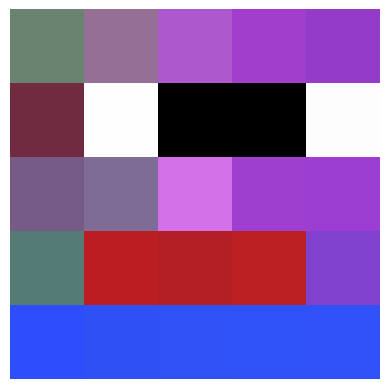

33599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


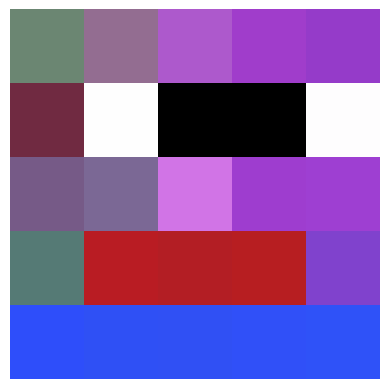

33699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


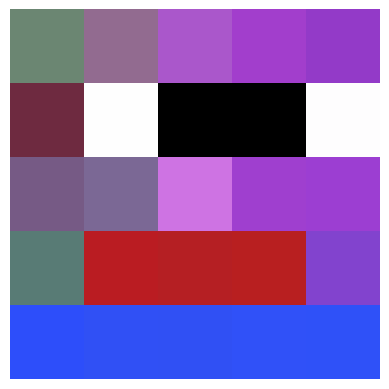

33799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


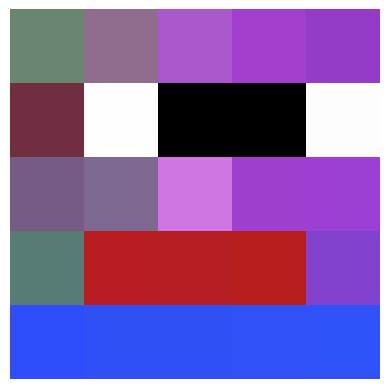

33899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


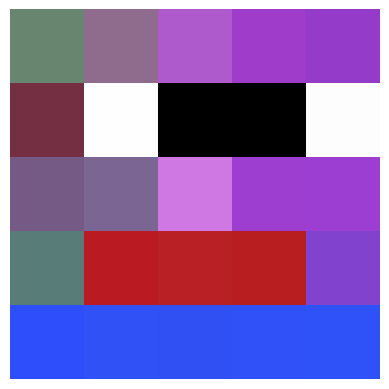

33999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


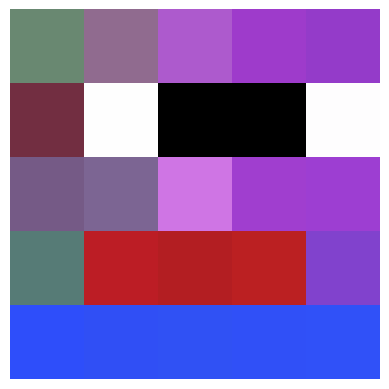

34099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


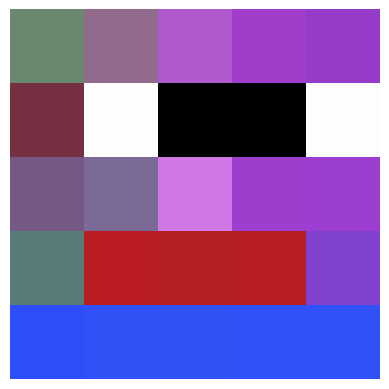

34199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


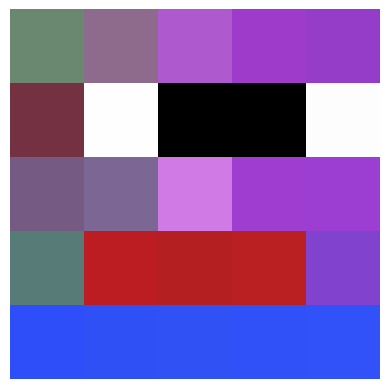

34299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


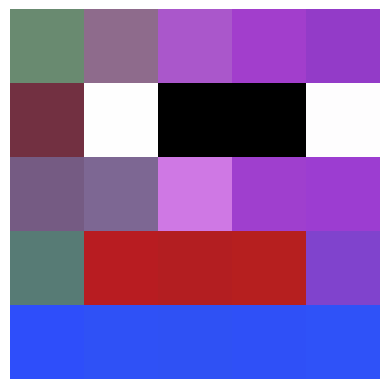

34399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


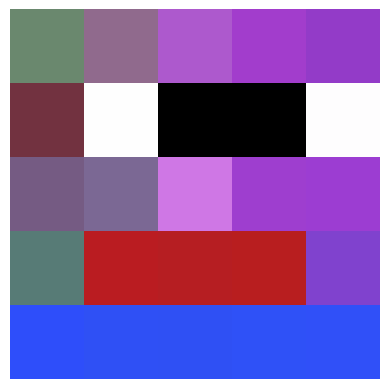

34499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


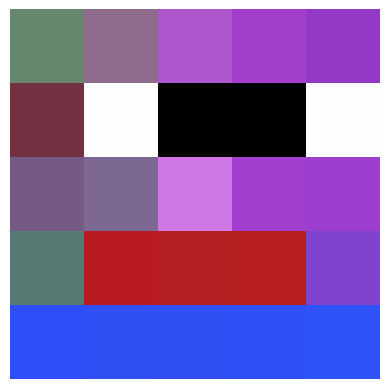

34599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


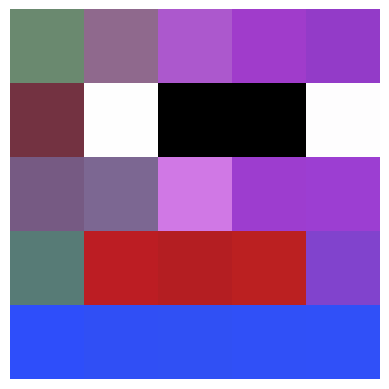

34699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


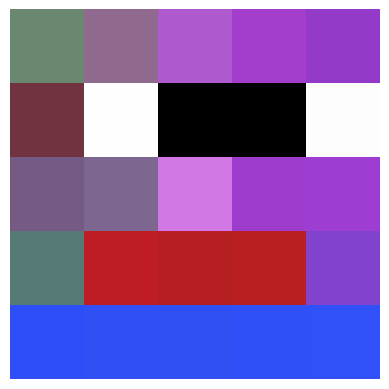

34799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


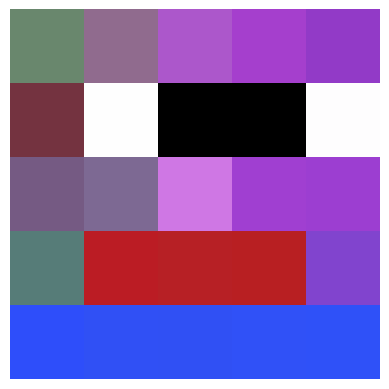

34899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


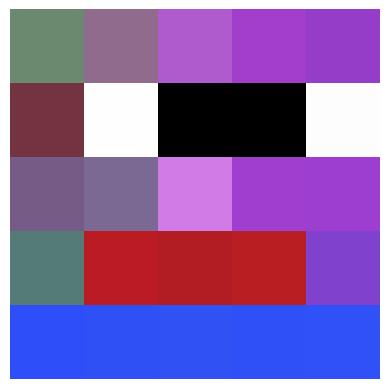

34999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


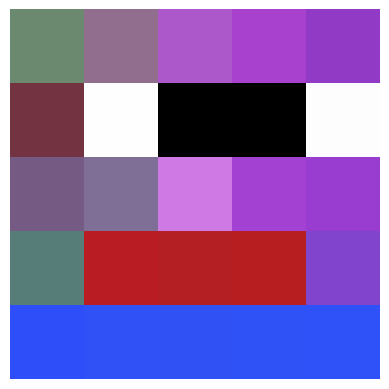

35099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


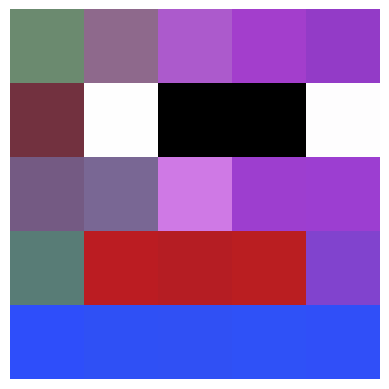

35199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


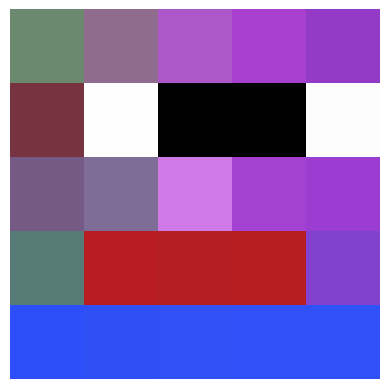

35299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


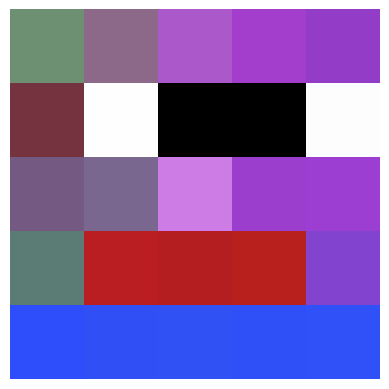

35399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


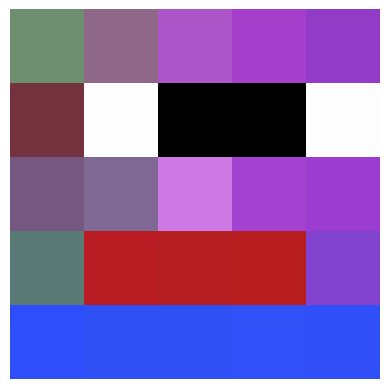

35499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


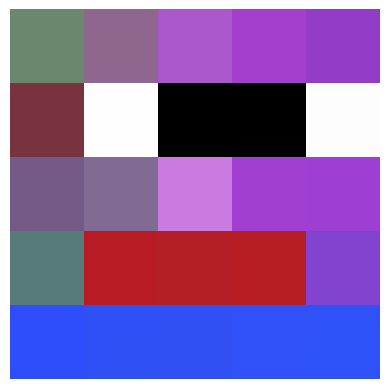

35599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


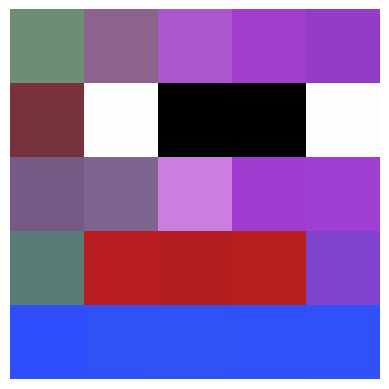

35699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


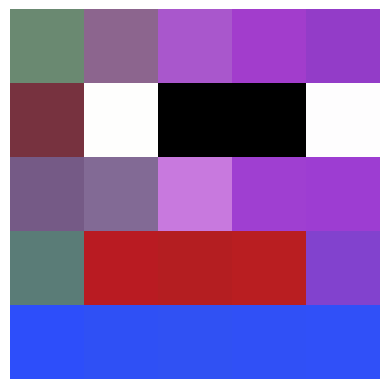

35799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


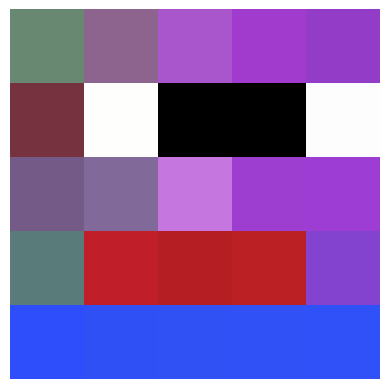

35899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


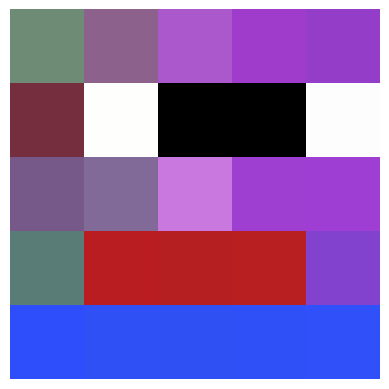

35999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


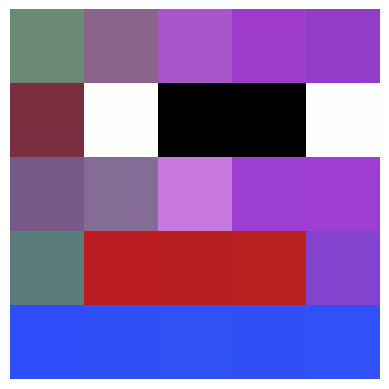

36099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


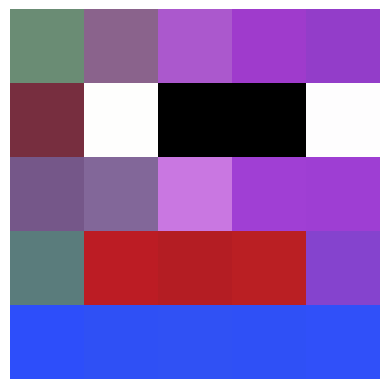

36199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


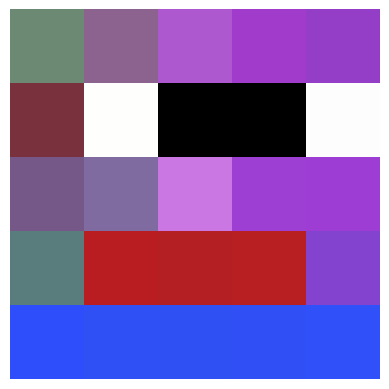

36299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


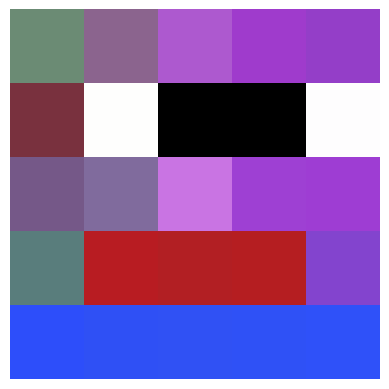

36399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


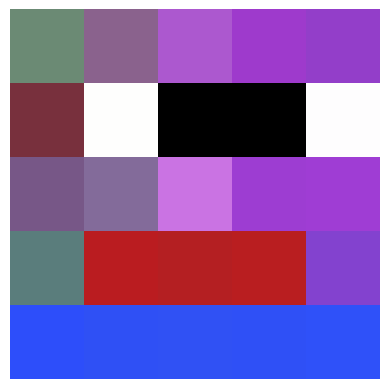

36499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


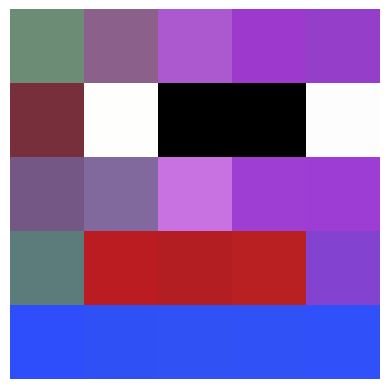

36599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


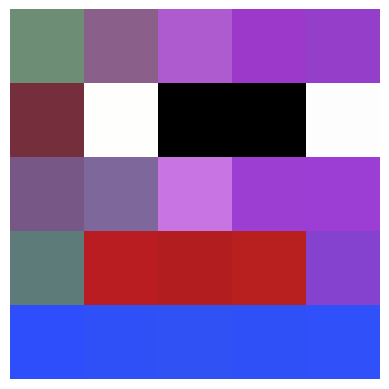

36699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


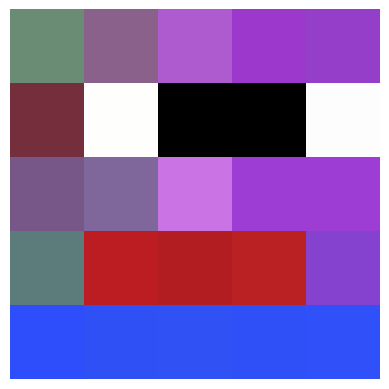

36799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


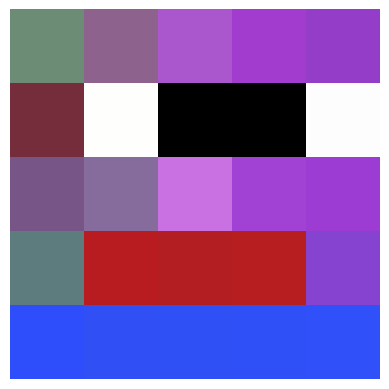

36899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


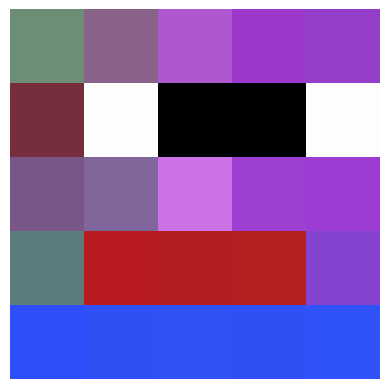

36999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


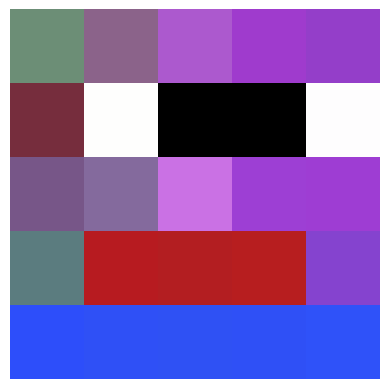

37099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


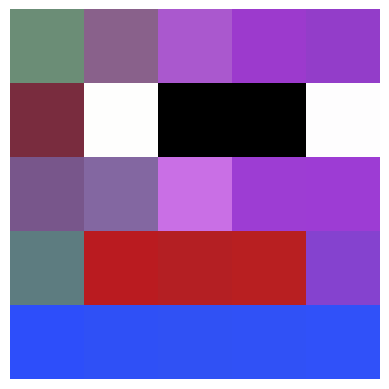

37199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


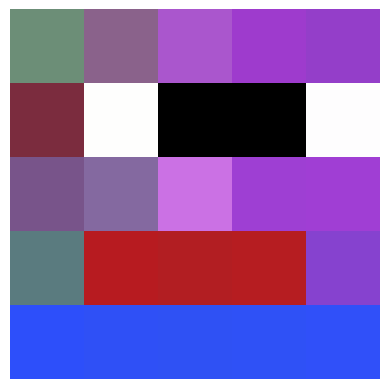

37299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


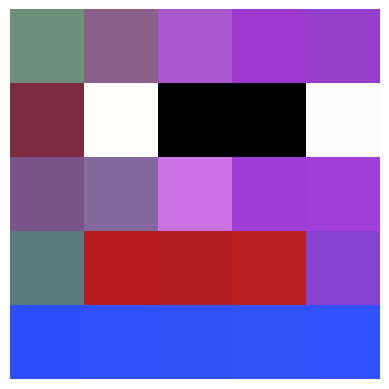

37399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


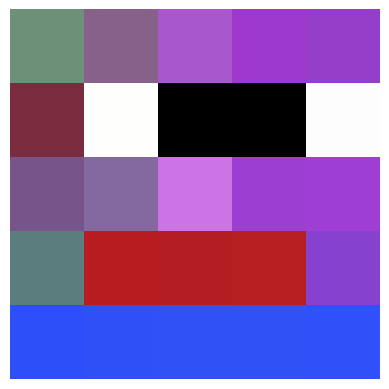

37499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


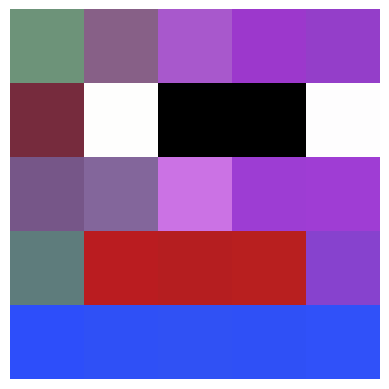

37599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


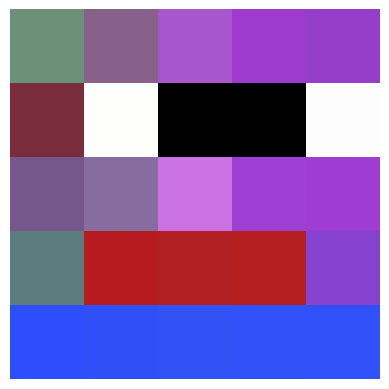

37699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


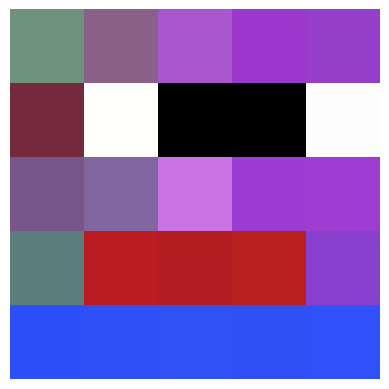

37799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


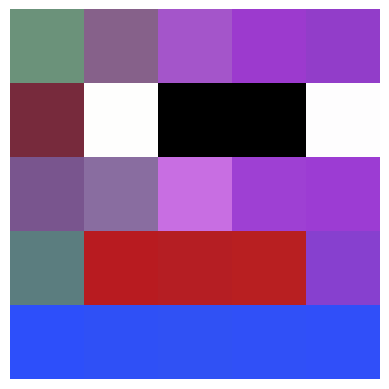

37899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


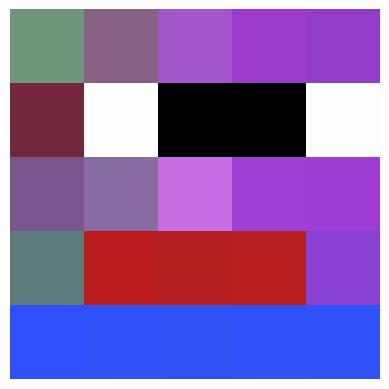

37999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


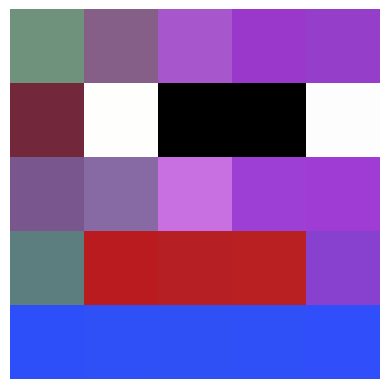

38099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


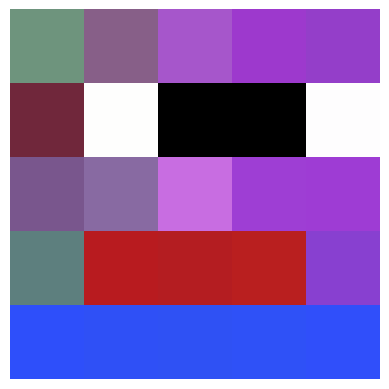

38199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


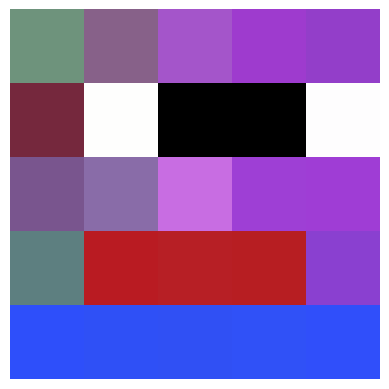

38299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


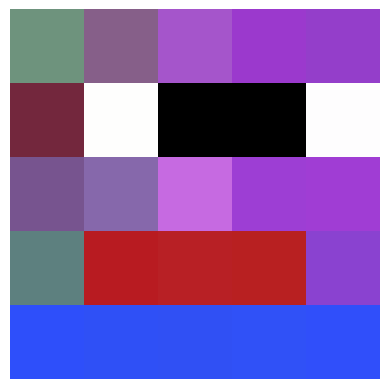

38399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


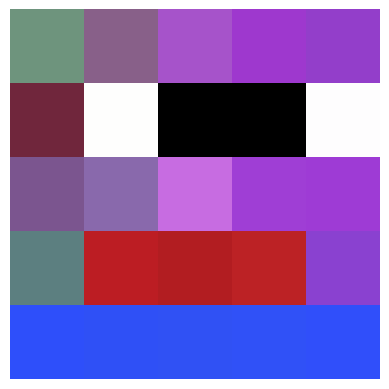

38499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


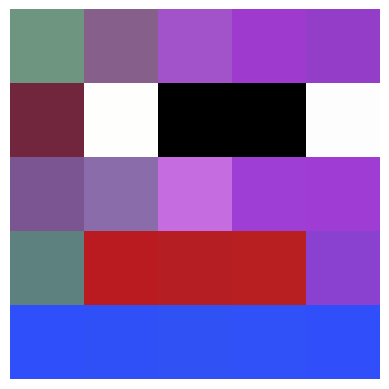

38599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


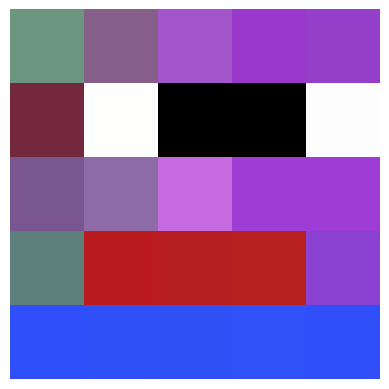

38699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


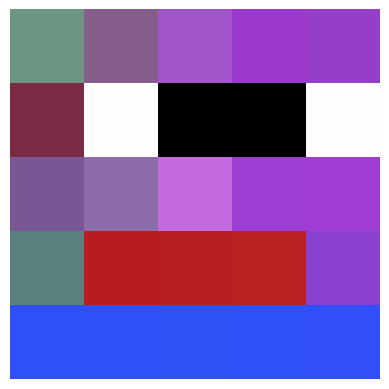

38799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


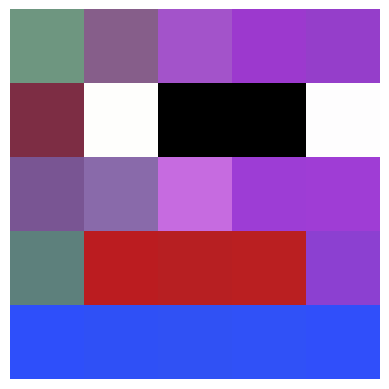

38899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


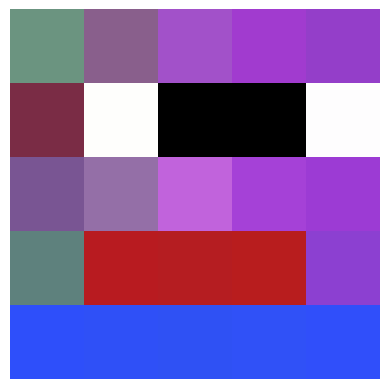

38999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


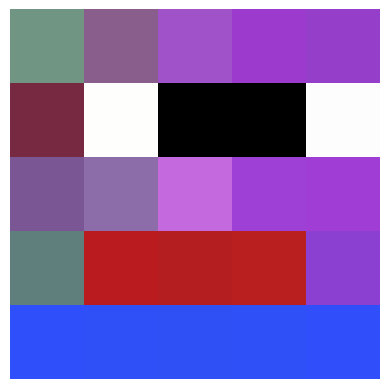

39099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


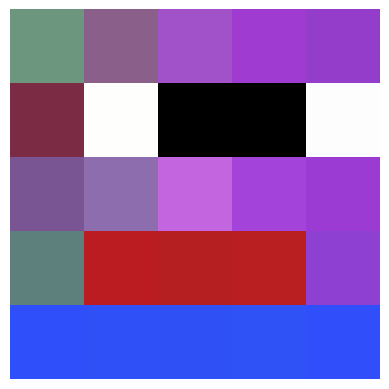

39199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


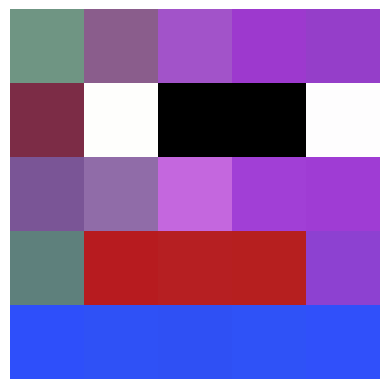

39299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


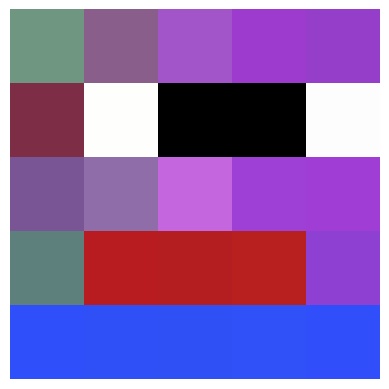

39399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


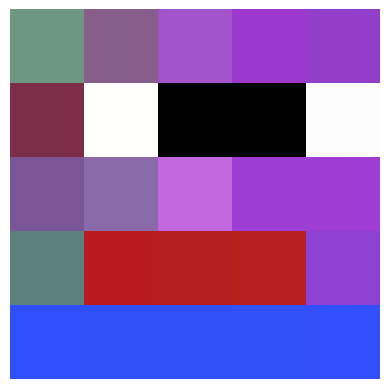

39499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


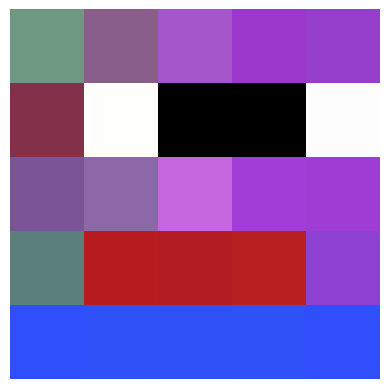

39599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 19ms/step


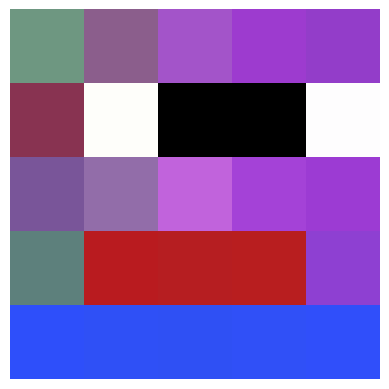

39699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


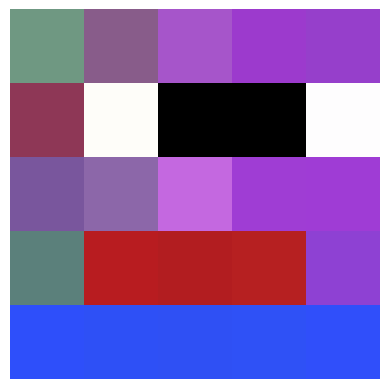

39799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


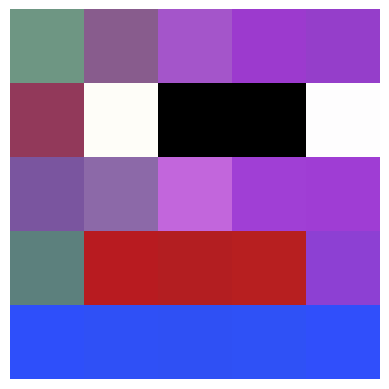

39899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


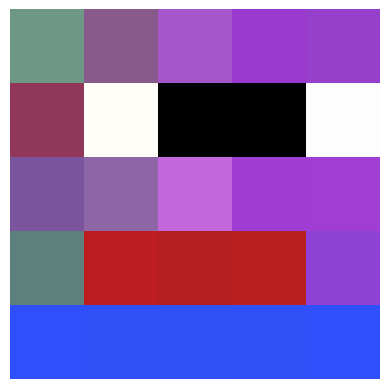

39999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


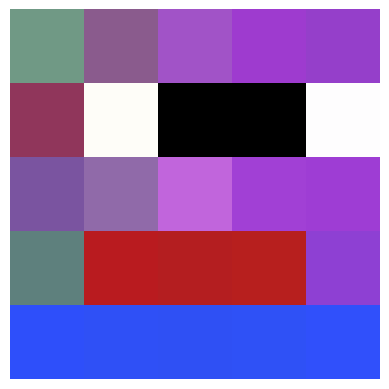

40099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


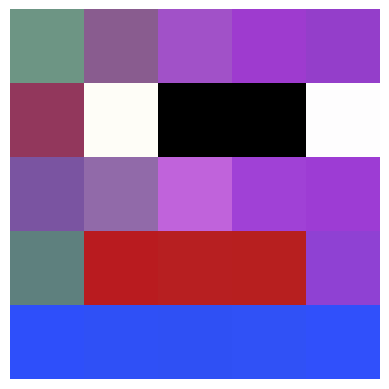

40199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


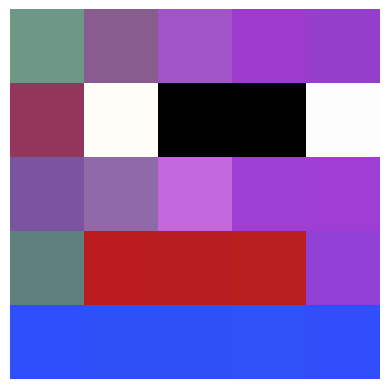

40299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


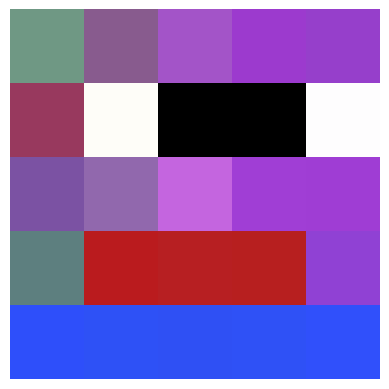

40399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


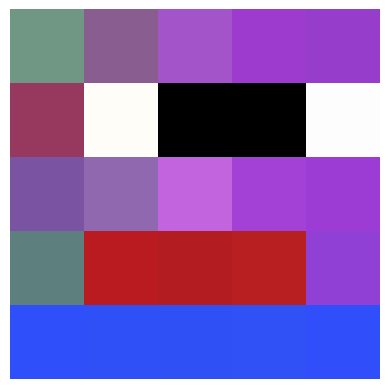

40499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


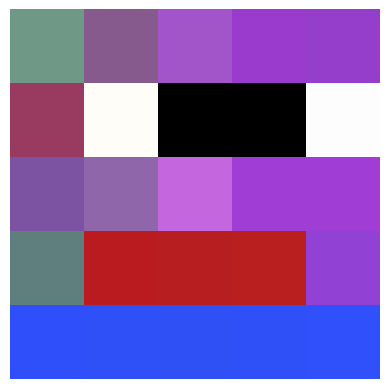

40599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


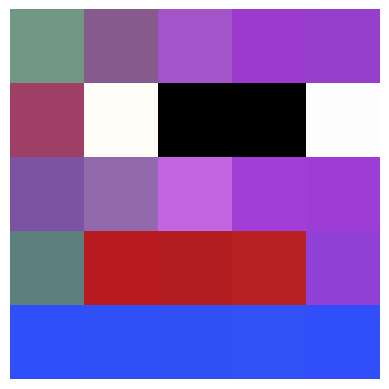

40699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


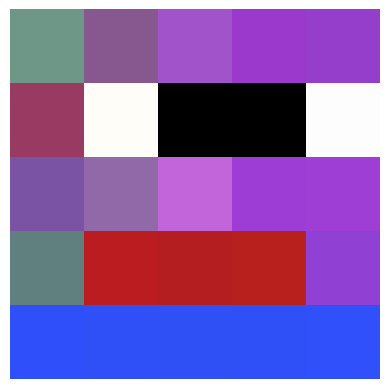

40799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


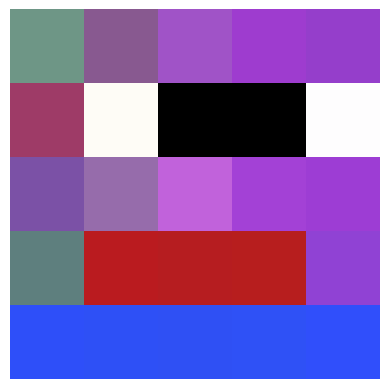

40899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


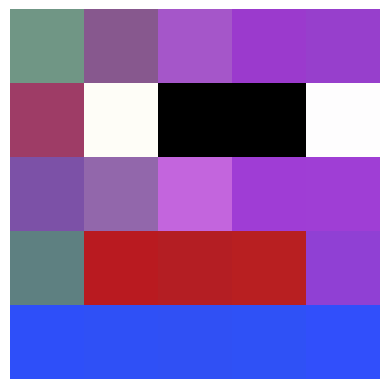

40999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


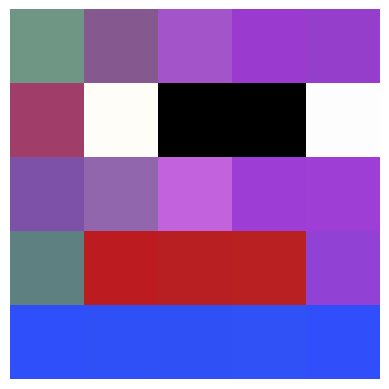

41099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


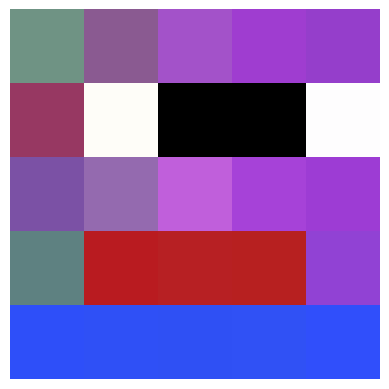

41199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


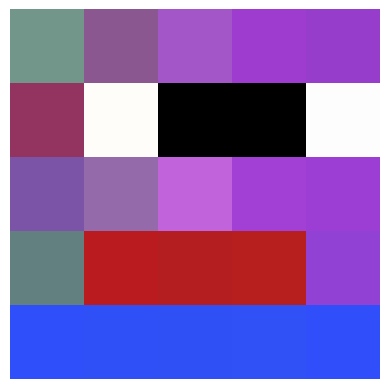

41299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


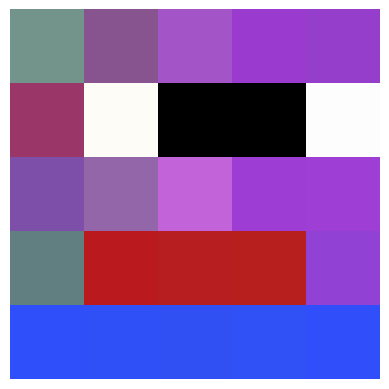

41399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


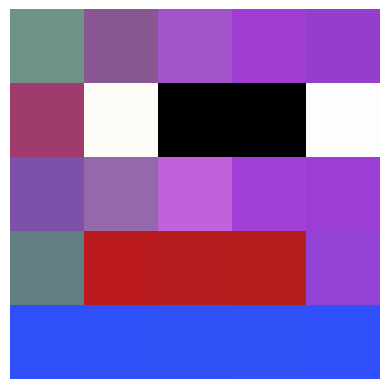

41499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


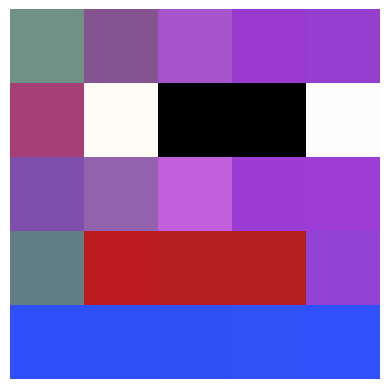

41599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


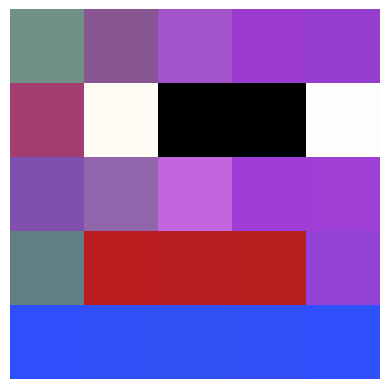

41699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


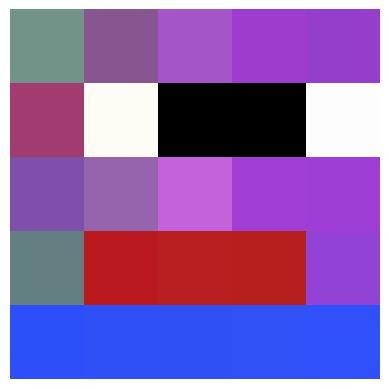

41799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


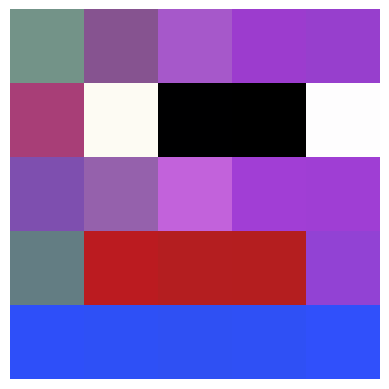

41899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


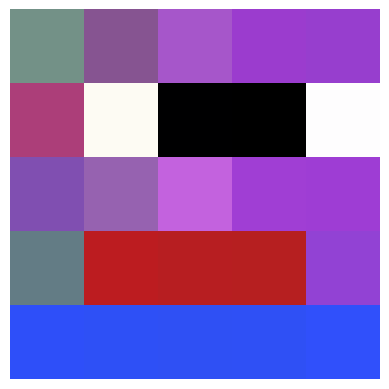

41999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


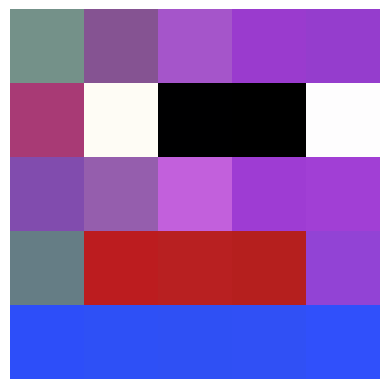

42099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


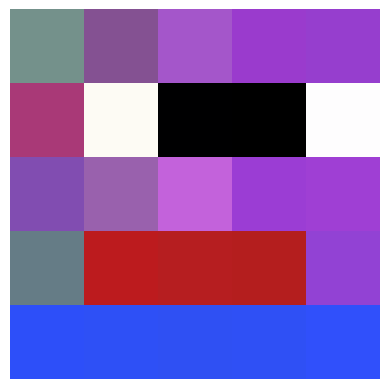

42199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


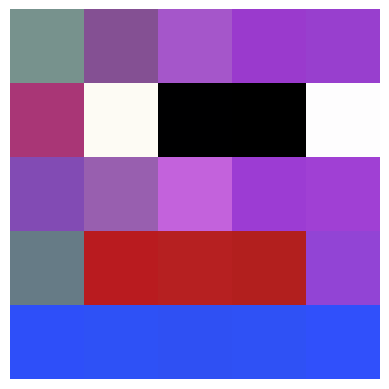

42299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


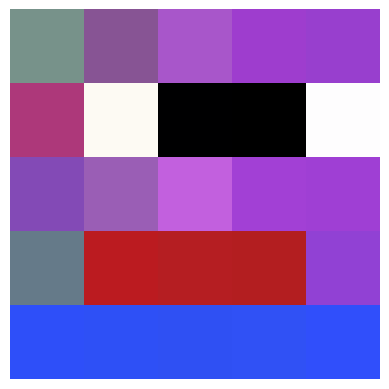

42399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


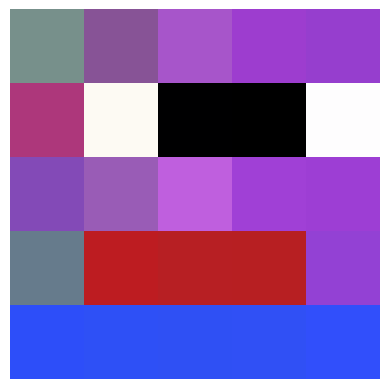

42499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


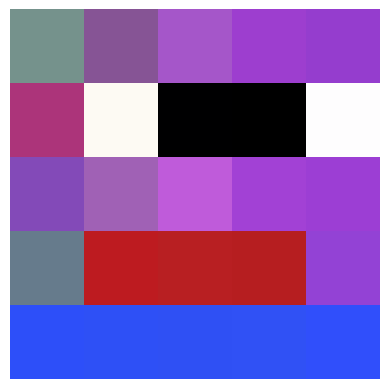

42599>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


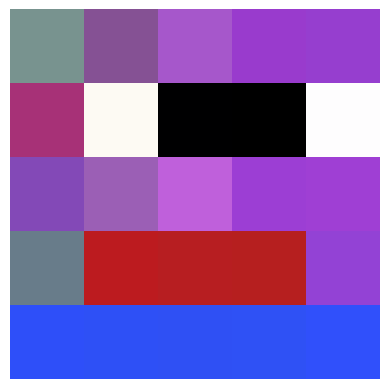

42699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


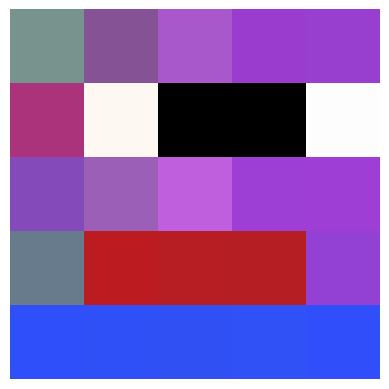

42799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


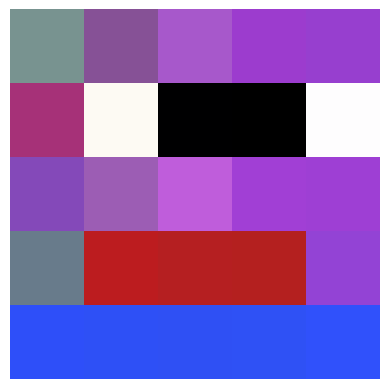

42899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


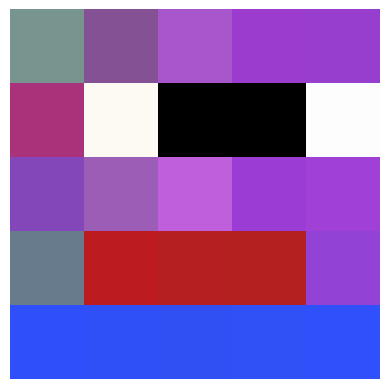

42999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


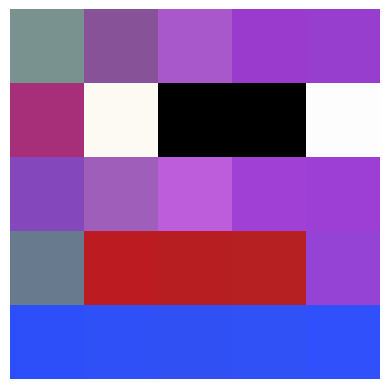

43099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


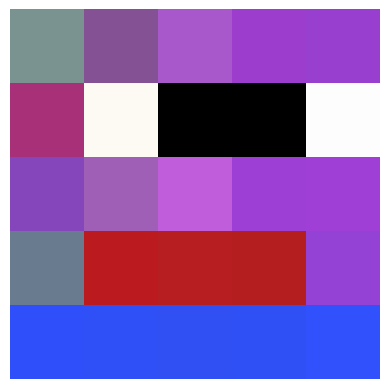

43199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


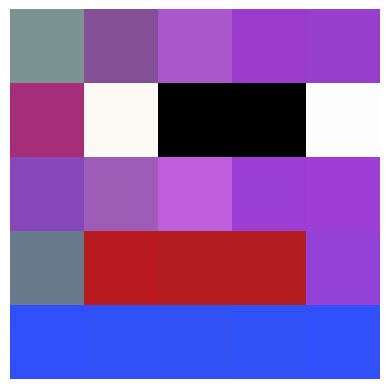

43299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


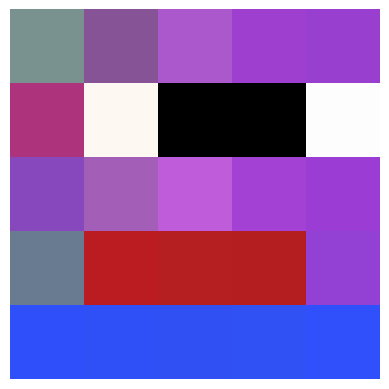

43399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


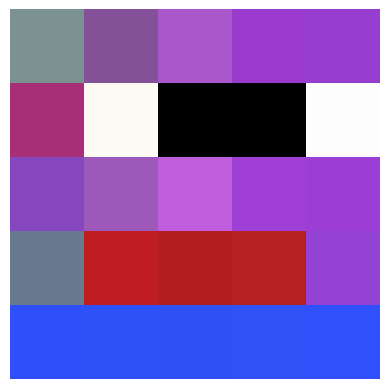

43499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


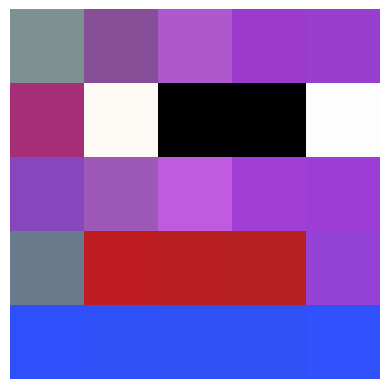

43599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


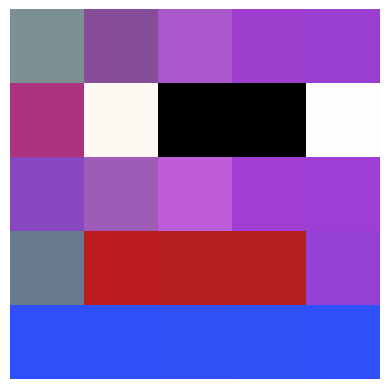

43699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


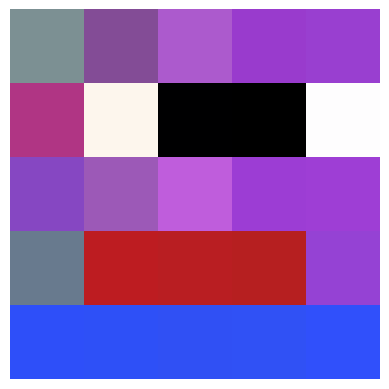

43799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


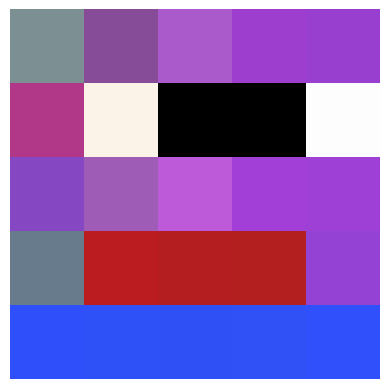

43899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


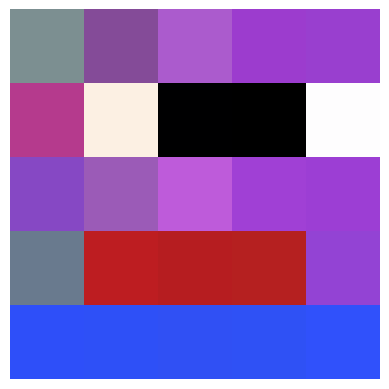

43999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


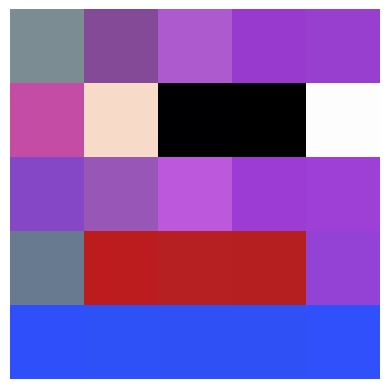

44099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


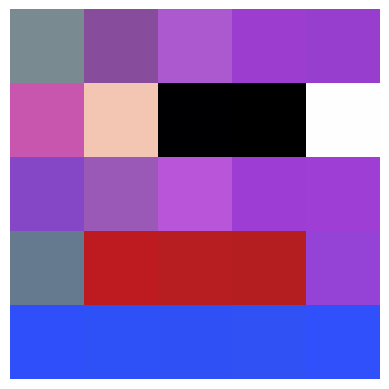

44199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


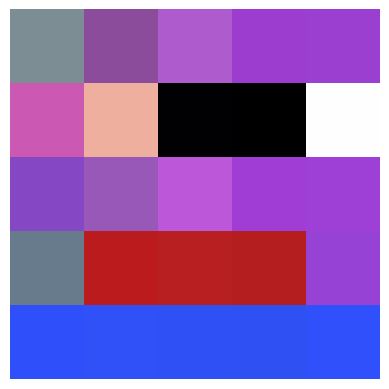

44299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 20ms/step


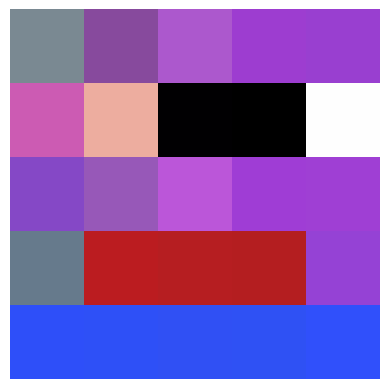

44399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


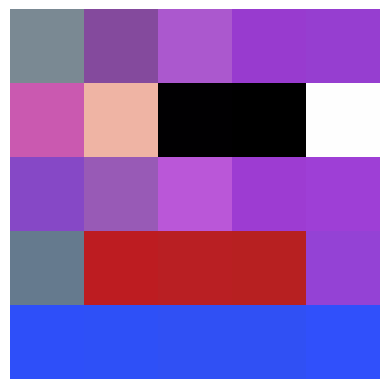

44499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


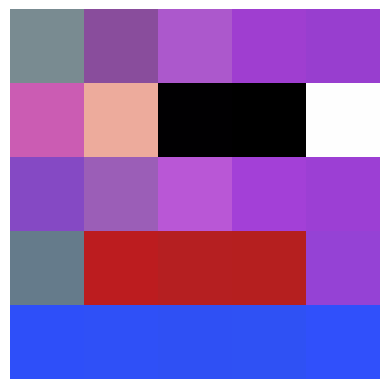

44599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


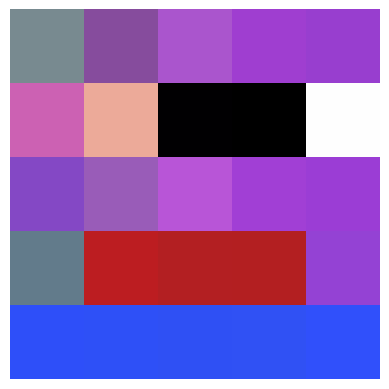

44699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


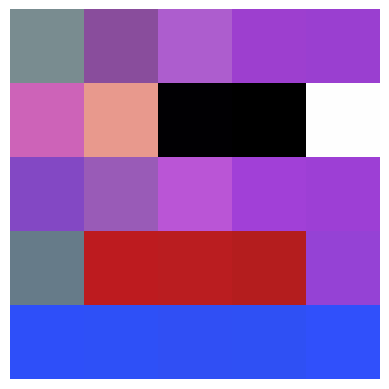

44799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


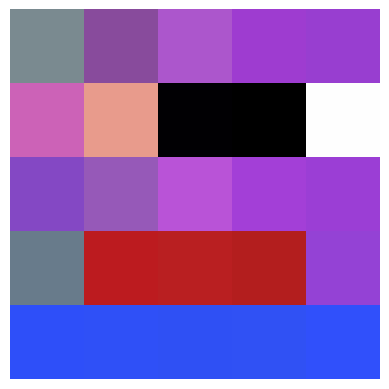

44899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


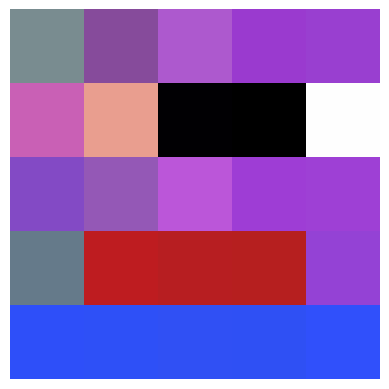

44999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 17ms/step


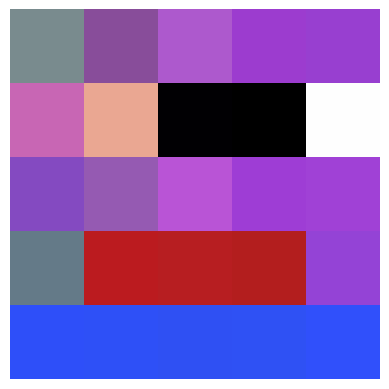

45099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


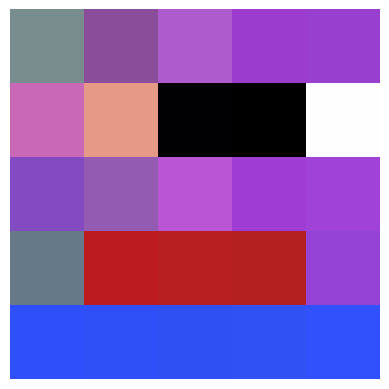

45199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


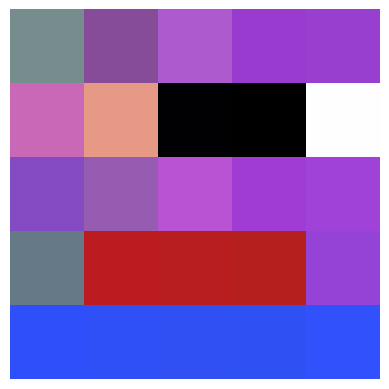

45299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


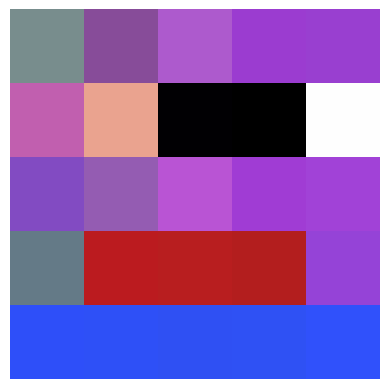

45399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


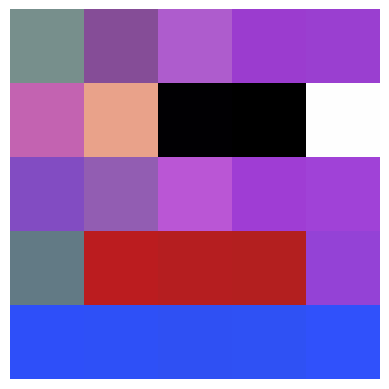

45499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


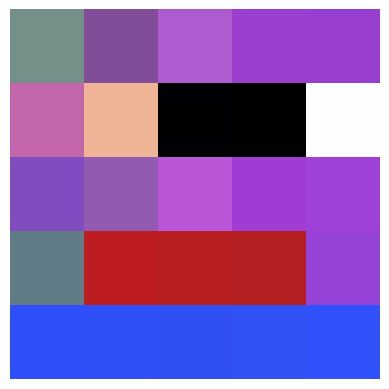

45599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


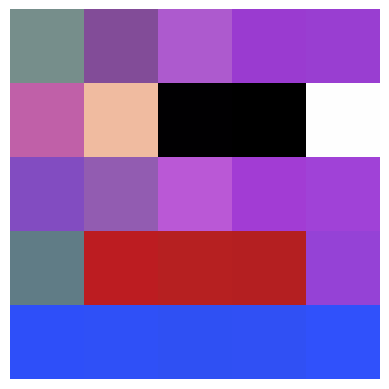

45699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


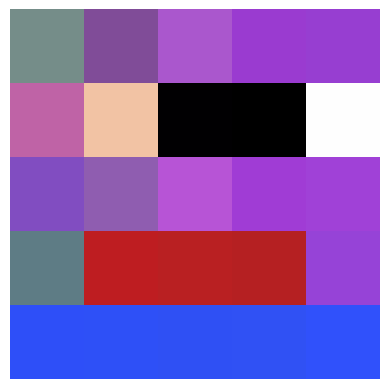

45799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


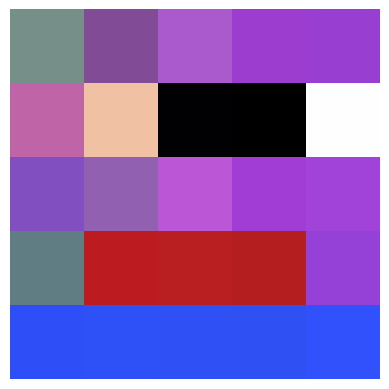

45899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


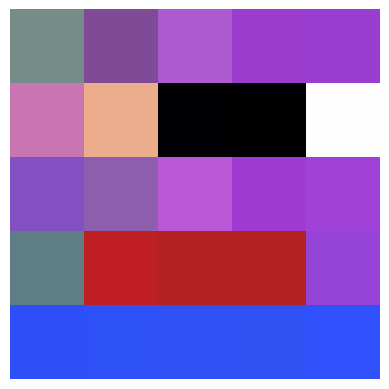

45999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 20ms/step


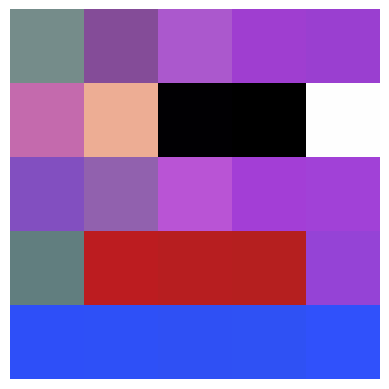

46099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


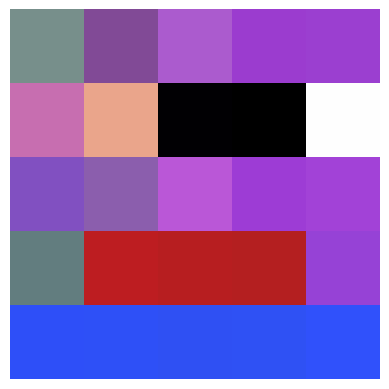

46199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


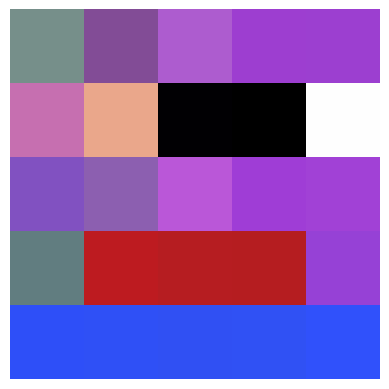

46299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 20ms/step


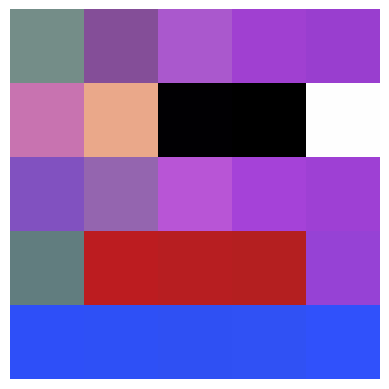

46399>Accuracy real: 99%, fake: 100%
1/1 [==============================] - 0s 15ms/step


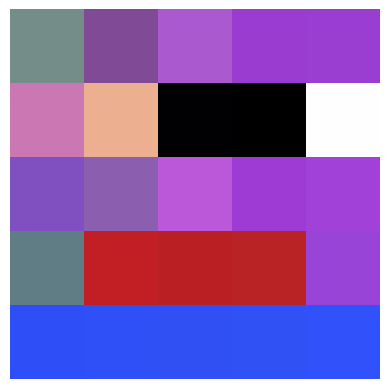

46499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 18ms/step


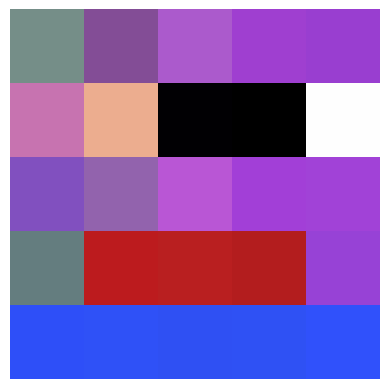

46599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


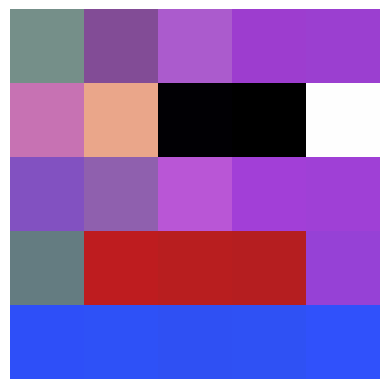

46699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


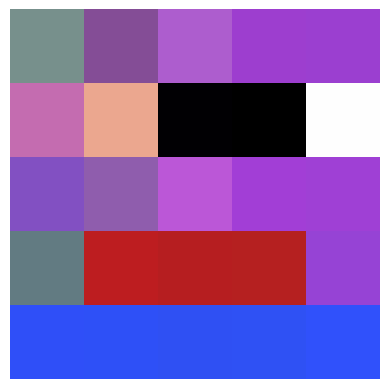

46799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


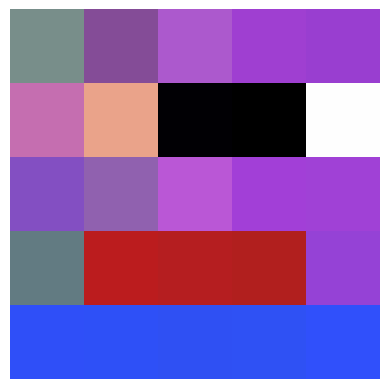

46899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


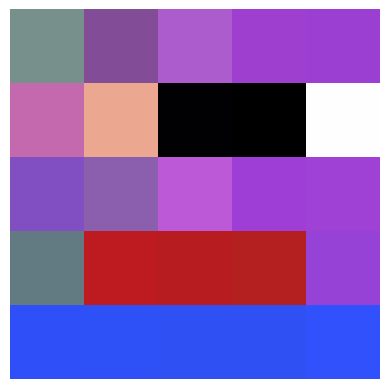

46999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


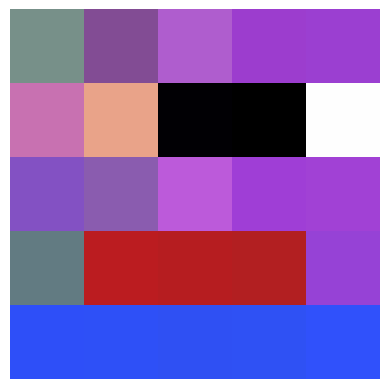

47099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


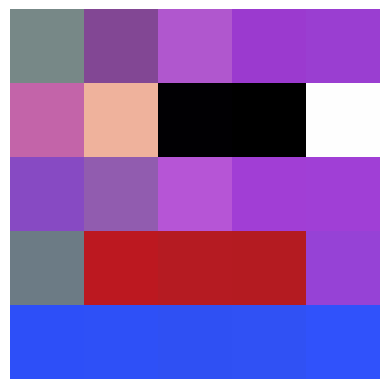

47199>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


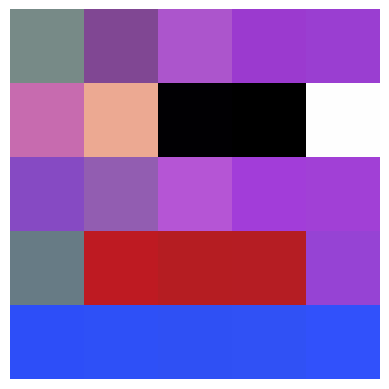

47299>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 13ms/step


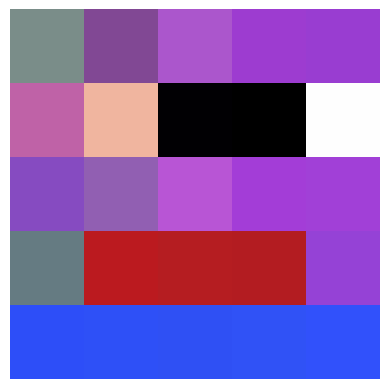

47399>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


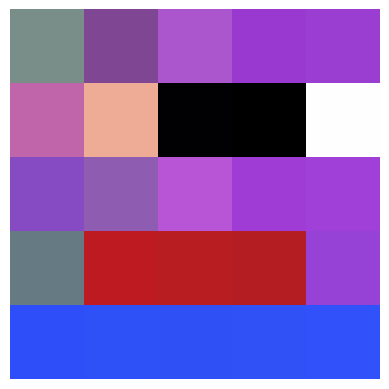

47499>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 12ms/step


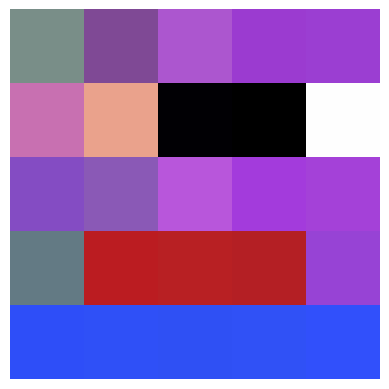

47599>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 14ms/step


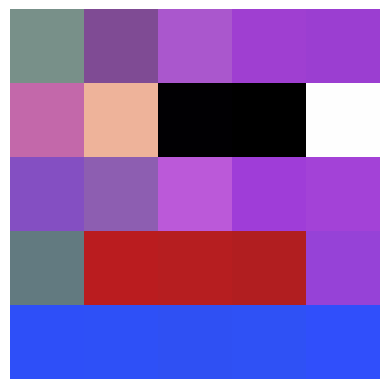

47699>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


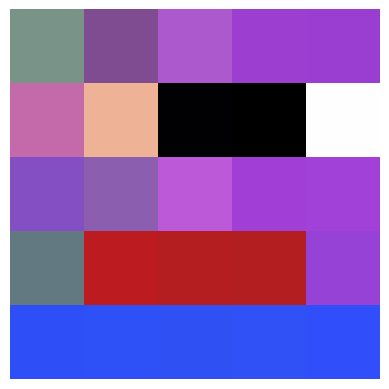

47799>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 15ms/step


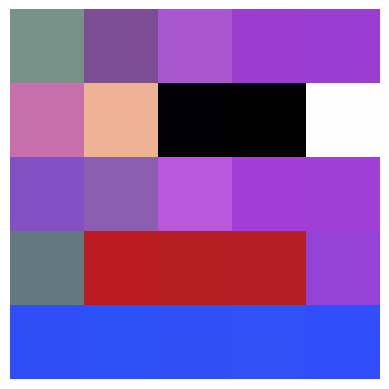

47899>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


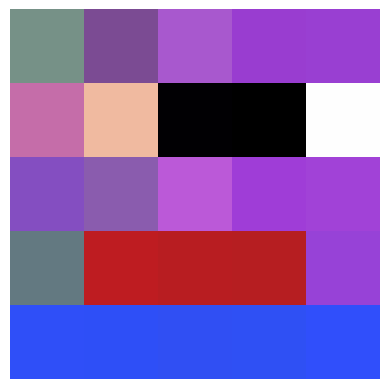

47999>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


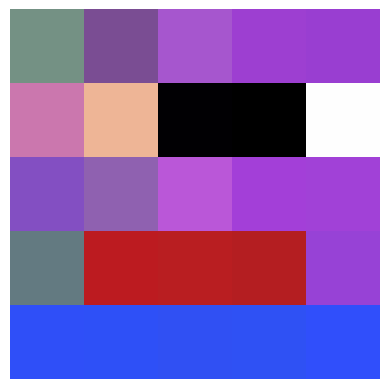

48099>Accuracy real: 100%, fake: 100%
1/1 [==============================] - 0s 16ms/step


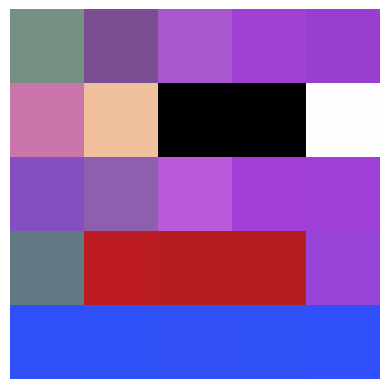


KeyboardInterrupt



In [14]:
train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=100000, n_batch=dataset.shape[0])

# Prediction

In [18]:
import PIL
import imageio
import glob

# Display a single image using the epoch number
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('output/*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        if len(filename) != 33:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

/tmp/ipykernel_2983141/1231988735.py:14: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipykernel_2983141/1231988735.py:16: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



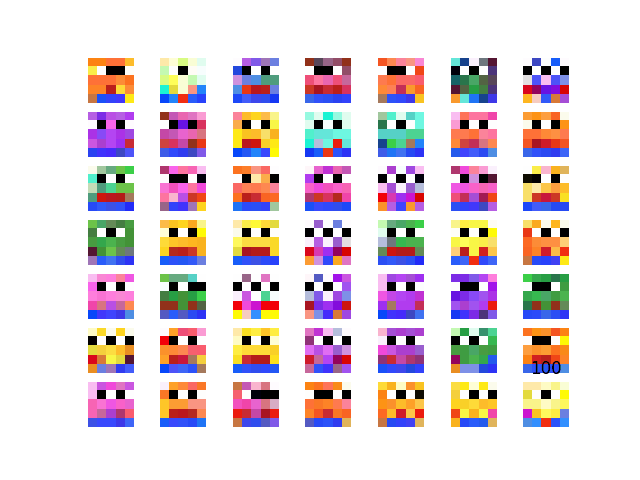

In [19]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

1/1 [==============================] - 0s 18ms/step


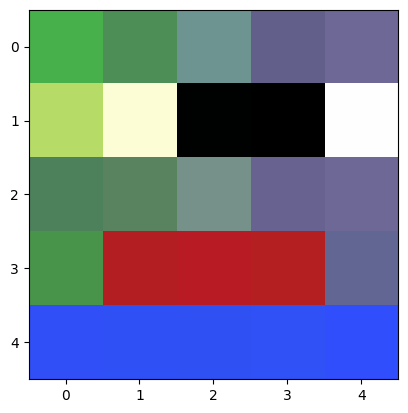

In [22]:
prediction = g_model.predict(asarray([rand(16)]))
plt.imshow(prediction[0])

# Move to solidity

In [2]:
# Change to tf lite with smaller size of weights
import tensorflow as tf
new_model = tf.keras.models.load_model('output_first_train/generator_model_28000.h5')

2023-02-26 22:55:08.705165: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-26 22:55:08.709784: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-26 22:55:08.709992: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-26 22:55:08.710412: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorF

2023-02-26 22:55:18.542070: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8100


1/1 [==============================] - 1s 1s/step


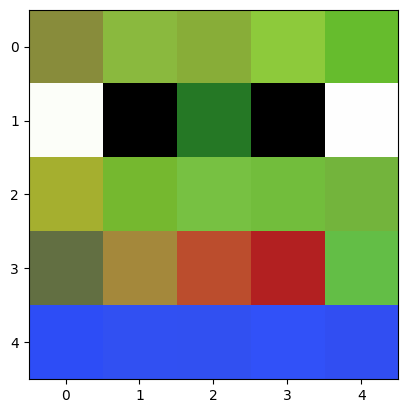

In [3]:
from numpy.random import randn
import matplotlib.pyplot as plt
d = new_model.predict(randn(1, 16))[0]
plt.imshow(d)

In [4]:
'''
+-(1bit)
3 bit (0~3)
12 bits decimal (1/4096 precision.)

addition and subscrtacion -> same
multiplication: int16(x) * int16(y) >> 5
division: (int16(x) << 5) / int16(y)
'''
print(16 * 96, 4 * 96, 2 * 2 * 24 * 12, 4 * 12, 2 * 2 * 12 * 3)
new_model.summary()

1536 384 1152 48 144
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 96)                1536      
                                                                 
 batch_normalization_2 (Batc  (None, 96)               384       
 hNormalization)                                                 
                                                                 
 reshape_1 (Reshape)         (None, 2, 2, 24)          0         
                                                                 
 conv2d_transpose_2 (Conv2DT  (None, 4, 4, 12)         1152      
 ranspose)                                                       
                                                                 
 batch_normalization_3 (Batc  (None, 4, 4, 12)         48        
 hNormalization)                                                 
                                 

In [5]:
def tohex(val):
    val = round(val * 4096)
    s = hex(val & (2**16-1))[2:]
    return "0" * (4 - len(s)) + s

def twos_complement(hexstr, bits):
    value = int(hexstr, 16)
    if value & (1 << (bits - 1)):
        print(1 << bits)
        value -= 1 << bits
    return value

def to_int16(val, to_multiply=4096):
    return str(round(val * to_multiply))

In [6]:
import numpy as np
for i in range(6):
    a = np.array(new_model.layers[i].weights)
    try:
        print(i, a.min(), a.max())
    except:
        pass

0 -0.4055542 0.424864
1 -0.7268663 1.8297343
3 -0.8085463 0.39679134
4 -0.589057 2.0528924
5 -1.6660508 1.2256742


In [7]:
input_ = randn(1, 16)
input_ = np.array([[0.75] * 16])
input_.shape

(1, 16)

In [8]:
input_ * 4096

array([[3072., 3072., 3072., 3072., 3072., 3072., 3072., 3072., 3072.,
        3072., 3072., 3072., 3072., 3072., 3072., 3072.]])

### Layer 1 Dense

In [9]:
import numpy as np
output1 = np.array(new_model.layers[0](input_))
output1.shape

(1, 96)

In [22]:
weights = np.array(new_model.layers[0].weights)
weights.shape

(1, 16, 96)

In [18]:
# layerOneWeights[i*16 + j] = weights[i][j]
for i in range(0, len(weights[0]), 2):
    print("contract.setWeights([{}], 0);".format(
        ", ".join([to_int16(elem) for elem in weights[0][i]] + [to_int16(elem) for elem in weights[0][i+1]])
    ))

contract.setWeights([312, 252, 149, 565, -632, -361, 263, -233, 129, 355, -294, -1167, 560, 77, 122, 72, 1341, 1166, 1111, 1001, 949, 142, 161, -198, 198, -229, -215, 1440, -216, 278, -294, 1011, -165, 1220, -272, 201, 1460, 453, -195, -157, 947, 1740, 359, 277, 1501, -215, -184, -63, 421, -202, 757, 627, 155, 595, -250, 177, 364, 522, -176, 292, 531, 1015, 1353, 136, 319, 770, 120, 331, 1506, -268, 100, -247, 77, 307, -128, 1139, -152, 273, 1400, 274, -97, 285, -227, -157, 1211, -154, -148, -258, 1123, 1205, 333, 289, 535, 1173, 271, 1609, 225, 398, 423, -51, 329, -265, 380, -84, 415, 348, -297, 369, -605, -445, 418, -322, -279, -485, -427, -361, -336, 379, 470, -244, 270, 478, 456, -282, 537, -335, 593, -192, 462, -464, -316, 310, -378, 37, 394, -282, -392, -638, -535, -365, -368, 414, 368, -330, 296, -251, 358, 316, 483, 291, -282, 403, 519, 281, -219, 436, 349, -397, -527, 436, 486, 358, 64, 495, -591, -288, 78, -301, 238, 233, 357, -409, 427, 233, -545, 220, 426, 234, -259, 480, -

### Layer 1 batch normalization

In [25]:
# gamma * (batch - self.moving_mean) / sqrt(self.moving_var+epsilon) + beta
# gamma, beta, moving_mean, moving_var, epsilon=0.001
output2 = np.array(new_model.layers[1](output1))
output2.shape

(1, 96)

In [26]:
weights = np.array(new_model.layers[1].weights)
weights.shape

(4, 96)

In [17]:
coeff = weights[0] / np.sqrt(weights[3] + 0.001)
# Gamma
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in coeff]), 1
))
# Moving mean
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in weights[2]]), 2
))
# Beta
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in weights[1]]), 3
))

contract.setWeights([9264, 20459, 20098, 1692, 1219, 1058, 3822, 667, 12029, 7006, 6470, 1270, 6745, 6101, 20706, 10486, 2591, 11569, 13981, 16342, 18385, 28524, 19100, 9086, 25671, 23971, 18486, 3640, 6691, 1555, 10773, 1301, 7568, 5899, 13830, 16447, 15136, 1190, 21383, 10367, 3227, 12041, 3133, 4440, 12499, 26808, 29108, 1998, 14632, 4517, 7667, 12444, 10006, 18055, 3234, 13465, 13012, 10892, 10714, 9804, 7647, 19131, 8385, 10412, 17765, 7611, 2700, 5962, 9324, 1113, 660, 6047, 1296, 2195, 4109, 2257, 7899, 9789, 13278, 17000, 10477, 13171, 17186, 11102, -54, 9284, 6425, 8583, 1668, 7037, 10324, 15460, 73, 6483, 3756, 7299],1);
contract.setWeights([601, 746, 750, 493, 879, 556, 717, 807, 720, 756, 859, 767, 1021, 804, 725, 555, 810, 865, 801, 684, 642, 689, 821, 701, 749, 891, 864, 929, 989, 655, 1092, 609, 916, 858, 927, 845, 920, 814, 744, 752, 702, 1200, 890, 638, 940, 768, 689, 658, 793, 727, 1070, 976, 806, 853, 819, 706, 982, 787, 648, 818, 938, 723, 962, 725, 899, 1088, 679, 

### Layer 1 Reshape

In [30]:
# weights[i][j][k] = weights_[i * 3 * 48 + j * 48 + k]
output3 = np.array(new_model.layers[2](output2))
output3.shape

(1, 2, 2, 24)

### Layer 2 Conv with 2x2 matrix, output channel = 12

In [31]:
output4 = np.array(new_model.layers[3](output3))
output4.shape, new_model.layers[3].weights[0].shape

((1, 4, 4, 12), TensorShape([2, 2, 12, 24]))

In [37]:
coeff = np.array(new_model.layers[3].weights[0]).flatten()
#coeff[((i * 2 + j) * 12 + k) * 24 + l]
l = len(coeff) // 2
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in coeff[:l]]), 4
))
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in coeff[l:]]), 4
))

contract.setWeights([-314, -348, -276, 103, 225, -327, 324, -292, -467, -112, 32, 225, 439, -887, 633, -100, 92, -314, 101, 170, -326, -808, 313, -46, 186, 1016, 51, -957, -1427, 651, 467, 751, -388, -268, 130, -137, -450, 457, 995, 351, -92, 663, -953, 542, 683, -626, -1117, 468, -216, 295, -51, -251, 84, 589, 144, 43, -177, -391, 188, 498, 4, -121, -314, 312, -241, -379, -336, 22, -269, -247, 385, 435, 115, -299, 261, 234, -38, 66, -279, 126, -48, -451, -38, -90, -46, -173, -610, 10, 126, -210, -60, -171, 252, -145, 172, 533, -319, 417, 52, 288, 67, -1196, -118, -1147, -3312, 137, -316, -156, 445, 599, 343, 476, 496, 390, 296, 217, -1363, -248, 93, 42, -353, 486, -752, 1289, -244, 639, 52, 355, 3, -472, -165, -119, -127, 46, 746, 172, -39, 109, 1200, -1371, -303, -560, -26, 42, -380, 428, 673, 312, -570, 9, -339, 2, -233, -616, -67, 332, 201, -57, 220, 38, 118, -399, -51, -73, -47, -796, -293, 632, -350, -684, 1042, -623, 220, 159, -377, -124, -103, -56, -1048, -62, 253, 37, -790, -1

### Layer 2 batch normalization

In [38]:
# gamma * (batch - self.moving_mean) / sqrt(self.moving_var+epsilon) + beta
# gamma, beta, moving_mean, moving_var, epsilon=0.001
output5 = np.array(new_model.layers[4](output4))
output4.shape, output5.shape

((1, 4, 4, 12), (1, 4, 4, 12))

In [39]:
gamma = np.array(new_model.layers[4].weights[0])
beta = np.array(new_model.layers[4].weights[1])
mm = np.array(new_model.layers[4].weights[2])
mv = np.array(new_model.layers[4].weights[3])
#gamma * (output4 - mm) / np.sqrt(mv + 0.001) + beta

In [40]:
coeff = gamma / np.sqrt(mv + 0.001)
# Gamma
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem, 2048) for elem in coeff]), 5
))
# Moving mean
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in mm]), 6
))
# Beta
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in beta]), 7
))

contract.setWeights([11752, 11968, 18264, 15932, 21748, 16132, 14291, 18590, 23804, 14313, 12230, 11355],5);
contract.setWeights([1025, 692, 631, 516, 305, 460, 920, 632, 371, 649, 980, 1359],6);
contract.setWeights([-652, 83, -1767, -460, 180, -1729, -525, -1128, -202, -2413, -1368, 2029],7);


### Layer 3 Conv with 3x3 matrix, output channel=3

In [24]:
output6 = np.array(new_model.layers[5](output5))
output6.shape

(1, 5, 5, 3)

In [36]:
new_model.layers[5].weights[0].shape

TensorShape([2, 2, 3, 12])

In [26]:
coeff = np.array(new_model.layers[5].weights[0]).flatten()
#coeff[((i*2+j)*3+k)*12+l]
print("contract.setWeights([{}],{});".format(
    ", ".join([to_int16(elem) for elem in coeff]), 8
))

contract.setWeights([-3897, 3741, -4551, 3706, -143, -291, -1538, -3269, 310, 1329, -905, 3964, -6824, -3078, -782, 3419, -35, 3453, -4537, -14, 1012, 2984, -3181, 3964, -2037, -1086, 637, 4371, -83, 471, -1523, -3917, 93, 2360, -69, 1480, 3958, 1117, -2900, -3802, 122, 1303, 3029, -1082, 941, -6004, -3911, 2692, 1751, -2702, -1011, -2046, -473, 5020, 641, 3042, 1097, -4820, -3198, 1724, 2108, -1257, 1088, -5428, 63, 1538, 4499, -1625, 441, -2044, -2041, 46, 676, 2142, -176, 7, -306, -277, -979, 445, -120, -234, -290, -1672, 216, 242, -121, -120, -81, 927, 277, -682, -132, 109, -188, -1386, -2928, -1524, 613, 1433, 3, -1217, 3361, 54, 2277, -2028, 2687, 2162, 1388, -459, 231, -312, 3137, 113, -475, -1415, 4418, 94, -330, 2753, 548, -202, 47, -210, -3296, 81, -2466, 1959, 2818, 363, 348, 3031, 308, -1210, 2532, -678, -1523, -756, 2262, -3009, -853, 528, 1716, 2756],8);


# Discrete sigmoid

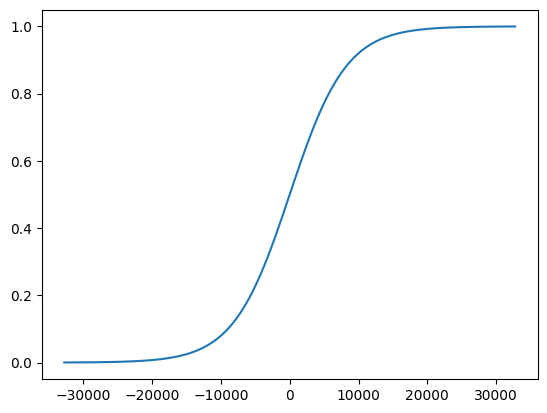

In [28]:
import numpy as np
x = np.arange(-32768, 32768)

import matplotlib.pyplot as plt

plt.plot(x, 1 / (1 + np.exp(-x / 4096)))

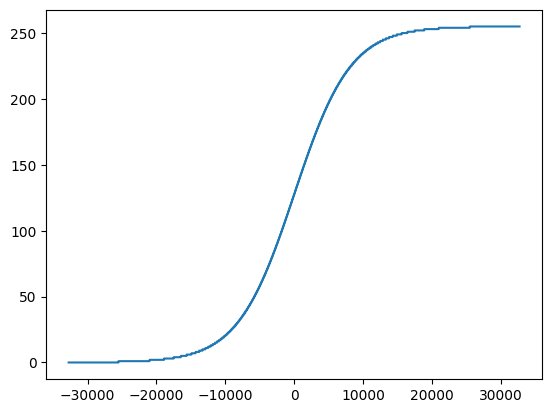

In [29]:
y = np.round(255 / (1 + np.exp(-x / 4096)))
plt.plot(x, y)

In [30]:
last = 0
indices = []
for i, elem in enumerate(y):
    if elem == last:
        indices.append(x[i])
        last += 1

In [31]:
"[" + ",".join([str(elem) for elem in indices]) + "]"

'[-32768,-25528,-21012,-18903,-17509,-16463,-15625,-14924,-14321,-13792,-13320,-12893,-12504,-12145,-11813,-11503,-11213,-10940,-10682,-10437,-10204,-9982,-9769,-9565,-9369,-9181,-8999,-8824,-8654,-8490,-8330,-8176,-8025,-7879,-7736,-7597,-7462,-7329,-7200,-7073,-6949,-6828,-6709,-6592,-6477,-6365,-6254,-6145,-6039,-5934,-5830,-5728,-5628,-5529,-5431,-5335,-5240,-5146,-5054,-4962,-4872,-4783,-4695,-4607,-4521,-4435,-4351,-4267,-4184,-4102,-4021,-3940,-3860,-3781,-3702,-3624,-3547,-3470,-3394,-3318,-3243,-3168,-3094,-3021,-2948,-2875,-2803,-2731,-2659,-2588,-2517,-2447,-2377,-2307,-2238,-2169,-2100,-2032,-1964,-1896,-1828,-1761,-1694,-1627,-1560,-1494,-1427,-1361,-1295,-1229,-1164,-1098,-1033,-968,-903,-838,-773,-708,-643,-579,-514,-450,-385,-321,-257,-192,-128,-64,0,65,129,193,258,322,386,451,515,580,644,709,774,839,904,969,1034,1099,1165,1230,1296,1362,1428,1495,1561,1628,1695,1762,1829,1897,1965,2033,2101,2170,2239,2308,2378,2448,2518,2589,2660,2732,2804,2876,2949,3022,3095,3169,3244

In [32]:
def find_color(x, index_min, index_max):
    if (index_min == index_max):
        if indices[index_min] <= x:
            return index_min
        else:
            return -1
    m = (index_min + index_max) // 2
    if (x < indices[m]):
        return find_color(x, index_min, m)
    ret = find_color(x, m + 1, index_max)
    if ret == -1:
        return m;
    else:
        return ret

In [33]:
from tqdm.notebook import tqdm
for i in tqdm(range(-32768, 32768)):
    if find_color(i, 0, 255) != round(255 / (1 + np.exp(-i / 4096))):
        print(i)

  0%|          | 0/65536 [00:00<?, ?it/s]

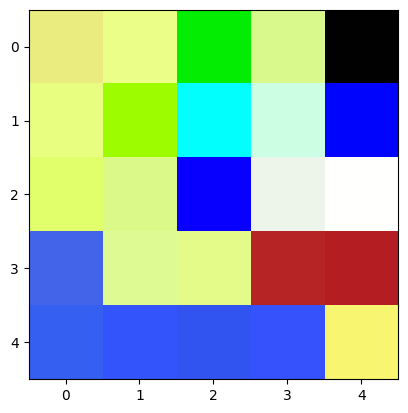

In [34]:
import numpy as np
import matplotlib.pyplot as plt
a = '''234
236
127
235
254
136
3
237
2
218
249
140
0
1
0
232
254
129
158
252
0
0
255
253
203
254
227
1
4
252
225
254
107
219
249
136
7
0
254
237
245
234
255
255
253
67
100
233
222
250
147
229
251
137
183
36
37
180
30
35
53
95
240
52
84
251
49
84
240
53
82
252
248
245
112'''.split("\n")
a = np.array(a)
plt.imshow(a.astype(int).reshape(5, 5, 3))

1/1 [==============================] - 0s 67ms/step


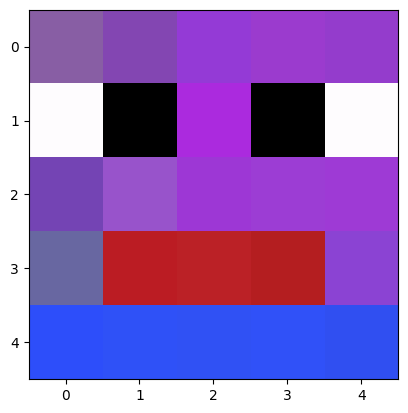

In [35]:
# Change to tf lite with smaller size of weights
import tensorflow as tf
new_model = tf.keras.models.load_model('output/generator_model_28000.h5')

from numpy.random import randn
import matplotlib.pyplot as plt
d = new_model.predict(randn(1, 16))[0]
plt.imshow(d)